# swave_stereo(v2)
This program reads each mono wav file from the data_path and store the dual channel stereo wav in the stereo_path. Then each stereo wav file is read again and the channels are seperated. Each channel can then be visualized.

# Importing packages

In [47]:
import matplotlib
#matplotlib.use("TkAgg")
from scipy.io import wavfile
from scipy import signal
from scipy.signal import blackman
#from matplotlib import mlab
from matplotlib import pyplot as plt
import numpy as np
#from numpy.lib import stride_tricks
from pylab import *
from struct import pack
#import pywt
from scipy.fftpack import dct
#from struct import pack
import wave
from scipy.io import wavfile
import os
#import glob

import gc
import multiprocessing as mp
import resource 
import csv
import itertools

import pandas as pd
import ipywidgets as widgets

gc.enable()

flag = 0
date = '20201228'
data_path = 'data/'
mono_path = data_path + "wav/"
stereo_path = data_path + "stereo/"

mono_file_path = mono_path + date + "/"
stereo_file_path = stereo_path + date + "/"

sweep_path = data_path + "sweep/"
sweep_time_path = sweep_path + date + "/"

aud_path = data_path + "aud_times/"
aud_time_path = aud_path + date + "/"

visual_path = 'visual/'

#print os.path.splitext("20171025/data/")[0]

In [48]:
from IPython.core.display import display, HTML 
display(HTML("<style>.container { width:75% !important; }</style>"))

%config IPCompleter.greedy=True

# Checking memory usage

In [49]:
def mem():
    print('Memory usage  : %2.2f MB' %round(resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0,1))

# Converting data to stereo

In [50]:
filename

'20201223_165507_299.wav'

In [51]:
if not os.path.exists(stereo_file_path):
    os.mkdir(stereo_file_path,0o777)

for filename in os.listdir(mono_file_path):
    print (filename)
    samplerate, data = wavfile.read(mono_file_path + filename)
    rate = samplerate
    samples = len(data) 
    
    data_l = data.reshape(int(samples/2),2)[::2]
    data_r = data.reshape(int(samples/2),2)[1::2]
    
    wv = wave.open(stereo_file_path + filename,'w')
    wv.setparams((2, 2, rate, 0, 'NONE', 'Uncompressed'))
    
    wvData = np.hstack((data_l.reshape(-1, 1), data_r.reshape(-1,1)))
    
    wv.writeframes(wvData)
    wv.close()
    gc.collect()
    
print ('All wav files have been converted to dual channel stereo')

20201228_145338_425.wav
20201228_144134_964.wav
20201228_144533_535.wav
20201228_144009_806.wav
20201228_145148_817.wav
20201228_145226_717.wav
20201228_144616_280.wav
20201228_145306_538.wav
20201228_144102_041.wav
20201228_143937_842.wav
20201228_144648_249.wav
20201228_144604_708.wav
20201228_143801_957.wav
20201228_145258_597.wav
20201228_142715_919.wav
20201228_144457_384.wav
20201228_143835_525.wav
20201228_144529_196.wav
20201228_142753_752.wav
20201228_145221_432.wav
All wav files have been converted to dual channel stereo


plt.plot(data_l,data_r)
plt.show()

# Read capture times

In [52]:
sessions = []
f = open(data_path + "capture_time.txt")
for rows in f.read().splitlines():
    sessions.append(rows.split('-'))
    
f.close()

# Select the desired session for analysis

In [75]:
session_list = []
line_no = 0
for row in sessions:
    if row[0] != '' and row[1] != '':
        starttime = datetime.datetime.strptime(row[0],'%Y/%m/%d %H:%M:%S.%f')
        endtime = datetime.datetime.strptime(row[1],'%Y/%m/%d %H:%M:%S.%f')
    #print starttime
    if starttime.date() == datetime.datetime.strptime(date,'%Y%m%d').date() : #Check if sessions available which matches the experiment date
        line_no = line_no + 1
        print ("(", line_no, ")", "\t", starttime, "-", endtime)
        #session_list.append(row[0] + "-" + row[1])
        session_list.append([starttime,endtime])
        
#print ("Plese register", str(ex[0]))
print ("Please input the session numbers. Separate them with commas. Confirm the start and end times using the experiment note.")
session = input("Session ") 
print ("You have chosen the sessions ", session)
#session = list(map(int, session))
#selected_session = session_list[int(session)-1]

Please input the session numbers. Separate them with commas. Confirm the start and end times using the experiment note.
Session 
You have chosen the sessions  


In [20]:
session = range(5,31)

In [35]:
session

'1'

In [22]:
session = [14,15,16,17,18,19,20,21,22,24,26,27,29,30,31]

In [36]:
session = session.split(",")

In [37]:
session = list(map(int,session))

In [38]:
#session = range(28, 51)

In [39]:
session

[1]

In [40]:
selected_session =[]
for s in session:
    selected_session.append(session_list[s-1])

In [129]:
selected_session

[[datetime.datetime(2020, 12, 23, 16, 13, 52, 184000),
  datetime.datetime(2020, 12, 23, 16, 14, 24, 984000)]]

In [130]:
selected_session = [[datetime.datetime(2020, 12, 28, 14, 40, 1, 998000),
  datetime.datetime(2020, 12, 28, 14, 41, 2, 806000)]]

# Make a list of wav files in the selected session

In [69]:
def wav_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(stereo_file_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S_%f')
            if filetime >= s[0]-datetime.timedelta(seconds=0.1) and filetime <= s[1]+datetime.timedelta(seconds=0.1):
                file_list.append(filename)
    return file_list

In [70]:
wav_filelist = wav_list_maker()

In [79]:
wav_filelist = ['20201228_144009_806.wav','20201228_144102_041.wav']

In [80]:
wav_filelist

['20201228_144009_806.wav', '20201228_144102_041.wav']

In [81]:
selected_session

[[datetime.datetime(2020, 12, 23, 16, 13, 52, 184000),
  datetime.datetime(2020, 12, 23, 16, 14, 24, 984000)]]

# Make a list of wave wave timestamp files in the selected session

In [82]:
def sweep_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(sweep_time_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S')
            if filetime >= s[0] and filetime <= s[1]:
                file_list.append(filename)
    return file_list

In [83]:
sweep_filelist = sweep_list_maker()

In [88]:
sweep_filelist = ['20201228_144104.csv']

In [86]:
selected_session

[[datetime.datetime(2020, 12, 23, 16, 13, 52, 184000),
  datetime.datetime(2020, 12, 23, 16, 14, 24, 984000)]]

# Make a list of audio start-end timestamp files in the selected session

In [87]:
def aud_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(aud_time_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S')
            #print(filetime)
            if filetime >= s[0].replace(microsecond=0) and filetime <= s[1].replace(microsecond=0):
                file_list.append(filename)
    return file_list

In [36]:
aud_filelist = aud_list_maker()

In [37]:
selected_session

[[datetime.datetime(2021, 9, 17, 13, 49, 2, 1000),
  datetime.datetime(2021, 9, 17, 13, 49, 12, 378000)]]

In [89]:
aud_filelist = ['20201228_144102.csv']

# Visualizing spectrogram

for audio_file in wav_filelist:#os.listdir(stereo_file_path):
    #audio_file = "20200910_142646_042.wav"
    print(audio_file)
    #samplerate, data = wavfile.read('20171025/data/' + filename)
    audio_name = os.path.splitext(audio_file)[0]
    
#     for pic_file in os.listdir(visual_path):
#         pic_name = os.path.splitext(pic_file)[0]
#         if pic_mame == audio_name: #data file has already been visualized
#             flag = 1

    if flag == 0:        
        samplerate, data = wavfile.read(stereo_file_path + audio_file)
        
        data_left = data[:, 0]
        data_right = data[:, 1]
        
        #data_left = np.append(data_left[0],data_left[1:] - 0.97*data_left[:-1])
        
        #data_left = np.square(data_left)
        #data_right = np.square(data_right)

        
        #data = np.subtract(data_left,data_right)
        
        #data1 = np.absolute(data)
        
        #data2 = np.sqrt(data1)
        
        times = np.arange(len(data))/float(samplerate)

        plt.close("all")

        Fs = samplerate#44100#5000*2.#10000.
        NFFT = 256#512#22050#min(4096, len(data))#32768
        noverlap = NFFT/2#NFFT /2 #fft size
        pad_to = NFFT * 16
        dynamicRange = 30#30 #change this to change the color scale. 
        vmin = 20*np.log10(np.max(data)) - dynamicRange

        #window=blackman(NFFT)
        #window=signal.nuttall(NFFT)
        #window=np.hamming(NFFT)
        window = np.hanning(NFFT)

        cmap = plt.get_cmap('magma')
        
        vmin = data_right.min()
        vmax = data_right.max()
        
        #t = np.linspace(0, 0.1, 9600)
        #generated_sweep = chirp(t=t, f0=18000, t1=1, f1=22000, method='linear')  
        
        #t = np.linspace(0, 1, 44100)
        #generated_sweep = chirp(t=t, f0=18000, t1=1, f1=20000, method='linear')
        
        Pxx, freqs, times, cax = plt.specgram(generated_sweep, NFFT=NFFT, vmin=-50,vmax=0,window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)
     
        #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
        #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
        #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
        #print Pxx
        #f, t, Sxx = signal.spectrogram(data_right, Fs)

        #print type(Pxx)

        axes_spec = plt.gca()
        #axes_spec.set_xlim([0., 30])
        #axes_spec.set_xlim([9.9,10.5])
        axes_spec.set_ylim([15000, 24000])

        plt.xlabel("Time (s)")
        plt.ylabel("Frequency (Hz)")

        #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
        #plt.show()
        
        plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

        plt.tight_layout()
        #savefig('20171030/visual/' + filename + '.png')
        print ("File" + audio_file  + " is visualized!")
        
        
        gc.collect()
       
        
        plt.show()
        #plt.show()


    else:
        print ("File " + filename  + " has already been visualized. Delete the image from the visual folder and try again.")
        flag = 0
        
    break

In [90]:
f1 = 18000        # start frequency
f2 = 21000       # end frequency
fs = 48000#96000      # sampling frequency
T = 0.1          # time duration of the sweep
t = float(9600)/samplerate

a = (f2 - f1)/float(T)

t = np.arange(0,np.round(fs*T-1)/fs,1/fs)  # time axis
s = np.sin(2*np.pi*((a*t**2)/2 + (f1*t)))
#s = np.sin(2*np.pi*f1*np.exp(t)) 

In [91]:
s

array([ 0.        ,  0.70707786, -0.99999999, ...,  0.99999979,
       -0.92402036,  0.70722247])

len(generated_sweep)

In [92]:
samplerate

192000

# Visualize FFT spectrogram

In [93]:
def visualize_fft(data):
    times = np.arange(len(data))/float(samplerate)

    plt.close("all")

    Fs = 44100#5000*2.#10000.
    NFFT = 512#22050#min(4096, len(data))#32768
    noverlap = NFFT/2#NFFT /2 #fft size
    pad_to = NFFT * 16
    dynamicRange = 30#30 #change this to change the color scale. 
    vmin = 20*np.log10(np.max(data)) - dynamicRange

    #window=blackman(NFFT)
    #window=signal.nuttall(NFFT)
    #window=np.hamming(NFFT)
    window = np.hanning(NFFT)

    cmap = plt.get_cmap('magma')

    vmin = data_right.min()
    vmax = data_right.max()

    Pxx, freqs, times, cax = plt.specgram(data, NFFT=NFFT, vmin=-50, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)

    #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
    #print Pxx
    #f, t, Sxx = signal.spectrogram(data_right, Fs)

    #print type(Pxx)

    axes_spec = plt.gca()
    #axes_spec.set_xlim([0., 30])
    #axes_spec.set_xlim([9.9,10.5])
    axes_spec.set_ylim([16500, 22500])

    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
    #plt.show()

    plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

    plt.tight_layout()

# Calculate MFCC

In [94]:
def calc_mfcc(sample_rate,signal): 
    ##Pre-emphasis##
    pre_emphasis = 0.97
    emphasized_signal = np.append(signal[0], signal[1:] - pre_emphasis * signal[:-1])



    ##Framing##
    frame_size = 0.001#0.01#0.01#0.025#
    frame_stride = 0.001#0.00155#0.00144#overlapping=frame_size-frame_stride
    #overlapping=float(frame_size-frame_stride)/frame_size
    frame_length, frame_step = frame_size * sample_rate, frame_stride * sample_rate
    signal_length = len(emphasized_signal)
    frame_length = int(round(frame_length))
    frame_step = int(round(frame_step))
    num_frames = int(np.ceil(float(np.abs(signal_length - frame_length)) / frame_step))
    #print "num_frames=",num_frames
    pad_signal_length = num_frames * frame_step + frame_length
    z = np.zeros((pad_signal_length - signal_length))
    pad_signal = np.append(emphasized_signal, z)
    indices = np.tile(np.arange(0, frame_length), (num_frames, 1)) + np.tile(np.arange(0, num_frames * frame_step, frame_step), (frame_length, 1)).T
    frames = pad_signal[indices.astype(np.int32, copy=False)]



    ##Window##
    frames *= np.hamming(frame_length)
    #frames *= blackman(frame_length)



    ##Fourier-transform and power spectrum##
    NFFT = 1024
    mag_frames = np.absolute(np.fft.rfft(frames, NFFT)) #magnitude of the FFT
    pow_frames = ((1.0 / NFFT) * ((mag_frames) ** 2)) #power spectrum
    pow_frames_new = pow_frames[:,400:500]
    #print "pow_frames=",len(pow_frames)
    #print "pow_frames=",pow_frames.shape
    #print "pow_frames=",type(pow_frames)



    ##Filter banks##
    nfilt = 40
    low_freq_mel = (2595 * np.log10(1 + (18000) / 700)) #thilina was 18000 instead of 20
    high_freq_mel = (2595 * np.log10(1 + (sample_rate / 2) / 700)) #thilina was sample_rate/2#convert Hz to Mel
    
    mel_points = np.linspace(low_freq_mel, high_freq_mel, nfilt + 2) #equally spaced in Mel scale
    hz_points = (700 * (10**(mel_points / 2595) - 1)) #converts Mel to Hz
    bin = np.floor((NFFT +1) * hz_points / sample_rate)
    #print "hz_points=",hz_points
    fbank = np.zeros((nfilt, int(np.floor(NFFT / 2 +1))))
    #fbank = np.zeros((nfilt,100))
    #print "fbank=",fbank.shape
    for m in range(1, nfilt + 1):
        f_m_minus = int(bin[m - 1]) #left
        f_m = int(bin[m]) #center
        f_m_plus = int(bin[m + 1]) #right

        for k in range(f_m_minus, f_m):
            fbank[m - 1, k] = (k - bin[m - 1]) / (bin[m] - bin[m - 1])
        for k in range(f_m, f_m_plus):
            fbank[m - 1, k] = (bin[m + 1] - k) / (bin[m + 1] - bin[m])
    #print "fbank=",fbank.shape
    filter_banks = np.dot(pow_frames, fbank.T)
    #fbank_new = fbank[:,0:100]
    #filter_banks = np.dot(pow_frames_new, fbank_new.T)
    filter_banks = np.where(filter_banks == 0, np.finfo(float).eps, filter_banks) #numerical stability
    filter_banks = 20 * np.log10(filter_banks) #dB



    ##Mel-Frequency Cepstral Coefficients (MFCCs)##
    num_ceps = 12
    mfcc = dct(filter_banks, type=2, axis=1, norm='ortho')[:, 1 : (num_ceps + 1)] #keep 2-13
    cep_lifter = 22
    (nframes, ncoeff) = mfcc.shape
    n = np.arange(ncoeff)
    lift = 1 + (cep_lifter / 2) * np.sin(np.pi * n / cep_lifter)
    mfcc *= lift



    ##Mean normalization##
    filter_banks -= (np.mean(filter_banks, axis=0) + 1e-8)
    mfcc -= (np.mean(mfcc, axis=0) + 1e-8)
    
    return mfcc#,mag_frames,pow_frames,filter_banks

#def mfcc(cut):
#    feat_list = []
#    mfcc_list = []
#    for cuts in cut:
#        mfcc,mag_frames,pow_frames,filter_banks = calc_mfcc(44100,cuts)
#        mfcc_list.append(mfcc)
#        feat_list.append(mfcc.T.mean(axis=0))
#    return mfcc_list

# Normalize data

In [95]:
def normalize_data(data):
    norm_data = data/np.max(data)
    return norm_data

# Read sweep timestamps

In [96]:
sweep_timestamps = []
for sweep_time_file in sweep_filelist:#os.listdir(sweep_time_path):
    print(sweep_time_file)
    with open(sweep_time_path + "/" + sweep_time_file) as csvfile: #read session data from capture_time.csv
        readCSV = csv.reader(csvfile, delimiter=',')
        line_no = 0
        #print "The data sessions taken during the start and end dates"
        for row in readCSV:
            sweep_timestamps.append(row)
            
sweep_timestamps = list(itertools.chain(*sweep_timestamps)) #These are sweep start times
sweep_timestamps = [datetime.datetime.strptime(stmp, '%Y%m%d_%H:%M:%S.%f') for stmp in sweep_timestamps]

20201228_144104.csv


In [97]:
sweep_filelist

['20201228_144104.csv']

In [98]:
sweep_timestamps

[datetime.datetime(2020, 12, 28, 14, 41, 4, 766000),
 datetime.datetime(2020, 12, 28, 14, 41, 5, 280000),
 datetime.datetime(2020, 12, 28, 14, 41, 5, 790000),
 datetime.datetime(2020, 12, 28, 14, 41, 6, 306000),
 datetime.datetime(2020, 12, 28, 14, 41, 6, 814000),
 datetime.datetime(2020, 12, 28, 14, 41, 7, 327000),
 datetime.datetime(2020, 12, 28, 14, 41, 7, 841000),
 datetime.datetime(2020, 12, 28, 14, 41, 8, 351000),
 datetime.datetime(2020, 12, 28, 14, 41, 8, 866000),
 datetime.datetime(2020, 12, 28, 14, 41, 9, 381000),
 datetime.datetime(2020, 12, 28, 14, 41, 9, 890000),
 datetime.datetime(2020, 12, 28, 14, 41, 10, 403000),
 datetime.datetime(2020, 12, 28, 14, 41, 10, 912000),
 datetime.datetime(2020, 12, 28, 14, 41, 11, 425000),
 datetime.datetime(2020, 12, 28, 14, 41, 11, 936000),
 datetime.datetime(2020, 12, 28, 14, 41, 12, 447000),
 datetime.datetime(2020, 12, 28, 14, 41, 12, 965000),
 datetime.datetime(2020, 12, 28, 14, 41, 13, 477000),
 datetime.datetime(2020, 12, 28, 14, 41

# Read audio start/end timestamps

In [99]:
aud_timestamps = []
for aud_time_file in aud_filelist:#os.listdir(sweep_time_path):
    print(sweep_time_file)
    with open(aud_time_path + "/" + aud_time_file) as csvfile: #read session data from capture_time.csv
        readCSV = csv.reader(csvfile, delimiter=',')
        line_no = 0
        #print "The data sessions taken during the start and end dates"
        for row in readCSV:
            aud_timestamps.append(row)
            
aud_timestamps = list(itertools.chain(*aud_timestamps)) #These are sweep start times

20201228_144104.csv


In [100]:
aud_timestamps

['20201228_14:41:02.03-20201228_14:41:34.997']

# Read the data from the audio file/files and normalize them

In [101]:
for audio_file in wav_filelist:#os.listdir(stereo_file_path):
    #audio_file = "20200910_142646_042.wav"
    print(audio_file)
    #samplerate, data = wavfile.read('20171025/data/' + filename)
    audio_name = os.path.splitext(audio_file)[0]
    
     
    samplerate, data = wavfile.read(stereo_file_path + audio_file)

    data_left = data[:, 0]
    data_right = data[:, 1]

    #data_left = np.append(data_left[0],data_left[1:] - 0.97*data_left[:-1])
    #data_right = np.append(data_right[0],data_right[1:] - 0.97*data_right[:-1])
    #data_left = np.square(data_left)
    #data_right = np.square(data_right)


    #data = np.subtract(data_left,data_right)

    #data1 = np.absolute(data)

    #data2 = np.sqrt(data1)
    #data_left = filter_signal(data_left)
    #data_right = filter_signal(data_right)
    break

20201228_144009_806.wav


# Calculate audio start/end times

In [102]:
def calc_start_end(aud_t):
    #for aud_t in aud_timestamps:
    audio_start = aud_t.split('-')[0]
    audio_end = aud_t.split('-')[1]

    audio_start = datetime.datetime.strptime(audio_start, '%Y%m%d_%H:%M:%S.%f')
    audio_end = datetime.datetime.strptime(audio_end, '%Y%m%d_%H:%M:%S.%f')
    return audio_start, audio_end

In [103]:
aud_timestamps

['20201228_14:41:02.03-20201228_14:41:34.997']

# Remove sweep timestamps outside audio start/end timestamps

In [104]:
def clear_sweep_timestamps(sweep_timestamps):
    swp = []
    for t in sweep_timestamps:
        print(t)
        if t < audio_endtime:
            swp.append(t)
    return swp

# Generate sweep signal

In [105]:
from scipy.signal import chirp

def generate_sweep():
#     if samplerate == 96000:
#         t = np.linspace(0, 0.1, 9600)
#     if samplerate == 48000:
#         t = np.linspace(0, 1, 4800)    
#     if samplerate == 44100:
#         t = np.linspace(0, 1, 4410)
        
#     #t = np.linspace(0, 1, 9600)
#     generated_sweep = chirp(t=t, f0=18000, t1=1, f1=21000, method='linear')   
    x = 0
    if samplerate == 96000:
        x = 9600
    if samplerate == 192000:
        x = 19200
    
    
    f1 = 18000        # start frequency
    f2 = 21000       # end frequency
    fs = samplerate#96000      # sampling frequency
    T = 0.1          # time duration of the sweep
    t = float(x)/samplerate

    a = (f2 - f1)/float(T)

    t = np.arange(0,np.round(fs*T-1)/fs,1/fs)  # time axis
    sweep = np.sin(2*np.pi*((a*t**2)/2 + (f1*t)))
    #s = np.sin(2*np.pi*f1*np.exp(t)) 
    return sweep

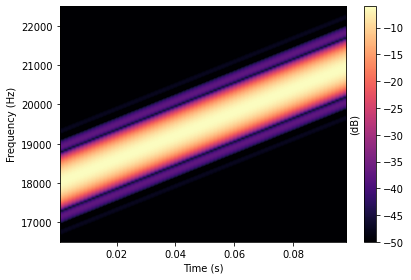

In [106]:
visualize_fft(generate_sweep())

# Generate sweep signal

generated_sweep = generate_sweep()

# Bandpass filter

In [107]:
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def filter_signal(sweep_signal):
    #filtered_sweep_signals = []
    #print sweep_signals
    #for sig in sweep_signals:
    filtered_sweep_signals = butter_bandpass_filter(sweep_signal,17000,22000,samplerate)
    return filtered_sweep_signals

# Convolution

In [108]:
def convolution(data,generated_sweep):
    conv = []
    
    conv = scipy.signal.fftconvolve(data, generated_sweep[::-1])#thilina comment- changed from generated_sweep[::-1] to generated_sweep[::-1]*itr.max()

    #cut = []
    #max_cor_pos = []

    #for i in range(0,len(conv)):
    #    cut.append(conv[i][conv[i].argmax()-2000:conv[i].argmax()+2000])
        
    return conv

# Envelop calculation

In [109]:
def get_envelop(inputSignal):
    
    # Taking the absolute value
    
    absoluteSignal = []
    for sample in inputSignal:
        absoluteSignal.append (abs (sample))
    
    # Peak detection
    
    intervalLength = 40 # Experiment with this number, it depends on your sample frequency and highest "whistle" frequency
    outputSignal = []
    
    for baseIndex in range (intervalLength, len (absoluteSignal)):
        maximum = 0
        for lookbackIndex in range (intervalLength):
            maximum = max (absoluteSignal [baseIndex - lookbackIndex], maximum)
        outputSignal.append (maximum)
    
    return outputSignal

In [110]:
from scipy.signal import hilbert
def calc_envelop(cut):
    analytic_signal = hilbert(cut)
    amplitude_envelop = np.abs(analytic_signal)
    return amplitude_envelop

In [111]:
def make_folder_structure():
    if not os.path.exists("processed/" + "/ir"):
        os.mkdir("processed/" + "/ir",0o777)

    if not os.path.exists("processed/" + "/ir/" + date):
        os.mkdir("processed/" + "/ir/" + date,0o777)
        
    if not os.path.exists("processed/" + "/ir/" + date + "/left"):
        os.mkdir("processed/" + "/ir/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "/ir/" + date + "/right"):
        os.mkdir("processed/" + "/ir/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "/ir_raw"):
        os.mkdir("processed/" + "/ir_raw",0o777)

    if not os.path.exists("processed/" + "/ir_raw/" + date):
        os.mkdir("processed/" + "/ir_raw/" + date,0o777)
        
    if not os.path.exists("processed/" + "/ir_raw/" + date + "/left"):
        os.mkdir("processed/" + "/ir_raw/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "/ir_raw/" + date + "/right"):
        os.mkdir("processed/" + "/ir_raw/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "mfccs/"):
        os.mkdir("processed/" + "mfccs/",0o777)
        
    if not os.path.exists("processed/" + "spectra/"):
        os.mkdir("processed/" + "spectra/",0o777)
        
    if not os.path.exists("processed/" + "mfccs/" + date):
        os.mkdir("processed/" + "mfccs/" + date,0o777)
        
    if not os.path.exists("processed/" + "spectra/" + date):
        os.mkdir("processed/" + "spectra/" + date,0o777)
        
    if not os.path.exists("processed/" + "mfccs/" + date + "/left"):
        os.mkdir("processed/" + "mfccs/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "mfccs/" + date + "/right"):
        os.mkdir("processed/" + "mfccs/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "spectra/" + date + "/left"):
        os.mkdir("processed/" + "spectra/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "spectra/" + date + "/right"):
        os.mkdir("processed/" + "spectra/" + date + "/right",0o777)

In [112]:
def extract_mfcc_feat(imp_res):
    sample_rate = 192000
    lbp_set = pd.DataFrame()
    mfcc_set = pd.DataFrame()
    for index, row in imp_res.iterrows():
        signal = np.array(row)
        #formants = get_formants(signal)
        mfcc = calc_mfcc(sample_rate,signal)
        mfcc_set = pd.concat([mfcc_set,pd.DataFrame(mfcc.flatten()).T],axis=0)
        #lbp = lbp_feat_calc(mfcc)
        #lbp_set = pd.concat([lbp_set,lbp], axis=0)
        #formant_set = pd.concat([formant_set, formants,axis=0])
    #lbp_set.index = imp_res.index
    mfcc_set.index = imp_res.index
    return mfcc_set

In [113]:
def extract_spectral_feat(imp_res):
    spectrum_set = pd.DataFrame()
    for index, row in imp_res.iterrows():
        signal = np.array(row)
        f = calculate_spectrum(signal)
        spectrum_set = pd.concat([spectrum_set, f],axis=0)

    spectrum_set.index = imp_res.index
    return spectrum_set

In [114]:
import pylab as pl

def calculate_spectrum(signal):
    rate = samplerate
    t = np.arange(0, 10, 1/rate)                                           
    x = signal
    p = 20*np.log10(np.abs(np.fft.rfft(x)))
    f = np.linspace(0, rate/2, len(p))
    #print(len(p))
    #print(len(f))
    #print(f)
    #plt.plot(p[500:750])
    spectrum = pd.DataFrame(p)
    spectrum.index = f
    #display(spectrum[18000:21000])
    #spectrum[18000:21000].plot()
    #plot(f[18000:21000], p[18000:21000])
    #plt.show()
    return spectrum[17000:22000].T

from tqdm import tqdm
from pathlib import Path
import gc
gc.enable()
count = 0
for ss in tqdm(selected_session):
    print(ss)
    for audio_file in wav_filelist:
        if datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') >= ss[0] and datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') < ss[1]:
            audio_name = os.path.splitext(audio_file)[0]
            samplerate, data = wavfile.read(stereo_file_path + audio_file)
            data_left = data[:, 0]
            data_right = data[:, 1]
            print(stereo_file_path + audio_file)
            break

In [132]:
audio_start

datetime.datetime(2020, 12, 28, 14, 41, 2, 30000)

In [133]:
ss[0]

datetime.datetime(2020, 12, 28, 14, 40, 1, 998000)

In [134]:
ss[1]

datetime.datetime(2020, 12, 28, 14, 41, 2, 806000)

In [144]:
selected_session

[[datetime.datetime(2020, 12, 28, 14, 40, 0, 994000),
  datetime.datetime(2020, 12, 28, 14, 41, 2, 807000)]]

In [147]:
selected_session = [[datetime.datetime(2020, 12, 28, 14, 40, 0, 994000),
  datetime.datetime(2020, 12, 28, 14, 41, 35, 807000)]]

In [148]:
wav_filelist

['20201228_144009_806.wav', '20201228_144102_041.wav']

In [157]:
envelop

array([27912977.68039499, 27039796.53907057, 25552596.44640713, ...,
        4940118.09111681,  3022509.10050729, 15893307.91304328])







  0%|          | 0/1 [00:00<?, ?it/s]

Calculating impulse responses from audio file 20201228_144102_041.wav
check
	 Calculating the impulse responses of the left stream
525312


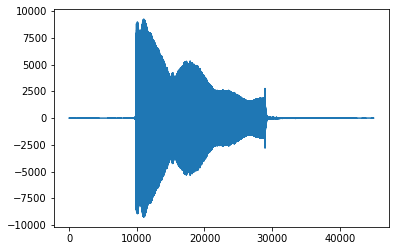

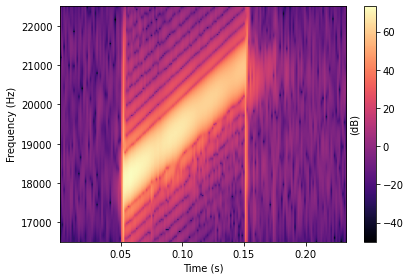

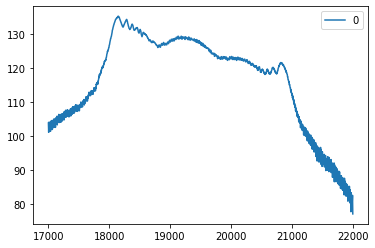

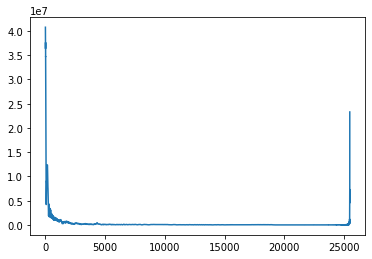

624000


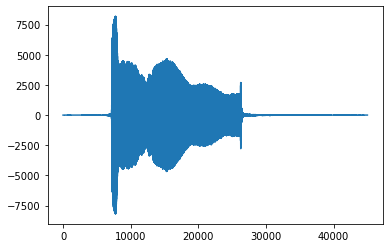

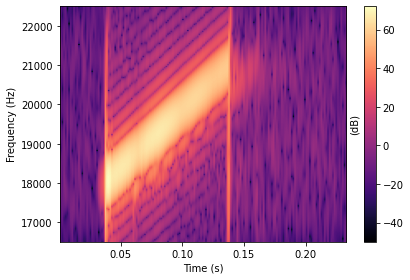

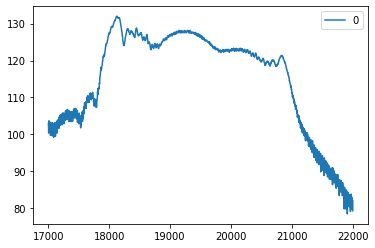

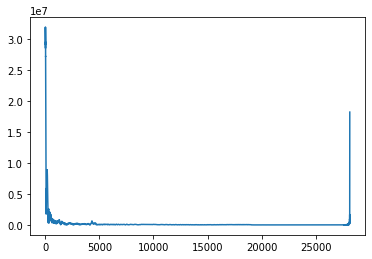

721920


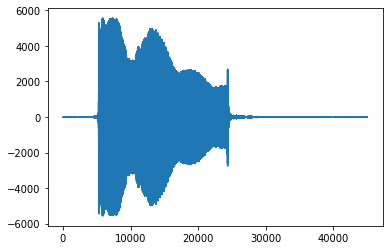

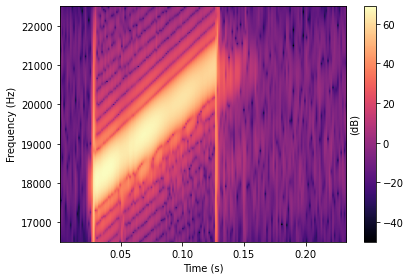

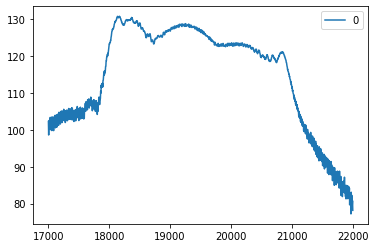

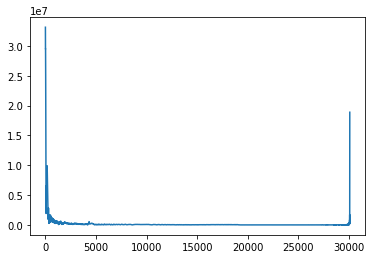

820992


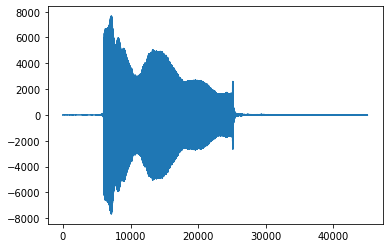

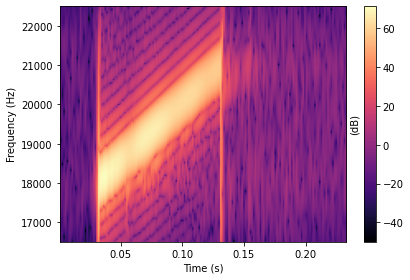

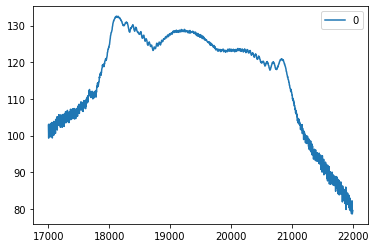

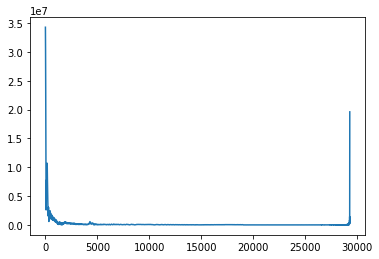

918528


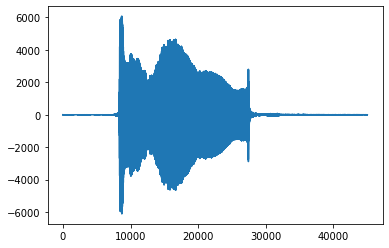

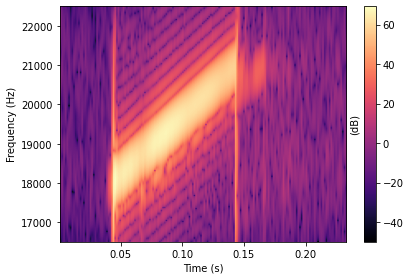

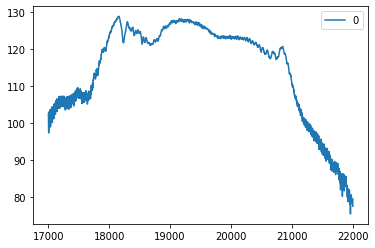

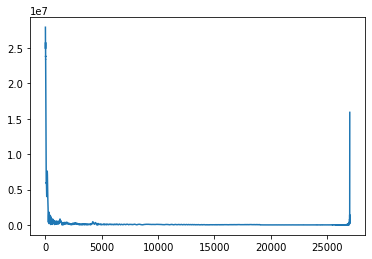

1017024


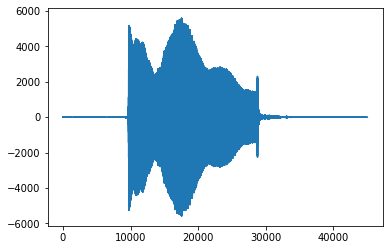

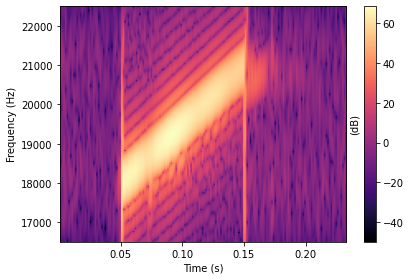

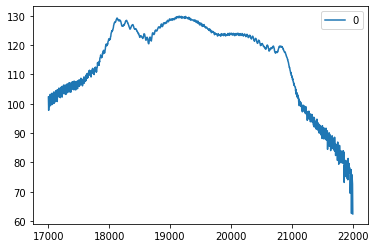

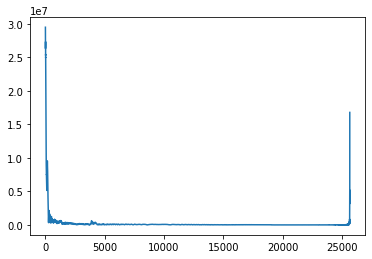

1115712


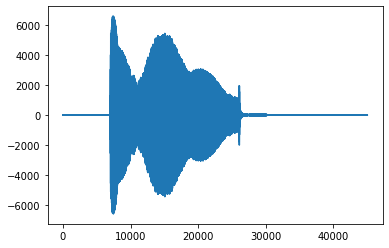

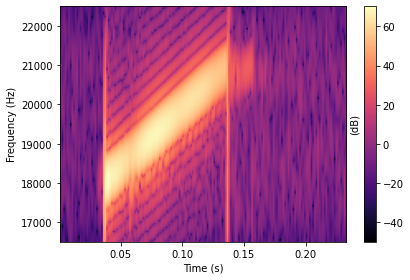

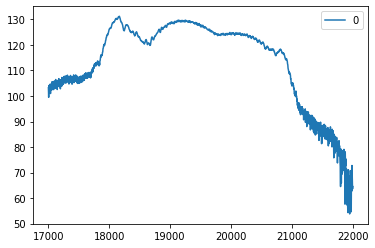

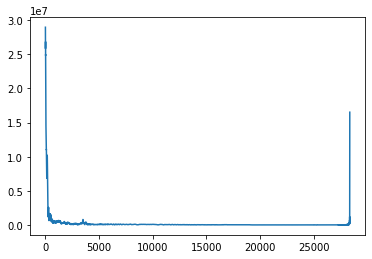

1213632


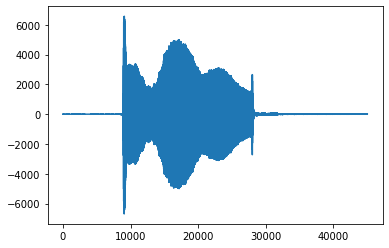

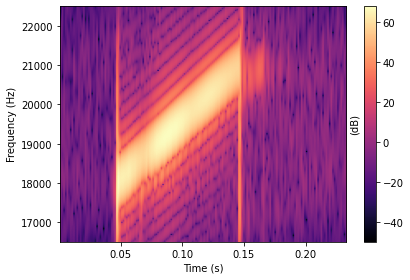

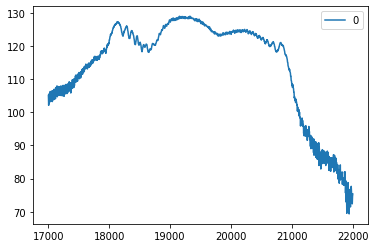

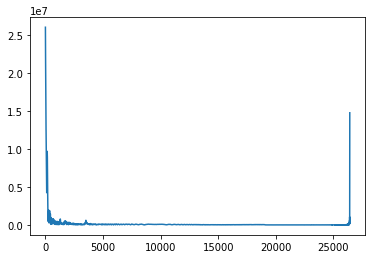

1312512


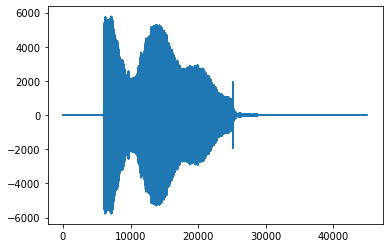

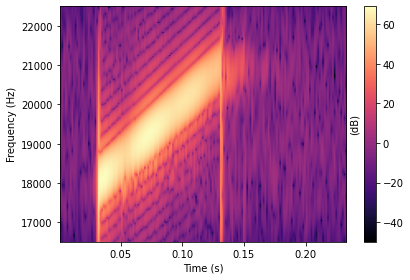

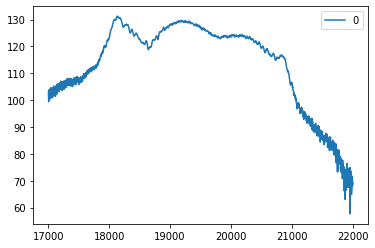

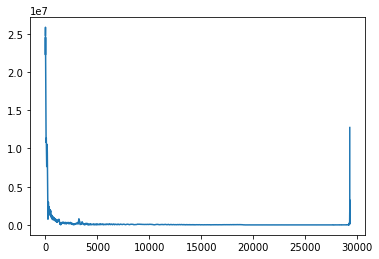

1411392


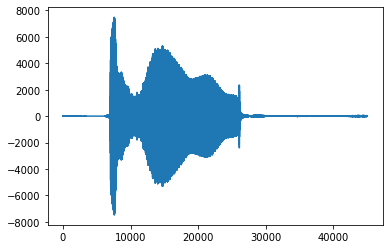

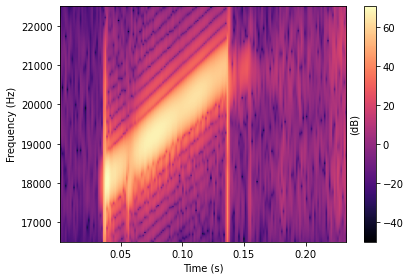

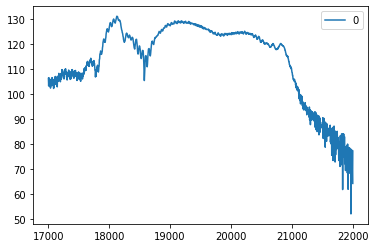

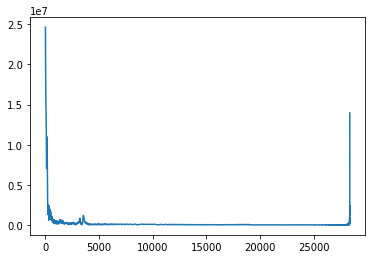

1509120


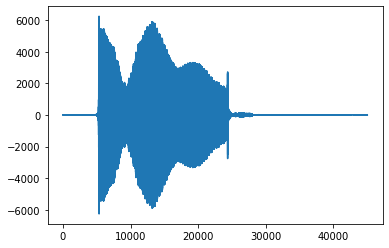

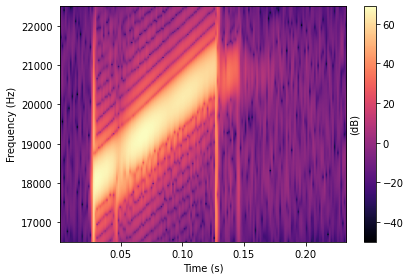

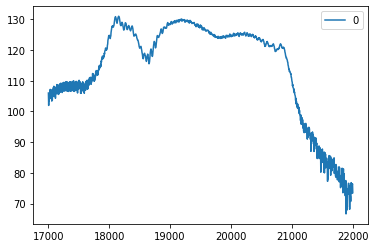

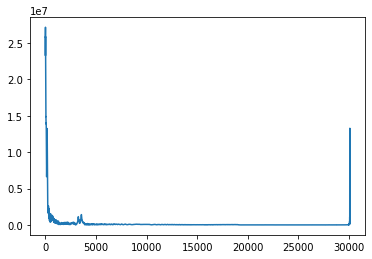

1607615


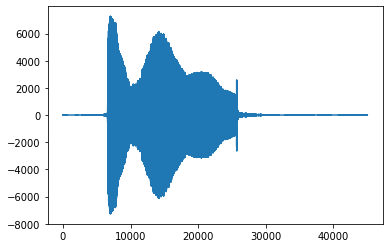

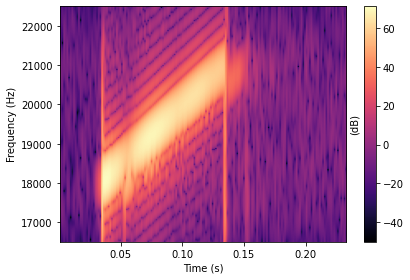

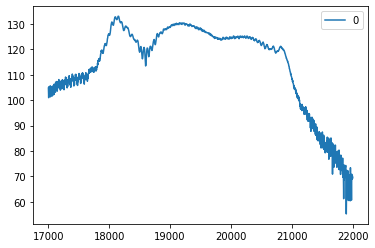

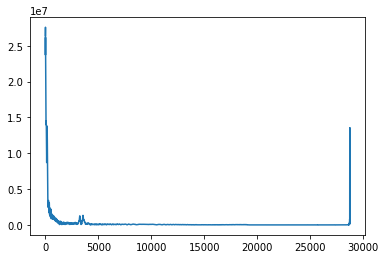

1705344


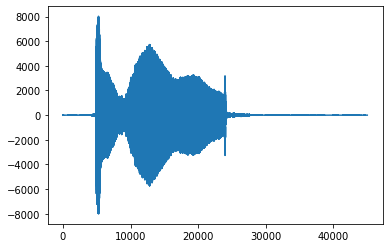

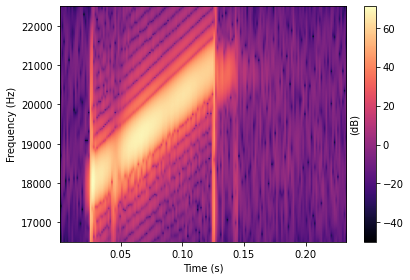

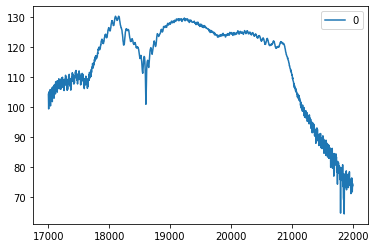

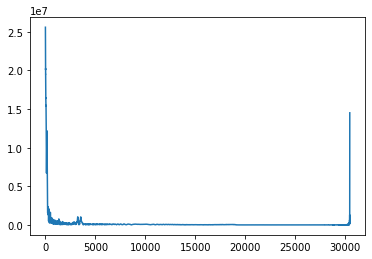

1803840


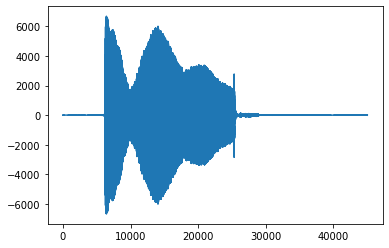

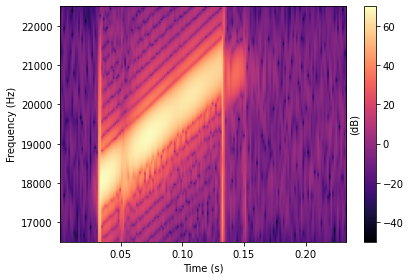

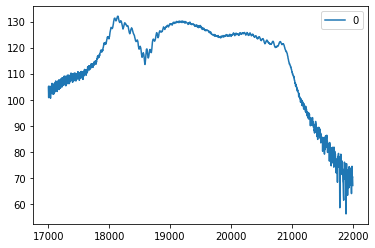

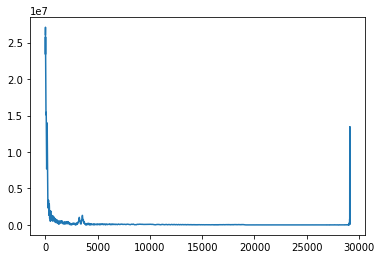

1901952


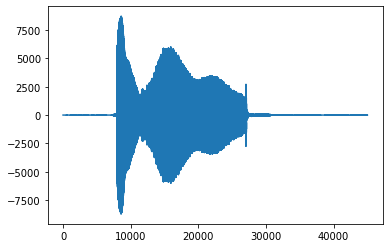

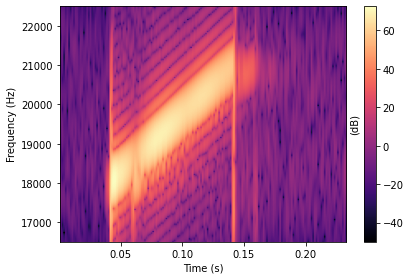

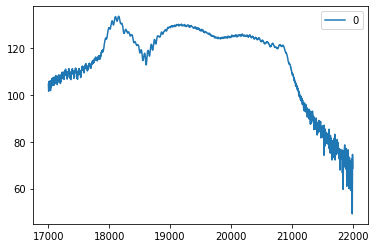

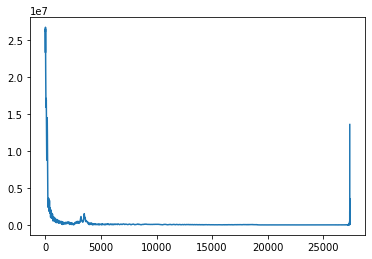

2000064


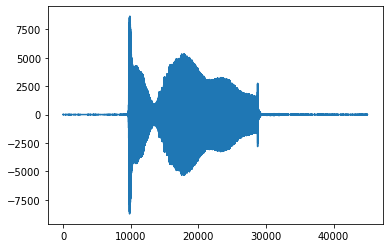

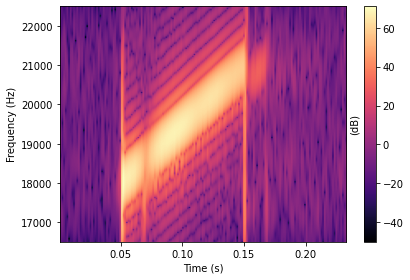

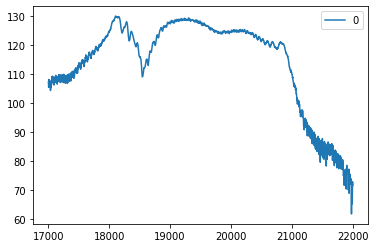

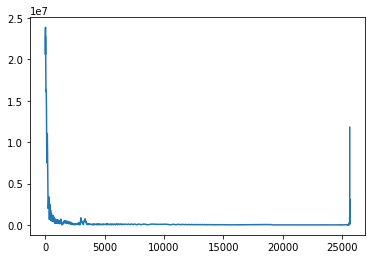

2099520


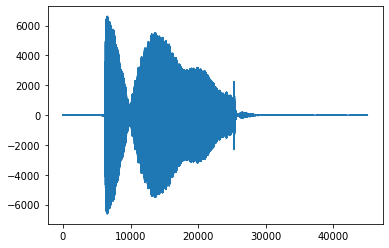

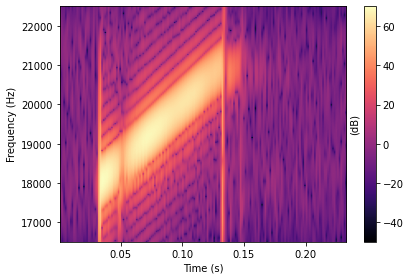

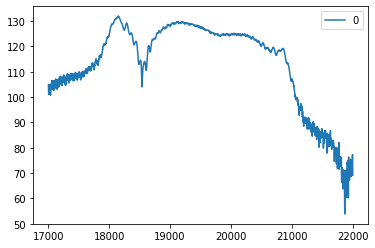

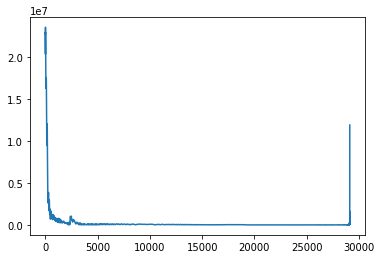

2197824


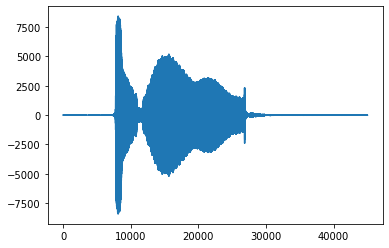

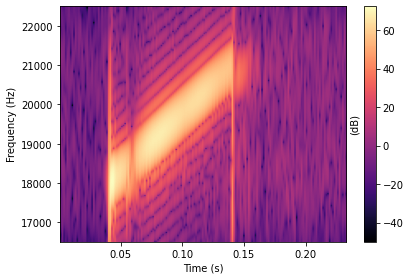

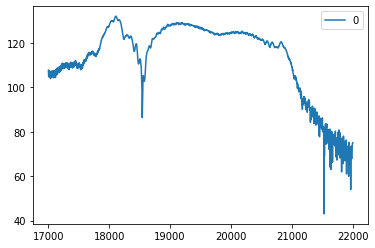

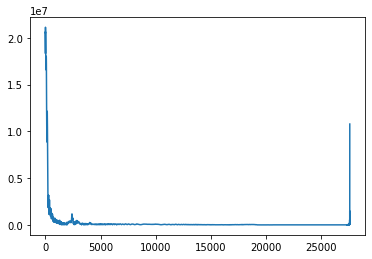

2295744


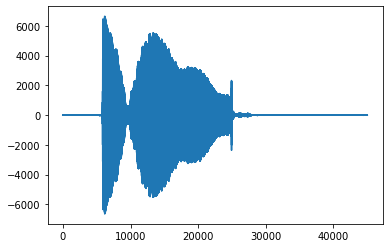

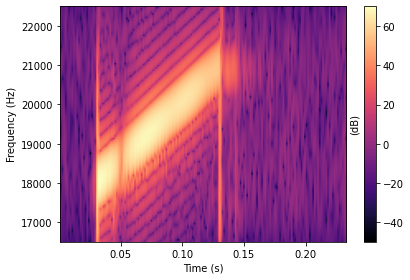

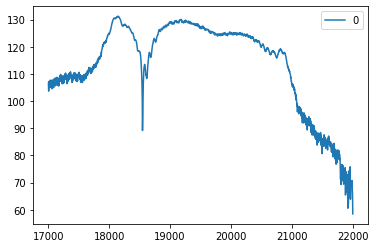

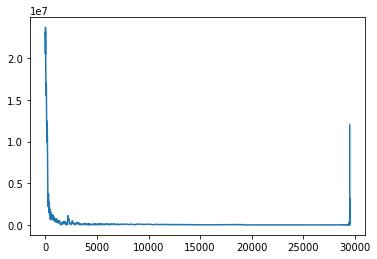

2393856


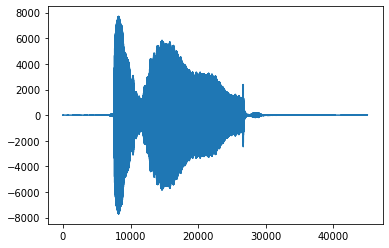

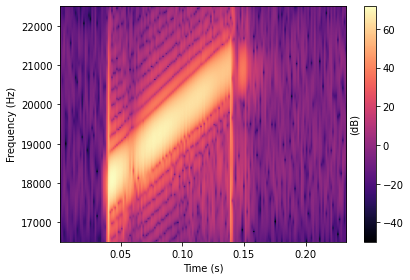

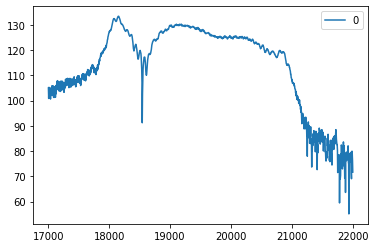

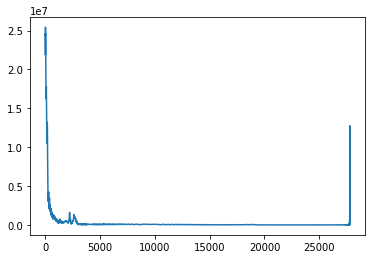

2491776


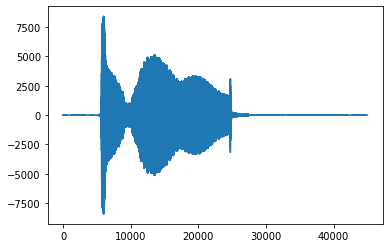

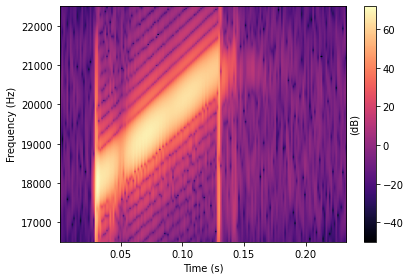

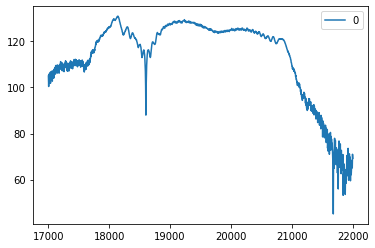

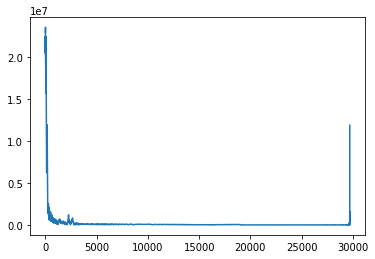

2590464


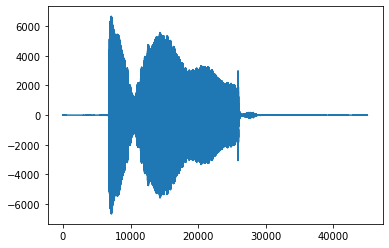

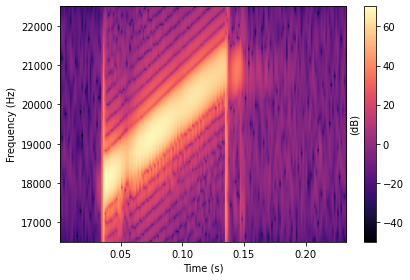

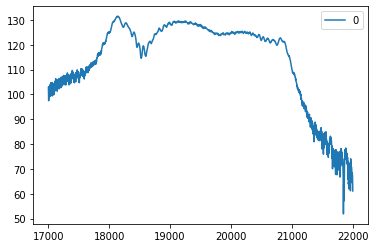

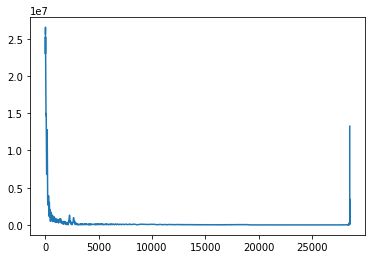

2688000


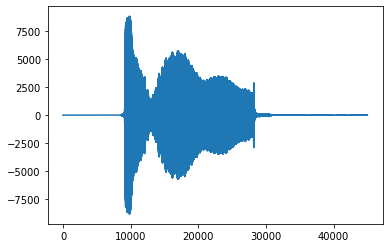

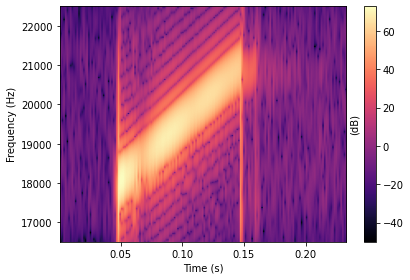

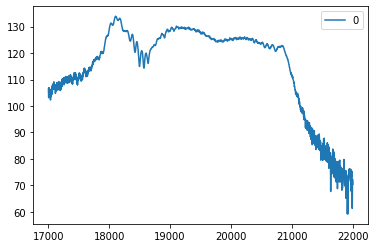

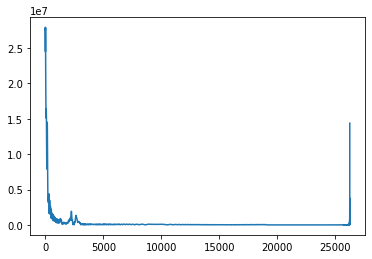

2785920


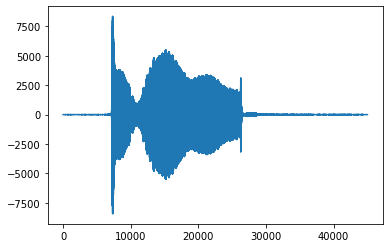

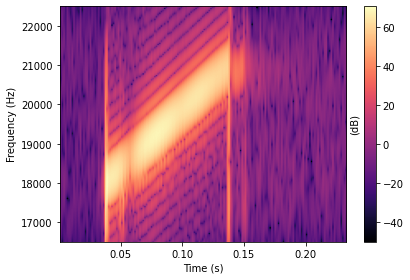

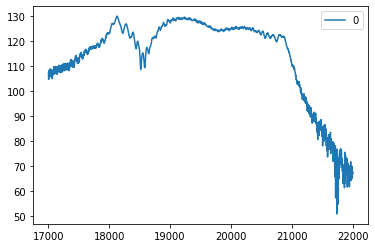

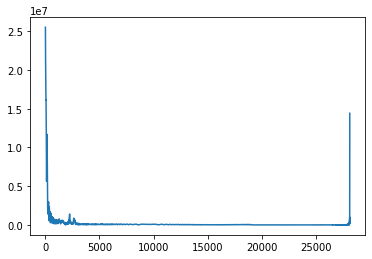

2883840


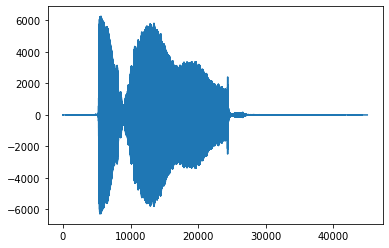

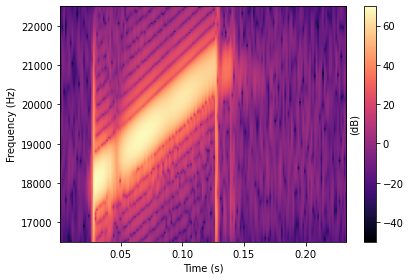

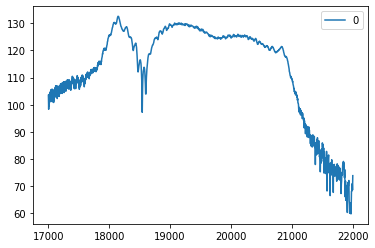

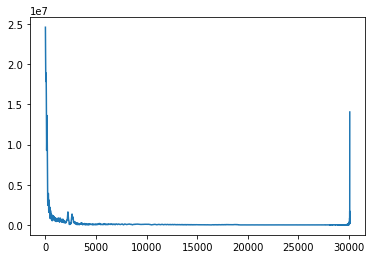

2981952


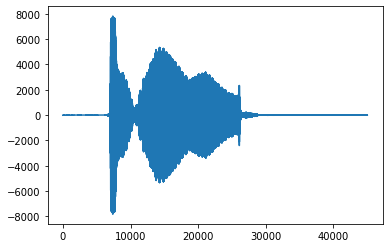

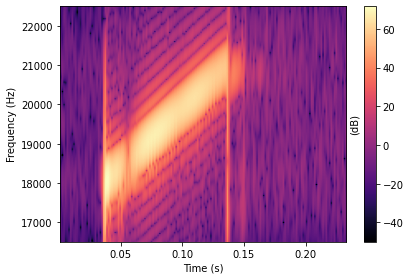

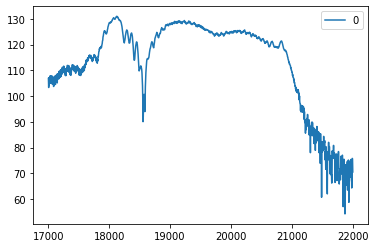

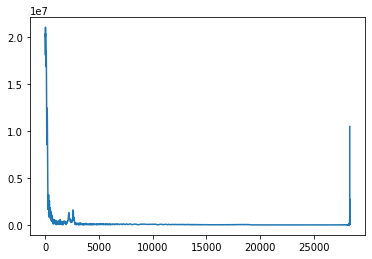

3081600


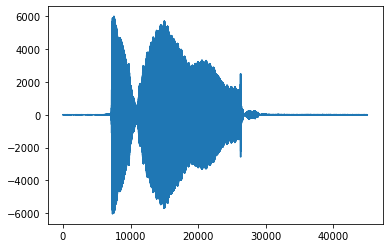

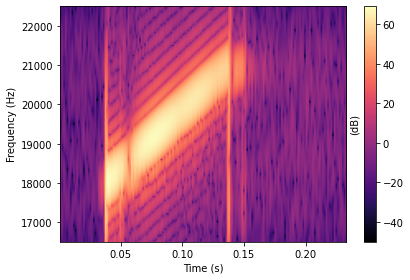

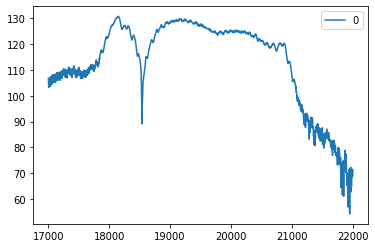

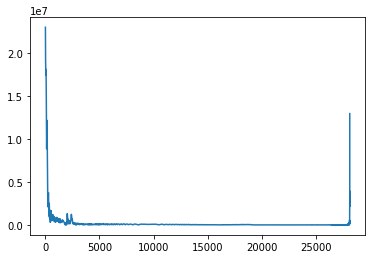

3179328


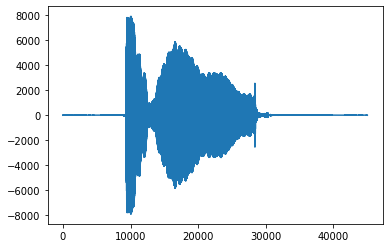

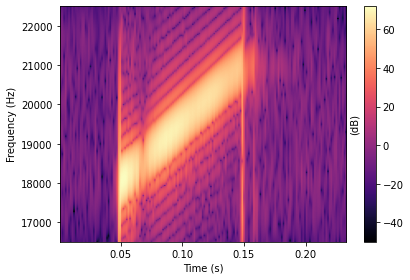

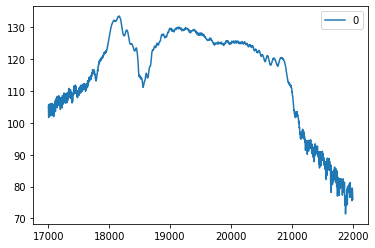

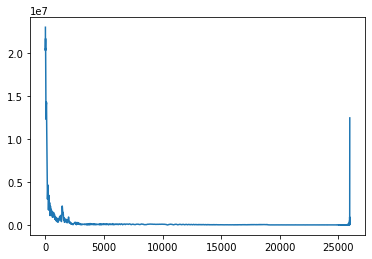

3277632


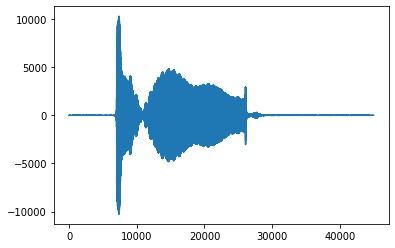

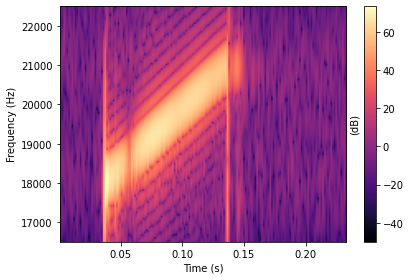

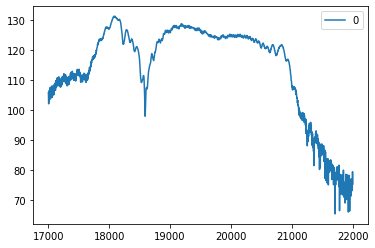

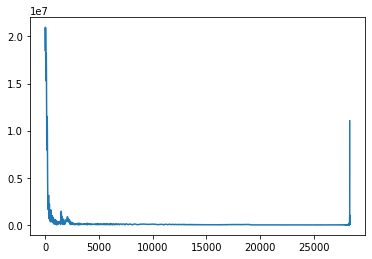

3375552


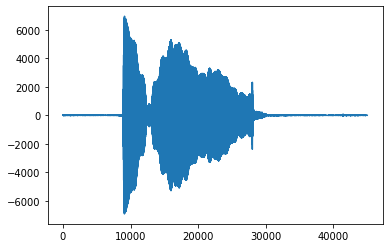

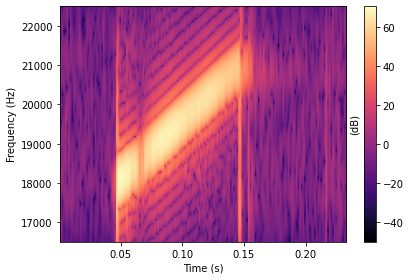

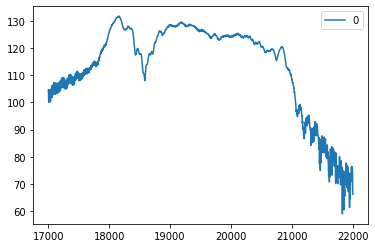

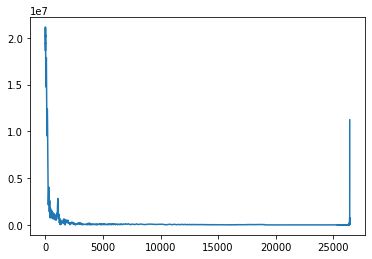

3474816


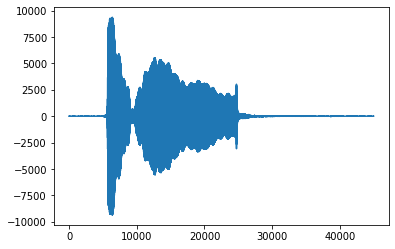

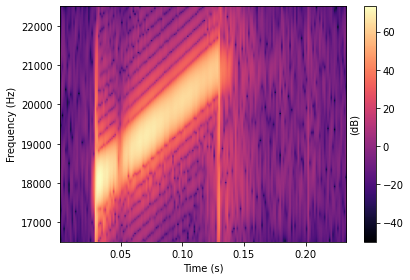

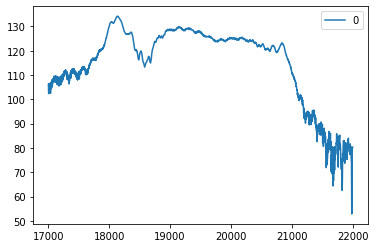

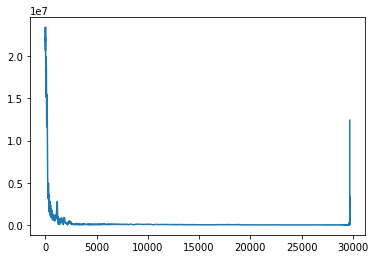

3573888


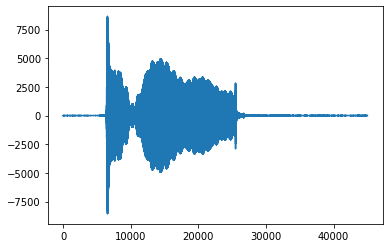

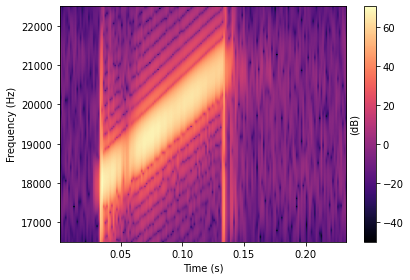

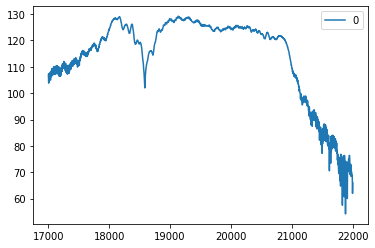

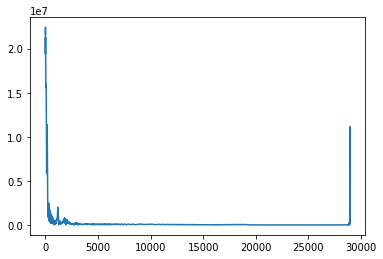

3671424


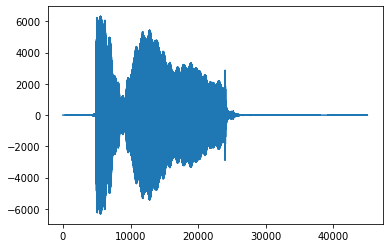

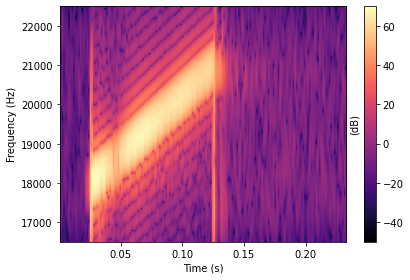

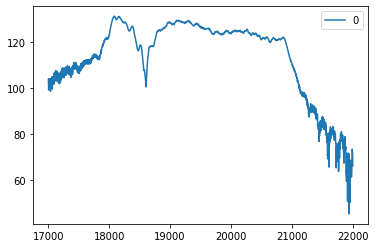

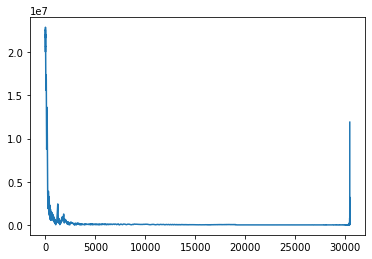

3770112


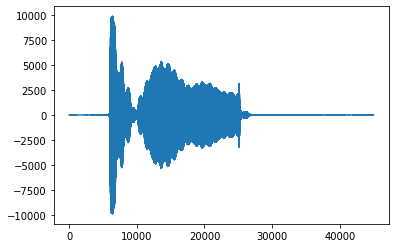

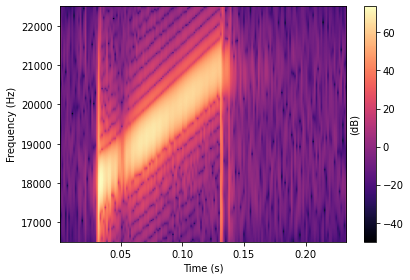

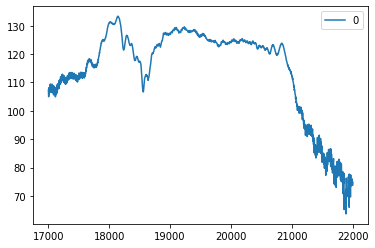

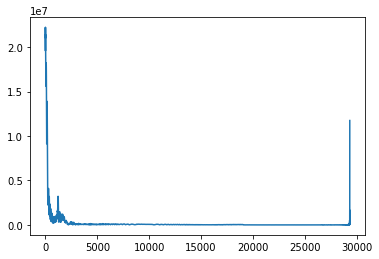

3868608


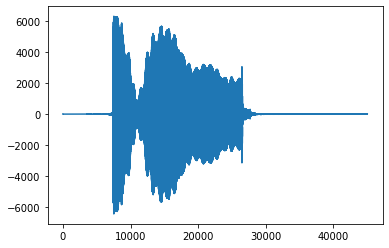

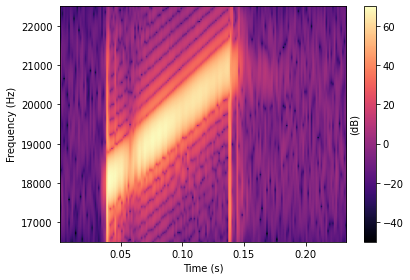

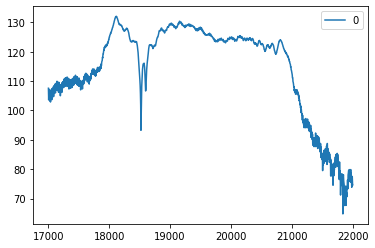

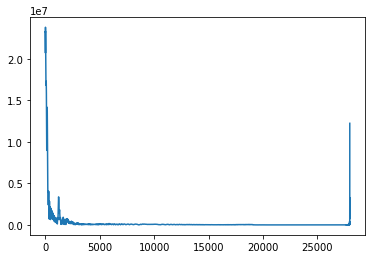

3966144


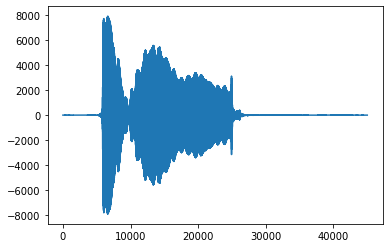

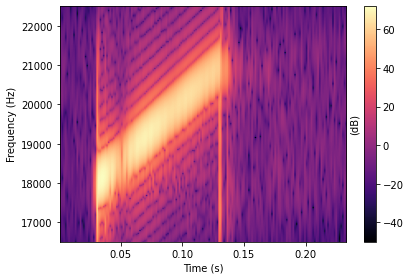

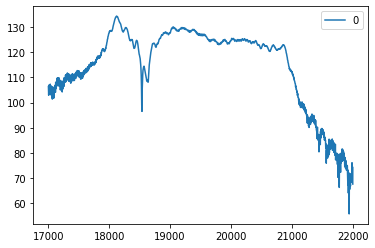

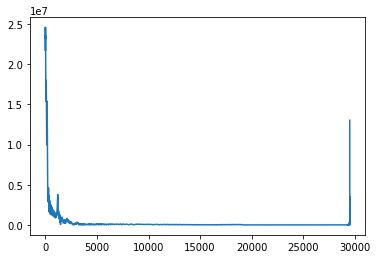

4064448


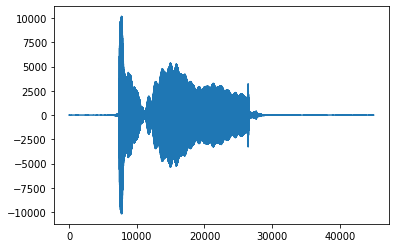

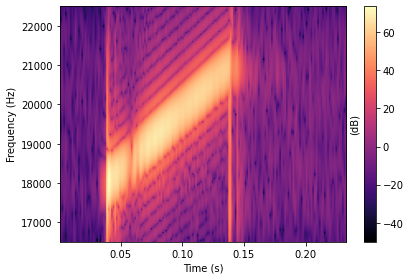

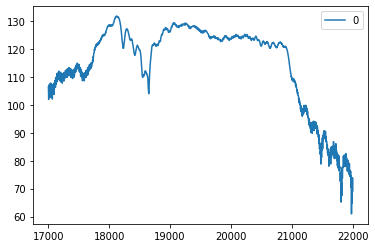

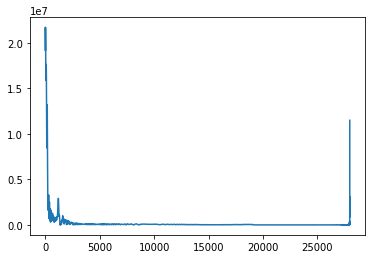

4162367


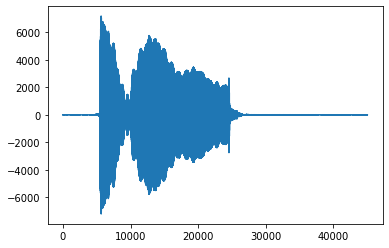

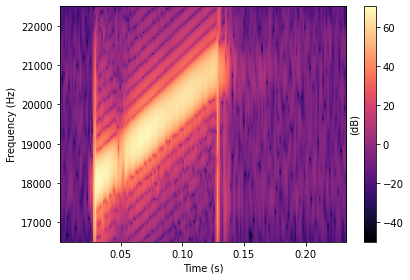

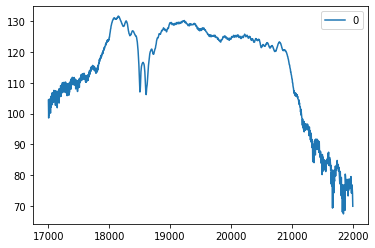

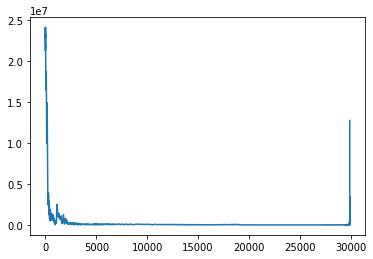

4260672


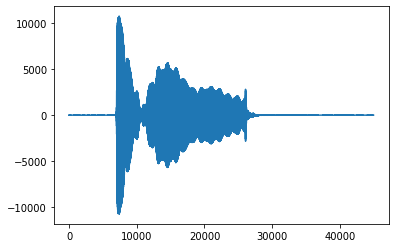

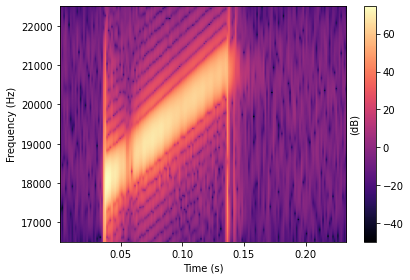

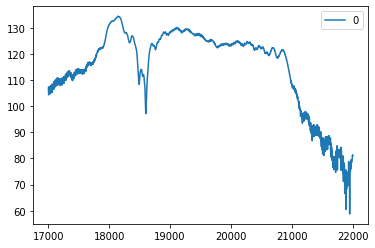

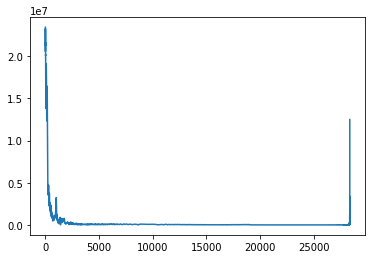

4358400


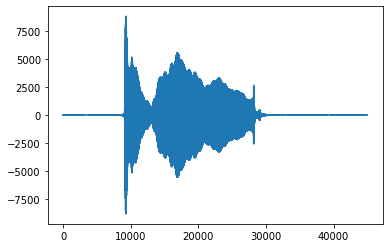

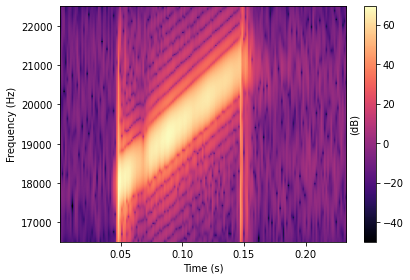

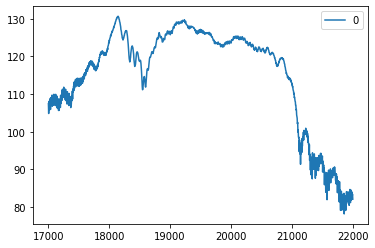

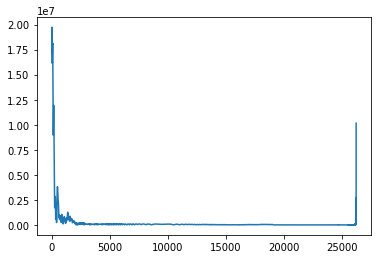

4456704


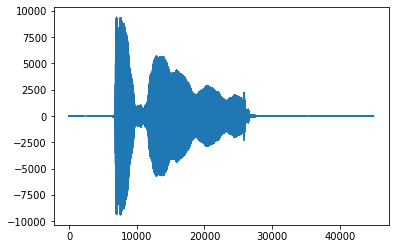

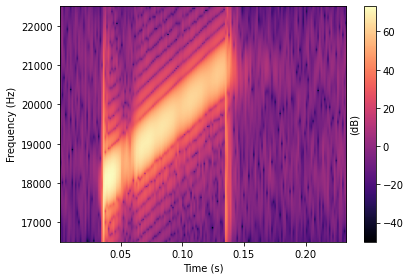

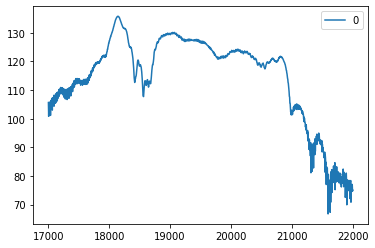

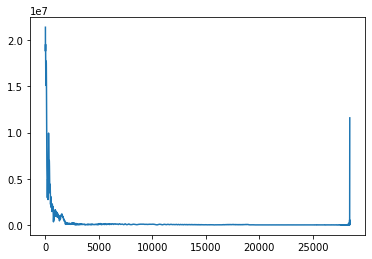

4555200


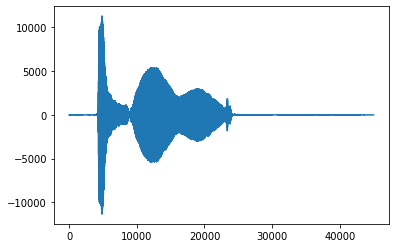

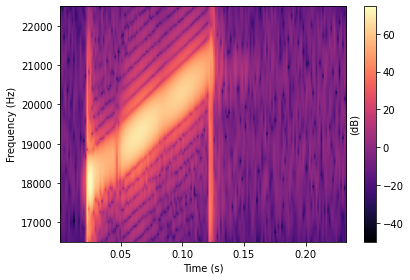

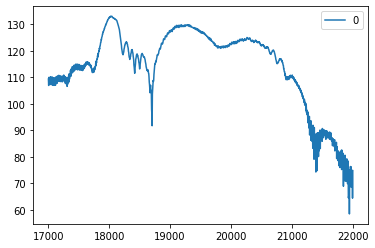

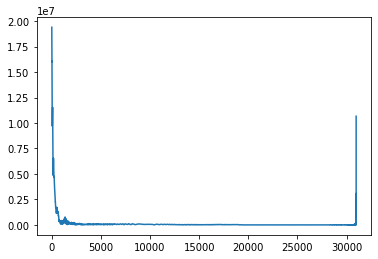

4652736


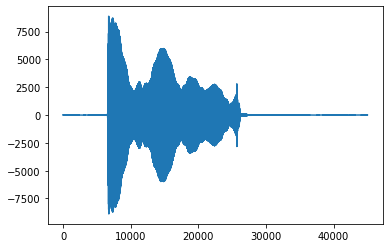

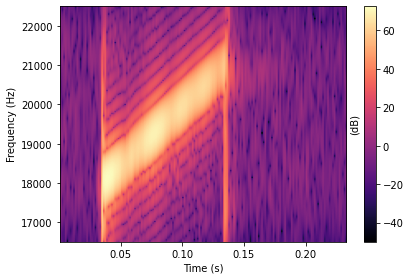

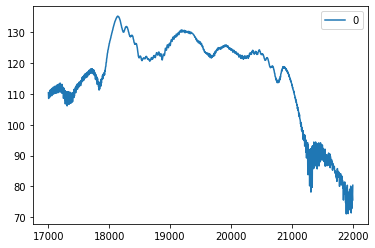

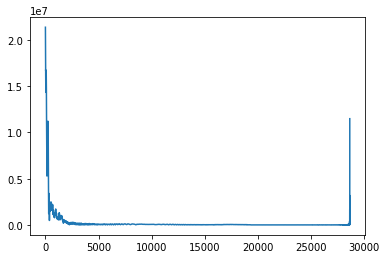

4750848


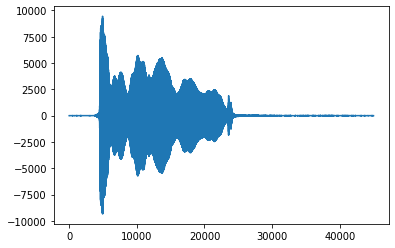

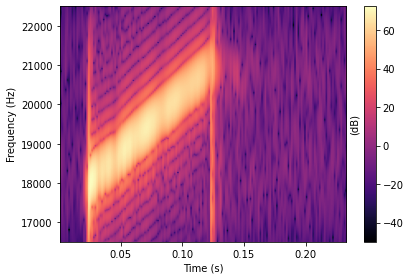

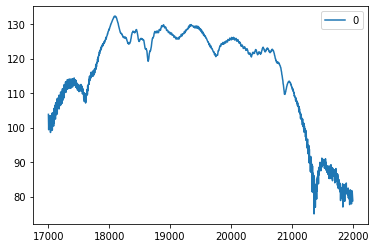

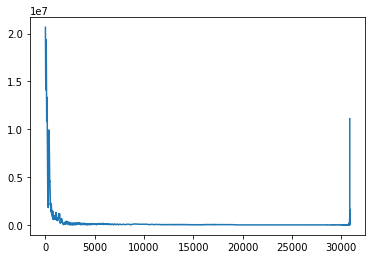

4849344


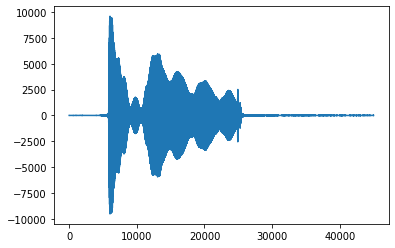

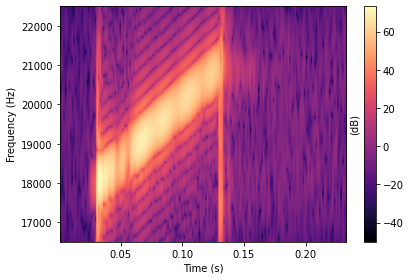

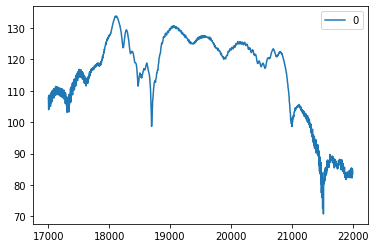

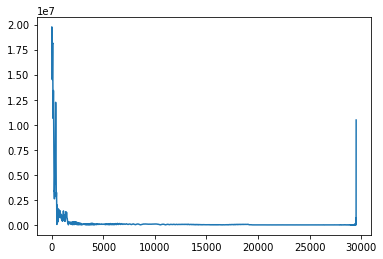

4947840


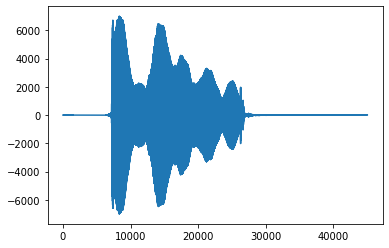

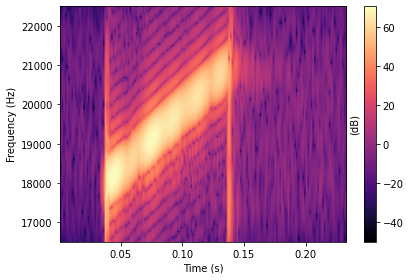

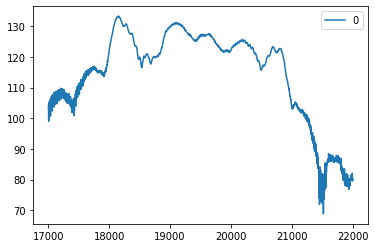

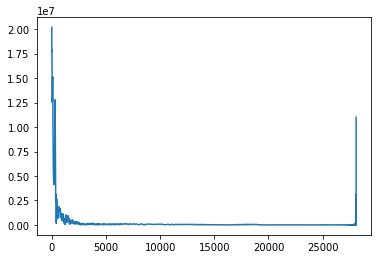

5045184


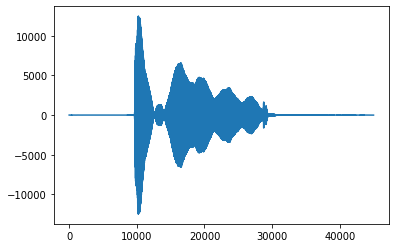

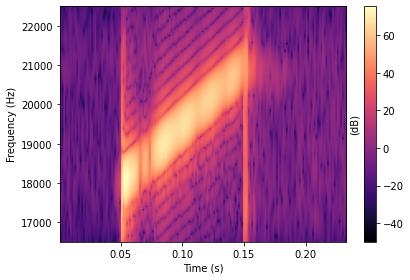

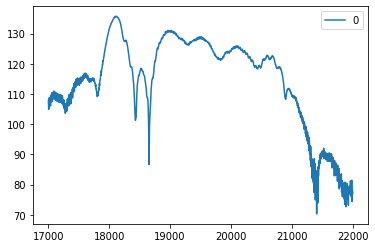

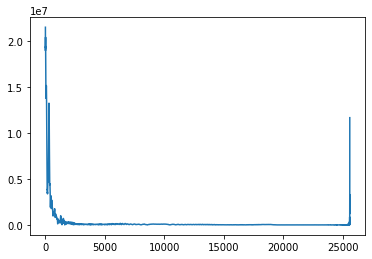

5143872


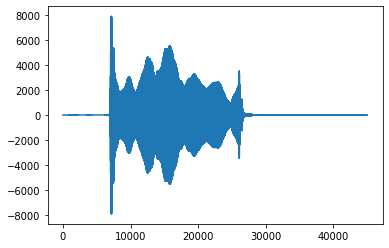

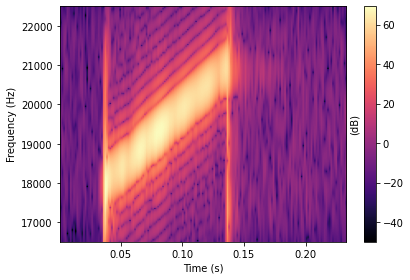

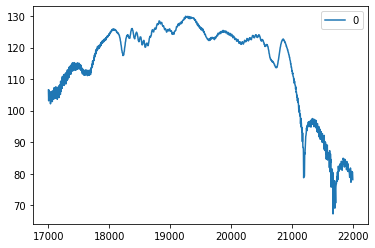

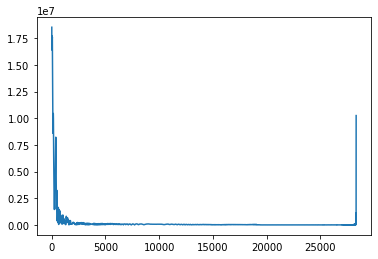

5241984


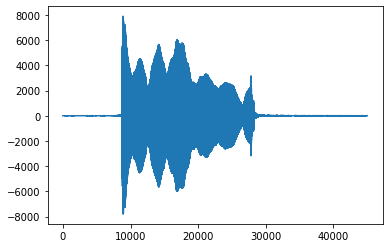

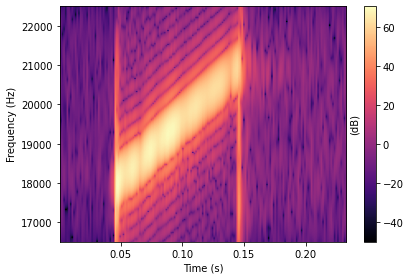

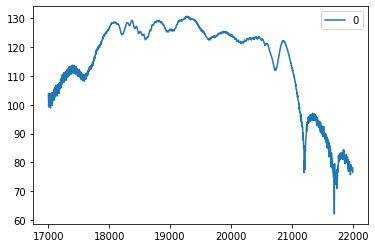

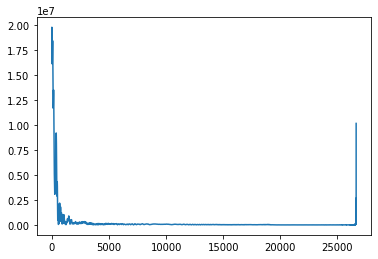

5340864


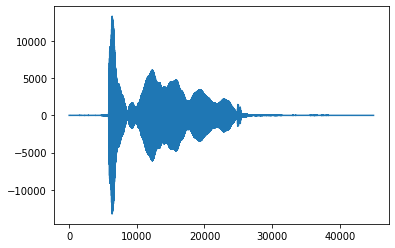

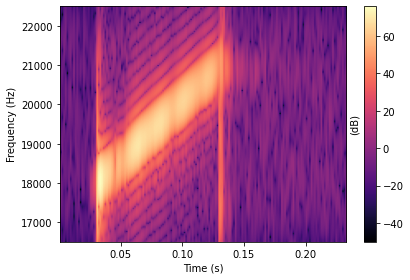

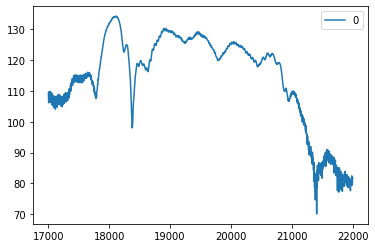

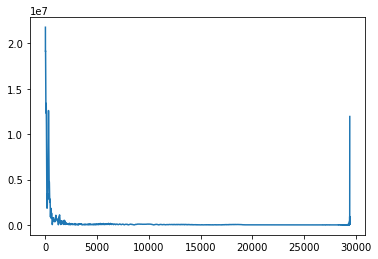

	 Calculating the impulse responses of the right stream
525312


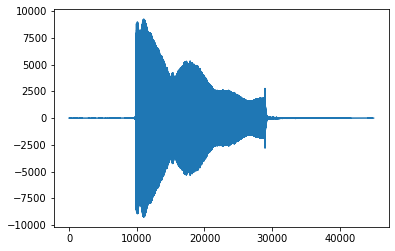

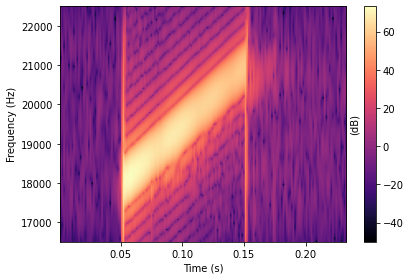

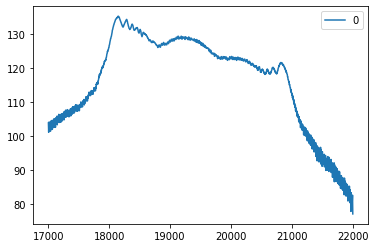

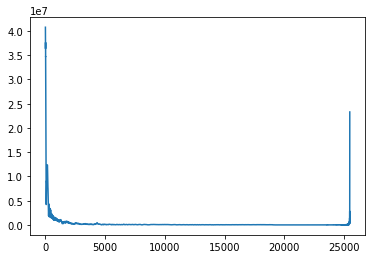

624000


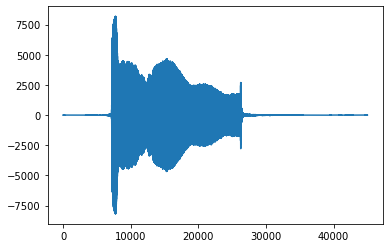

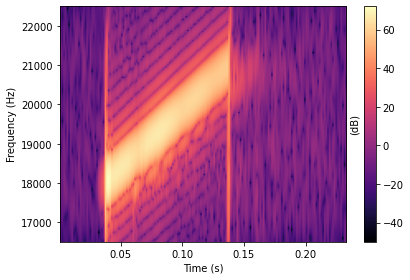

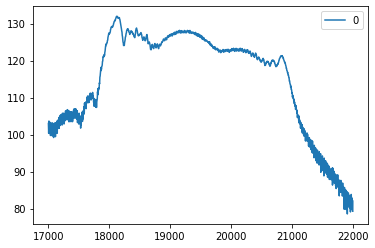

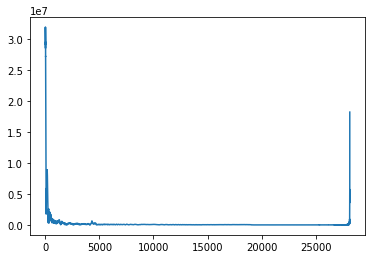

721920


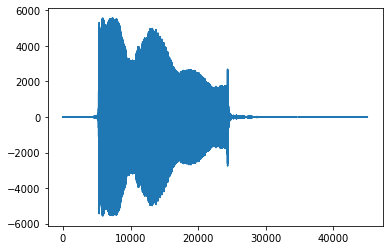

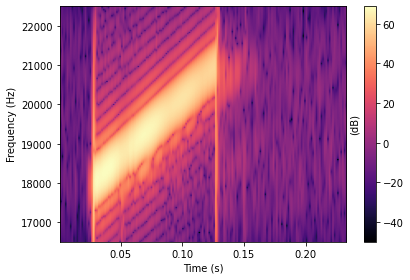

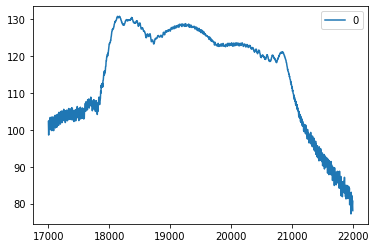

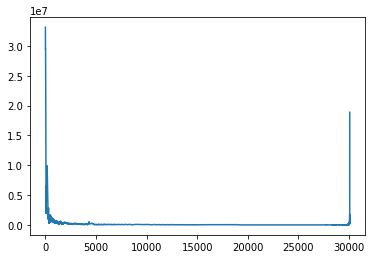

820992


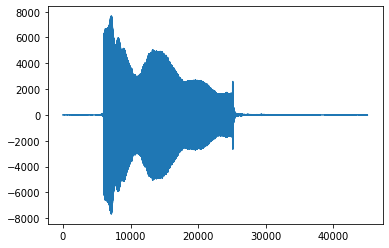

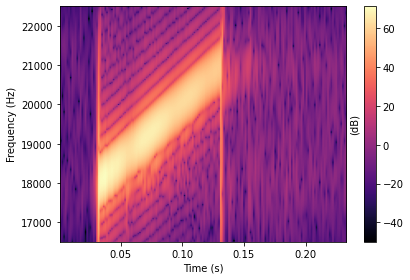

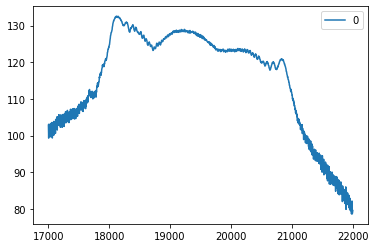

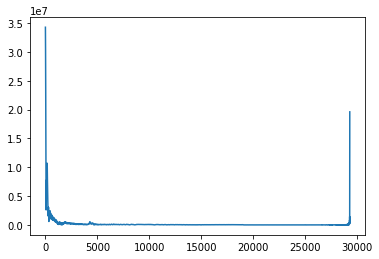

918528


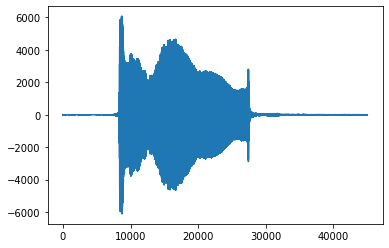

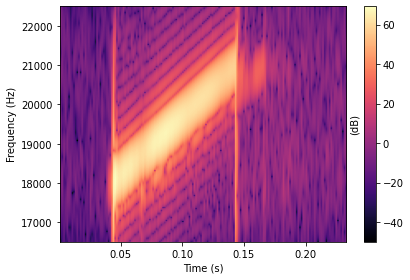

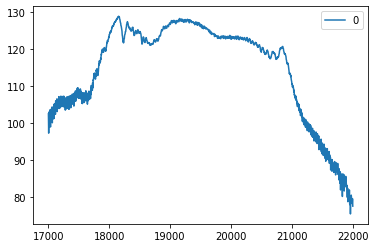

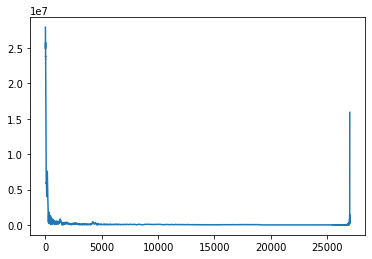

1017024


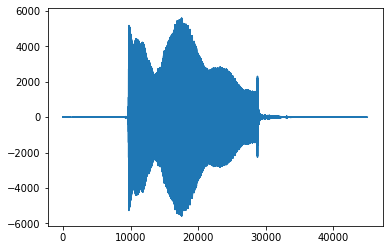

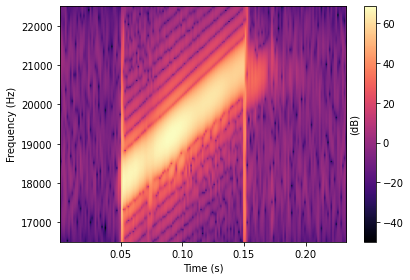

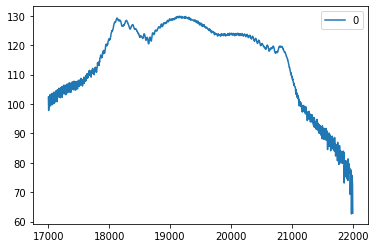

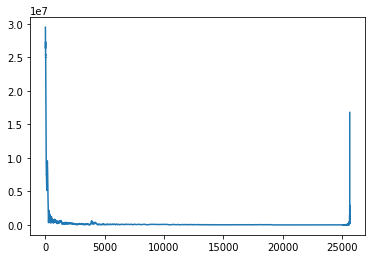

1115712


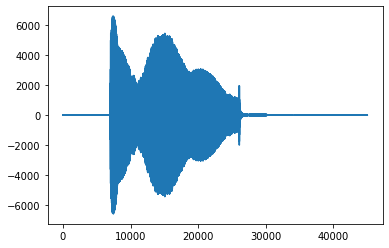

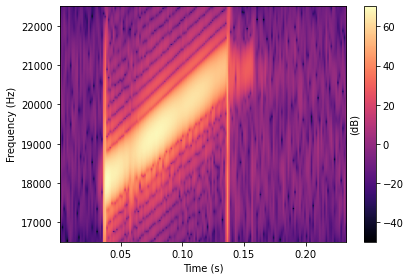

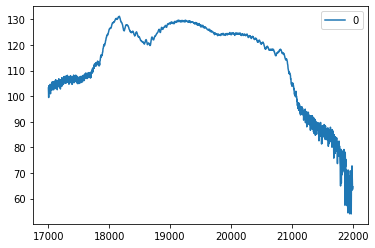

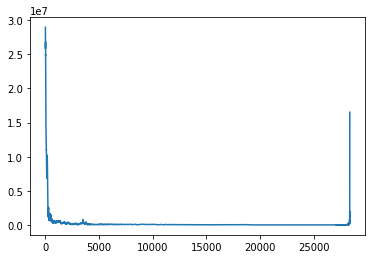

1213632


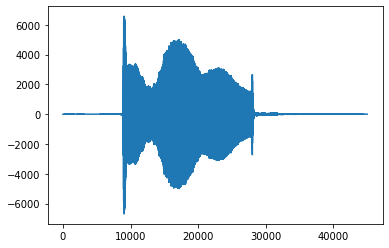

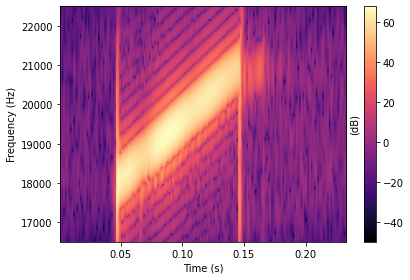

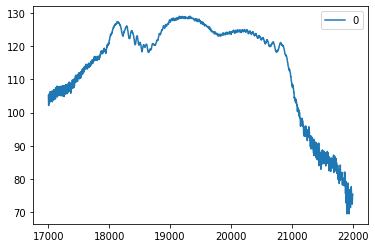

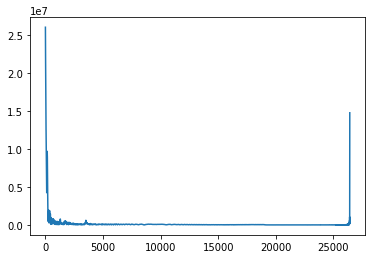

1312512


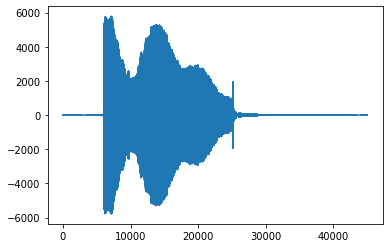

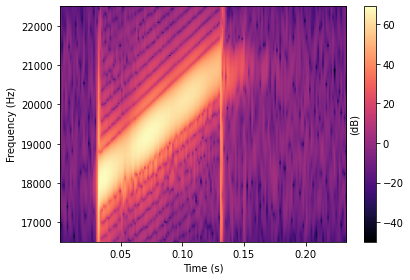

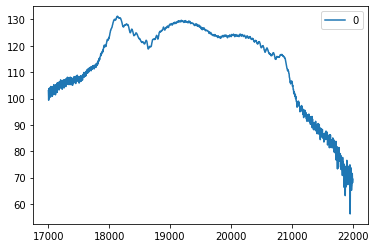

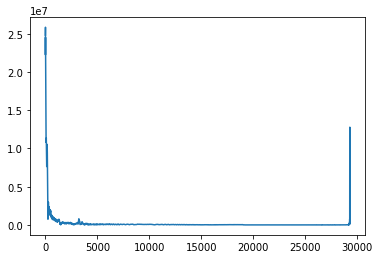

1411392


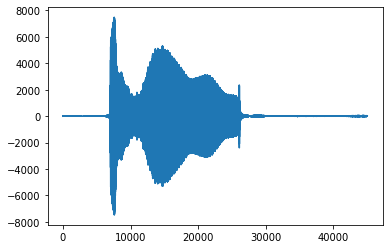

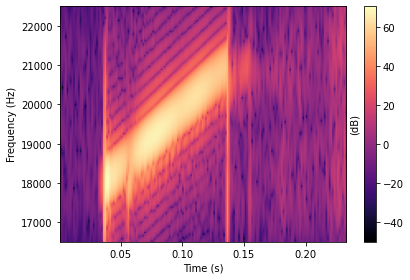

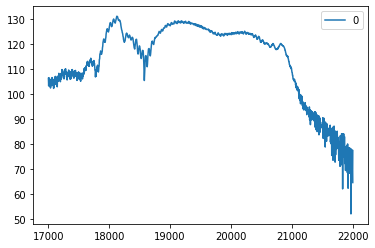

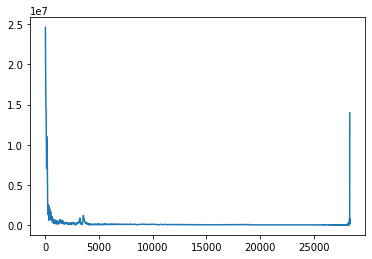

1509120


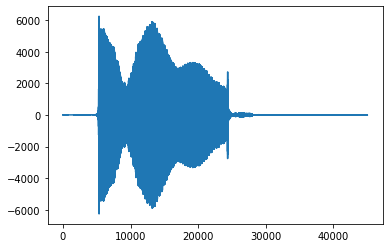

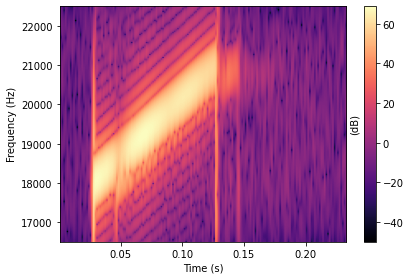

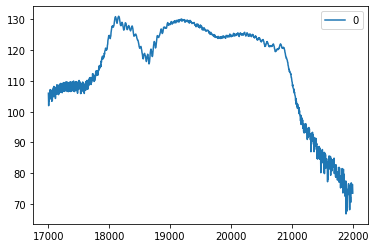

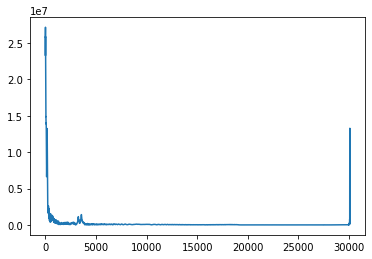

1607615


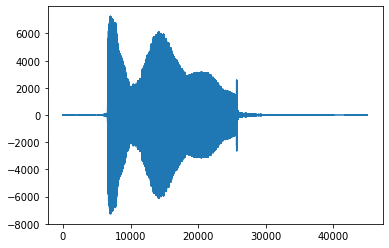

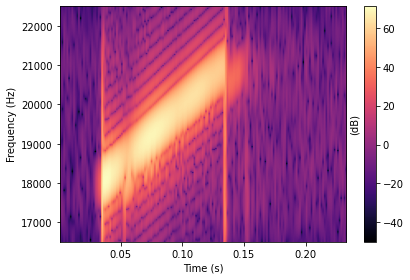

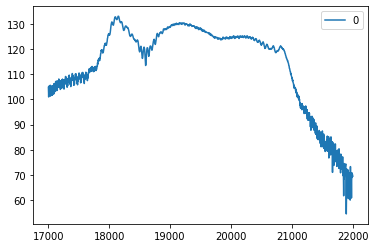

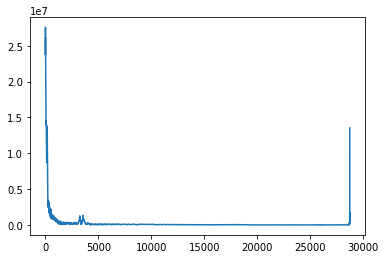

1705344


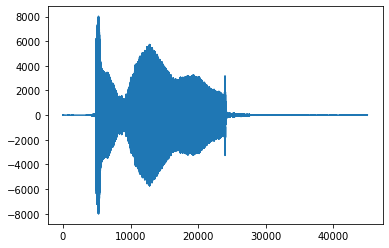

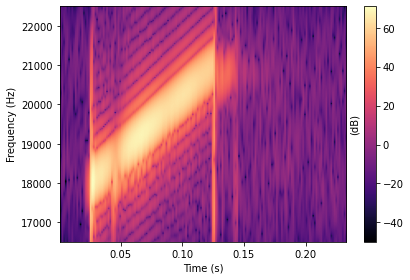

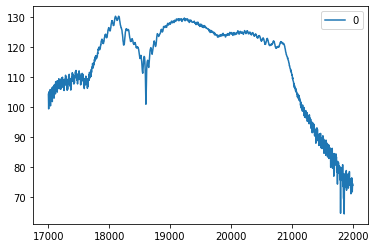

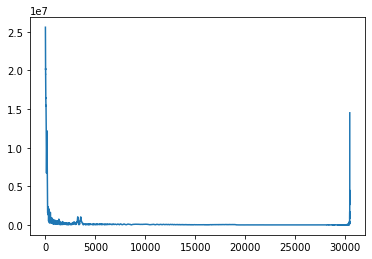

1803840


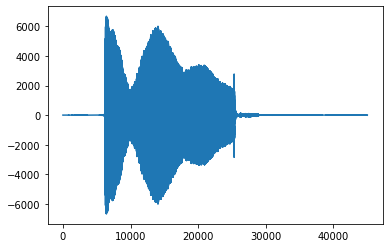

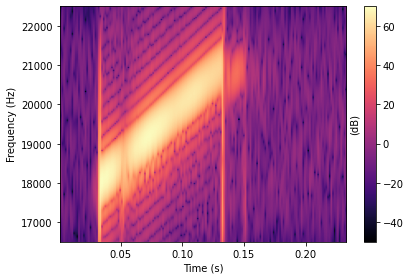

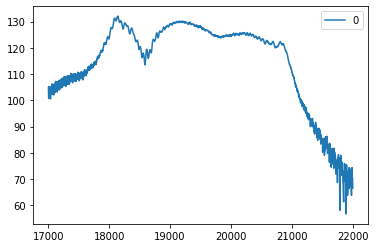

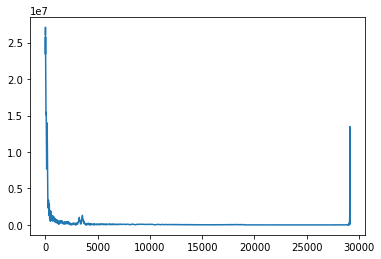

1901952


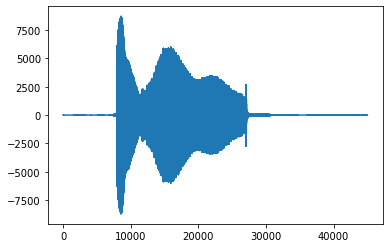

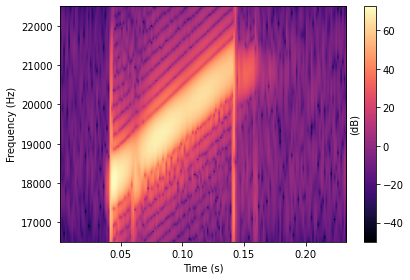

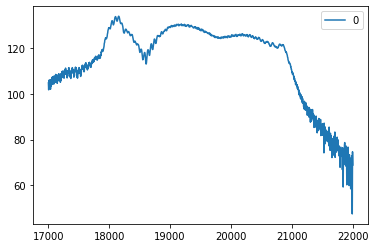

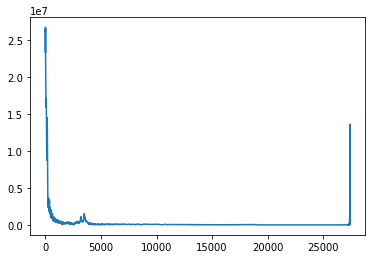

2000064


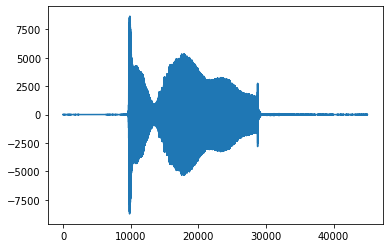

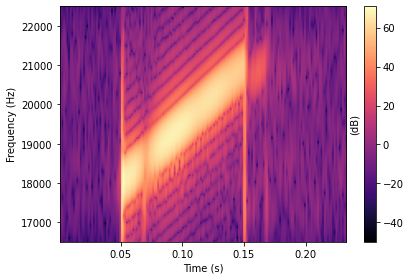

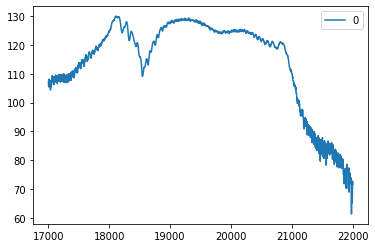

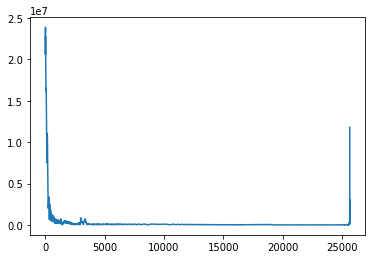

2099520


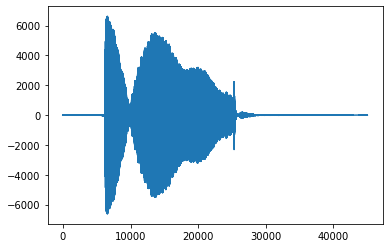

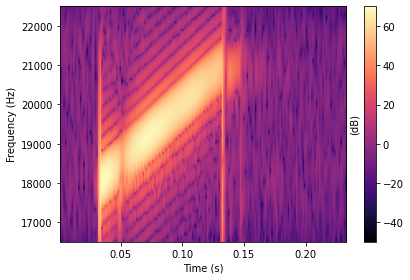

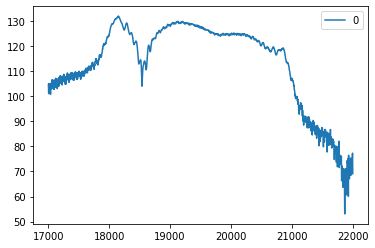

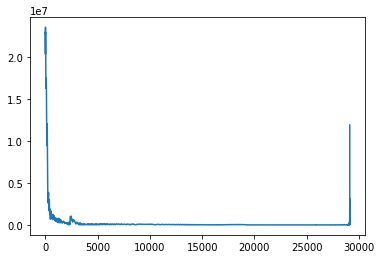

2197824


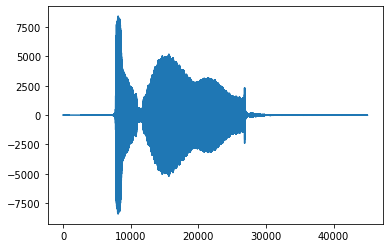

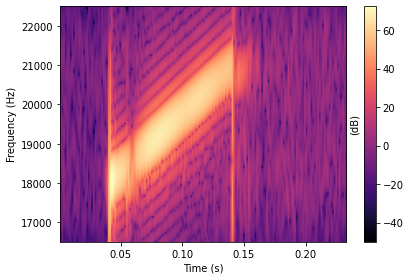

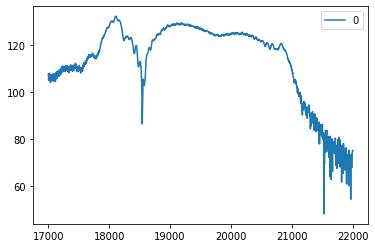

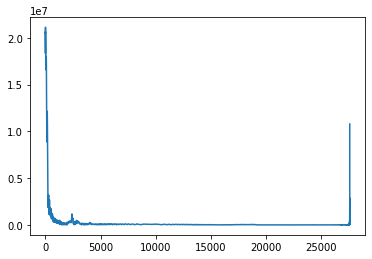

2295744


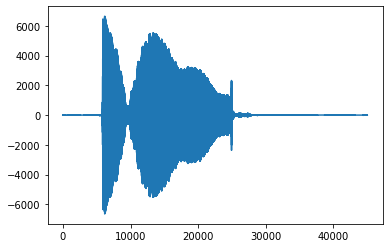

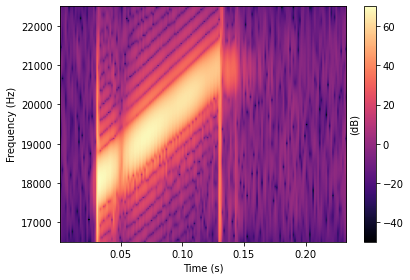

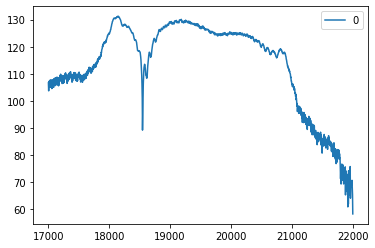

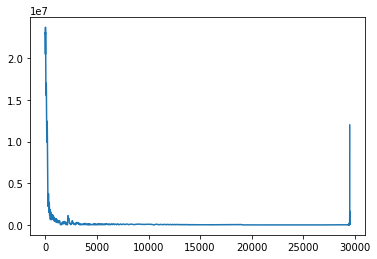

2393856


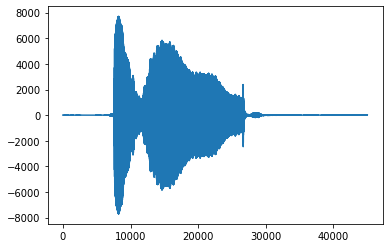

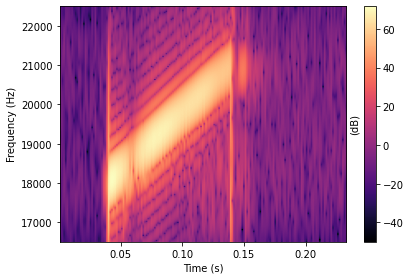

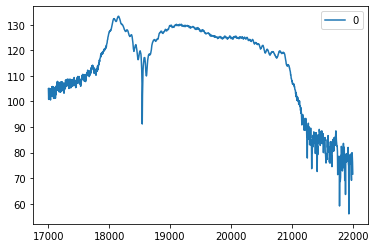

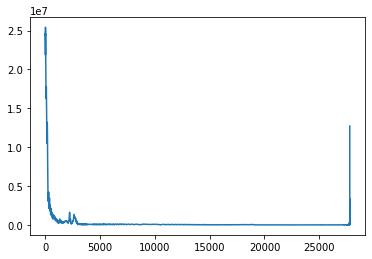

2491776


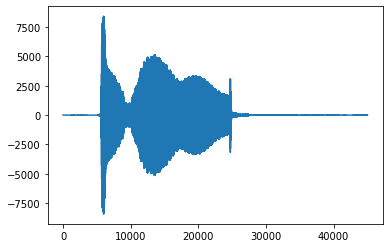

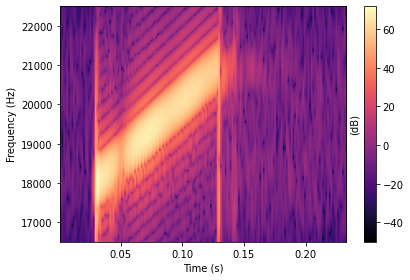

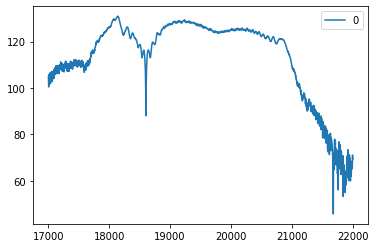

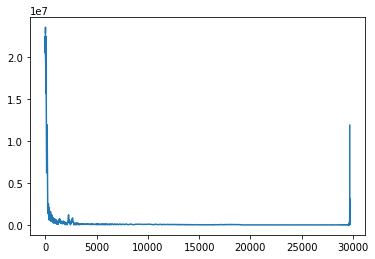

2590464


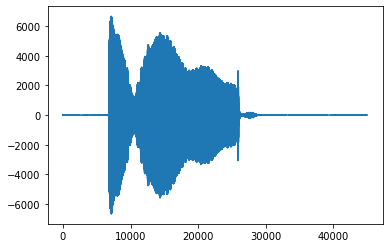

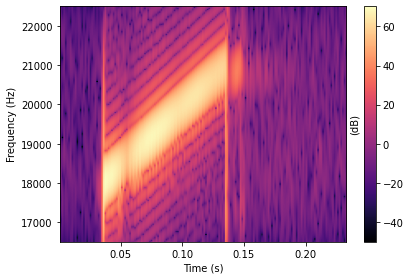

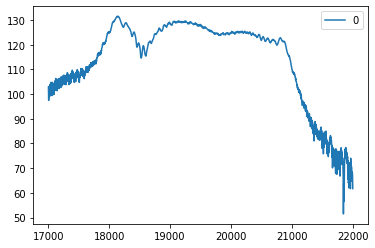

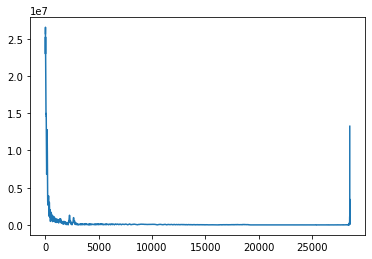

2688000


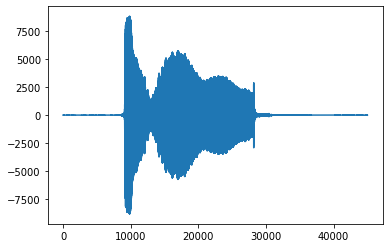

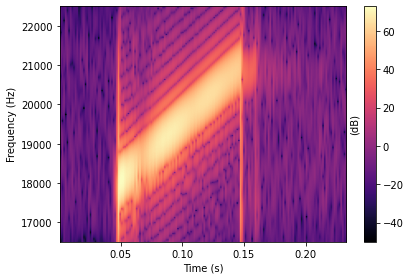

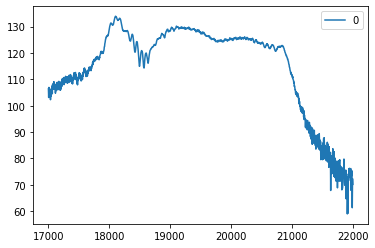

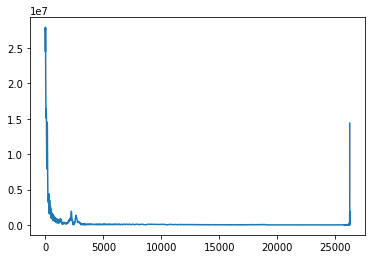

2785920


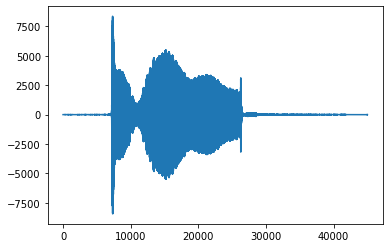

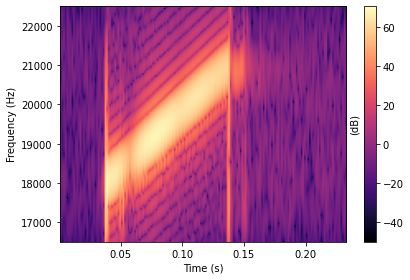

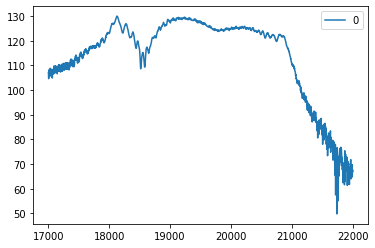

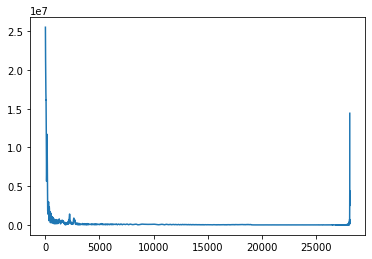

2883840


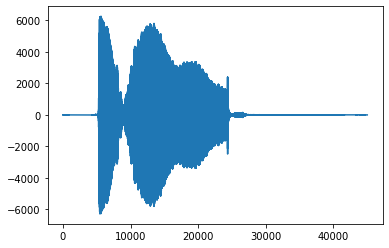

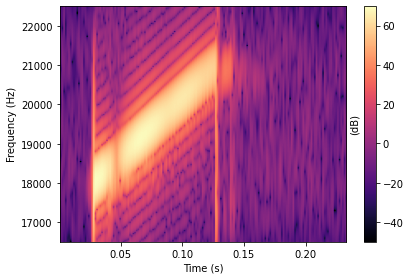

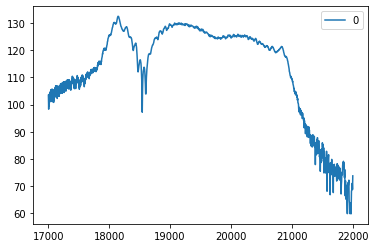

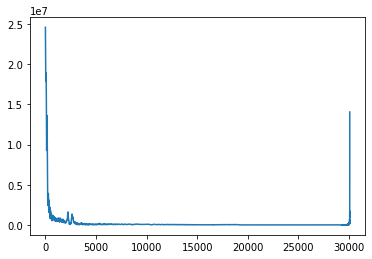

2981952


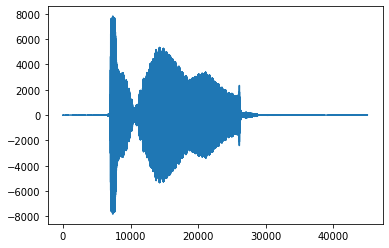

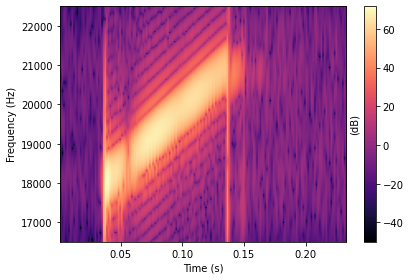

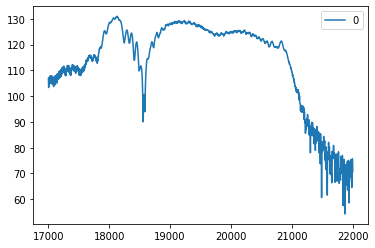

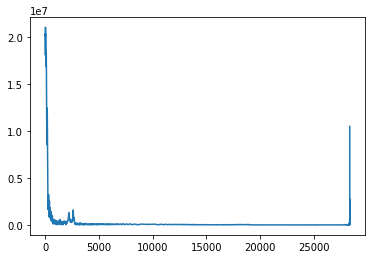

3081600


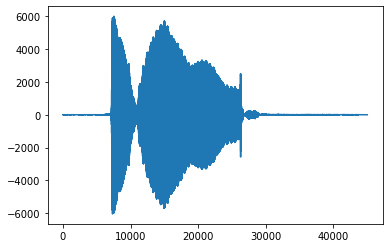

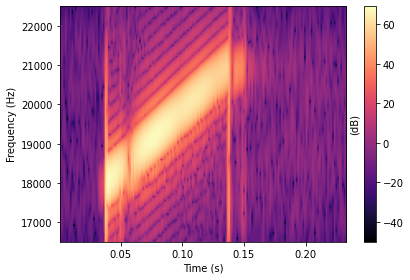

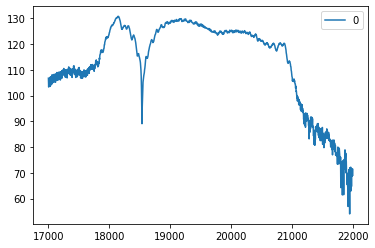

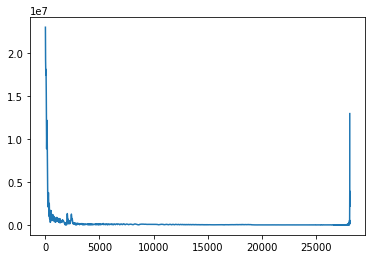

3179328


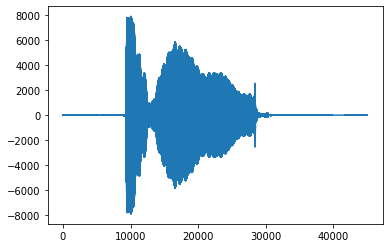

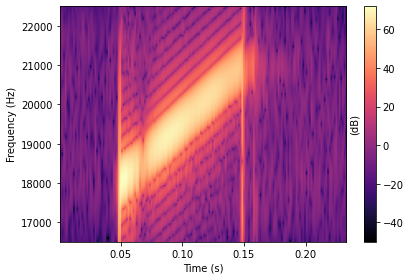

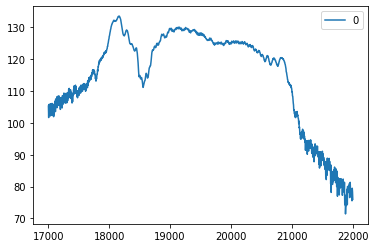

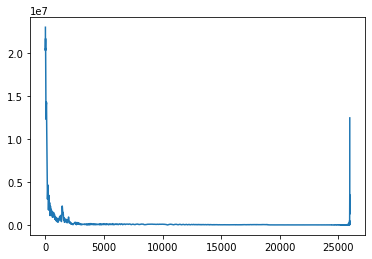

3277632


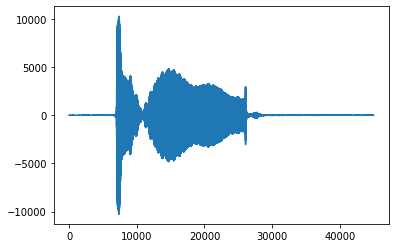

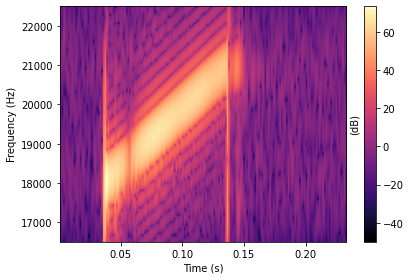

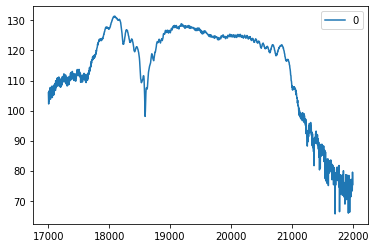

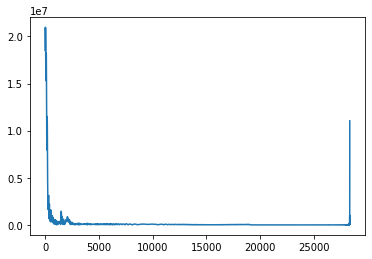

3375552


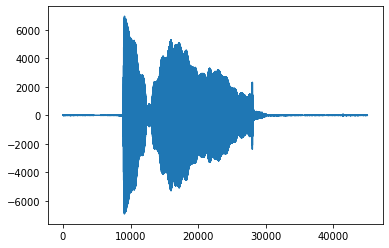

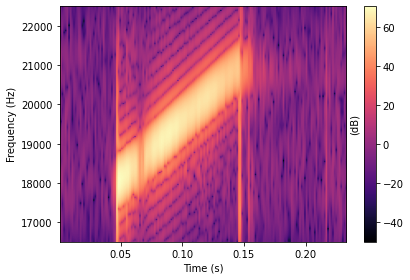

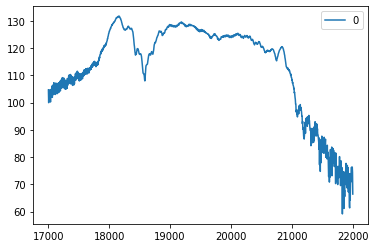

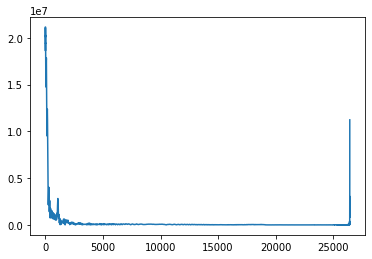

3474816


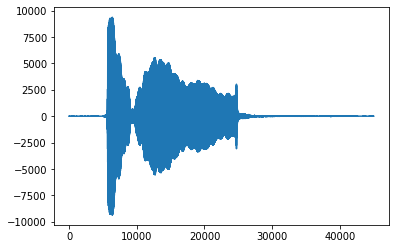

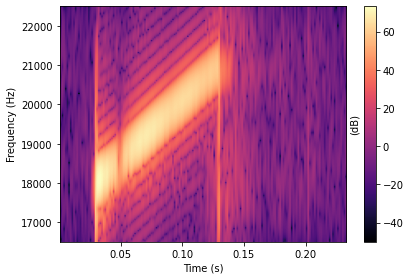

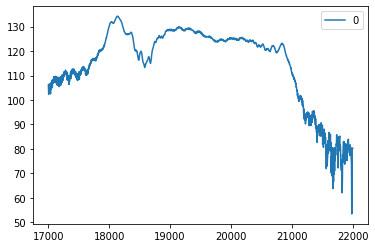

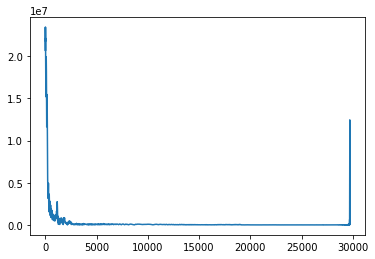

3573888


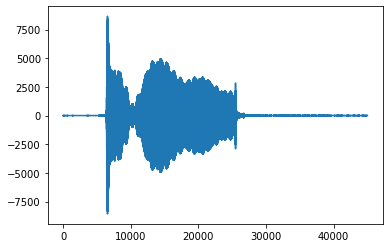

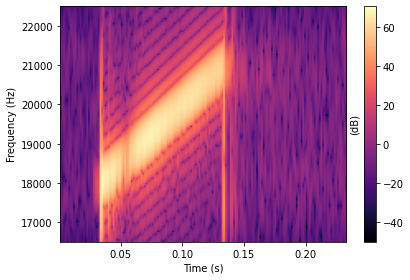

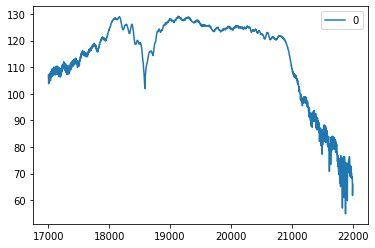

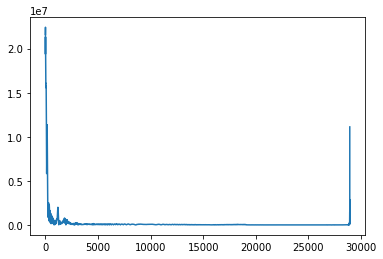

3671424


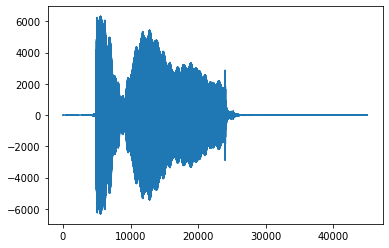

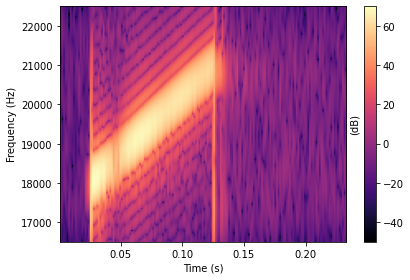

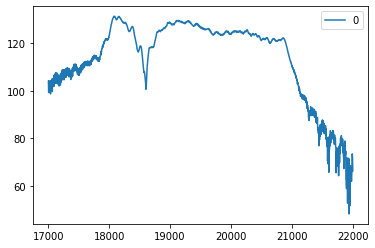

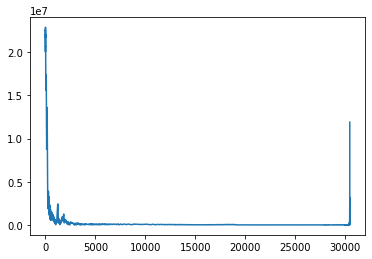

3770112


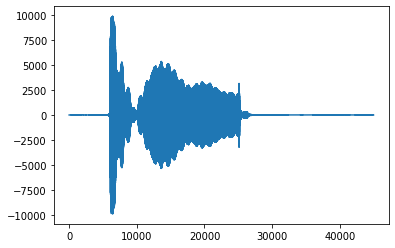

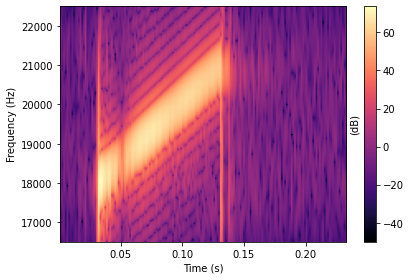

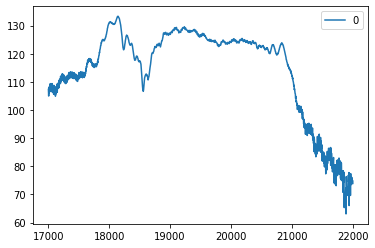

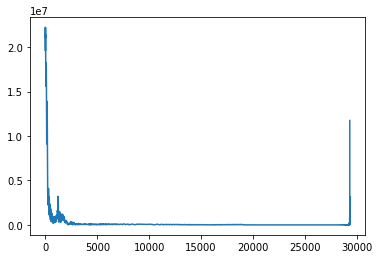

3868608


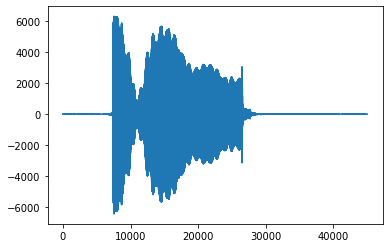

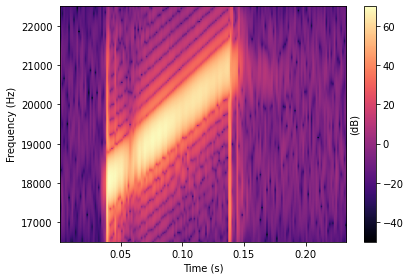

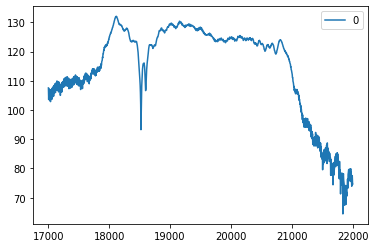

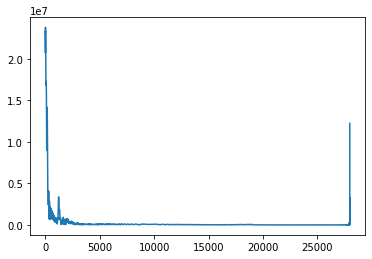

3966144


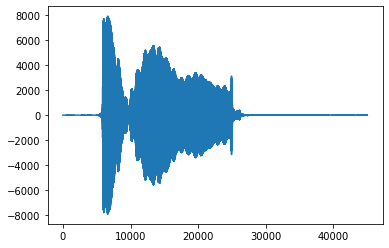

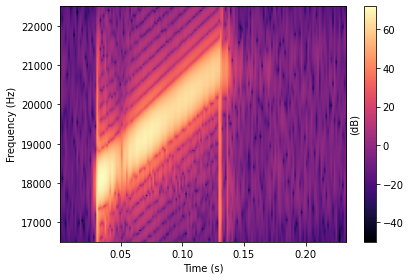

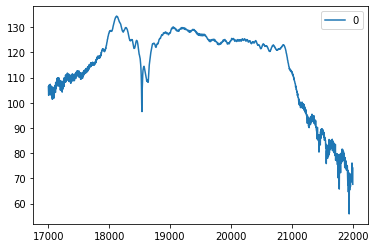

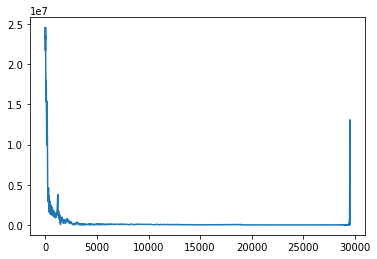

4064448


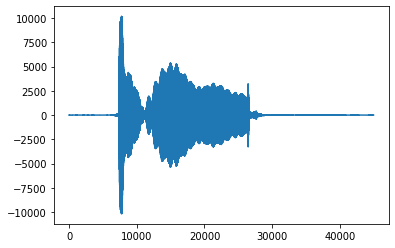

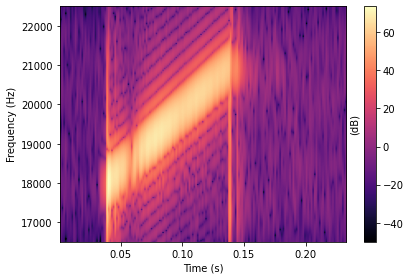

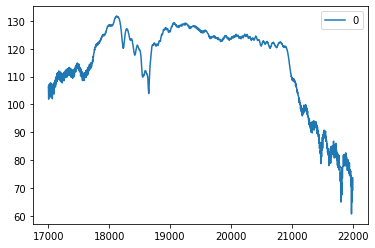

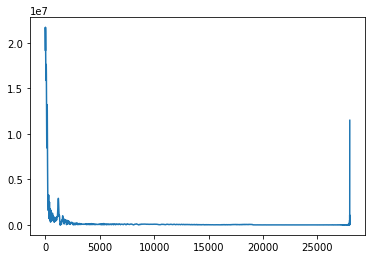

4162367


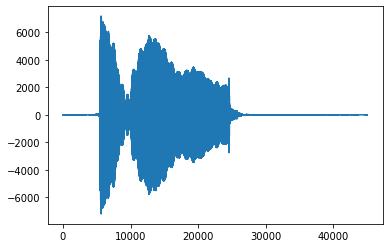

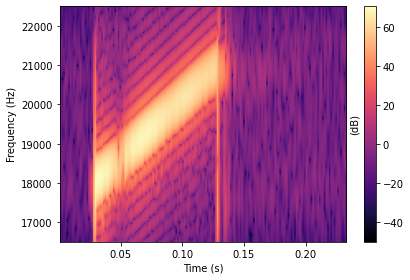

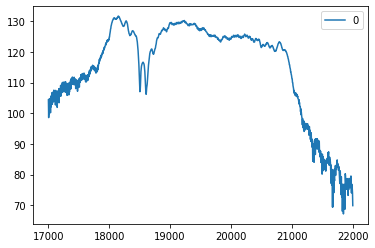

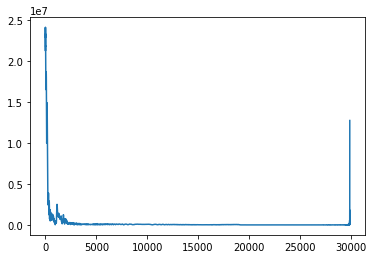

4260672


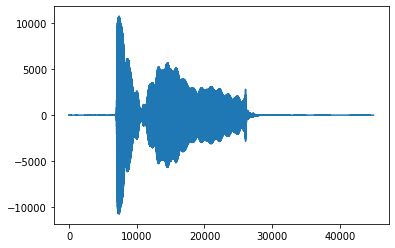

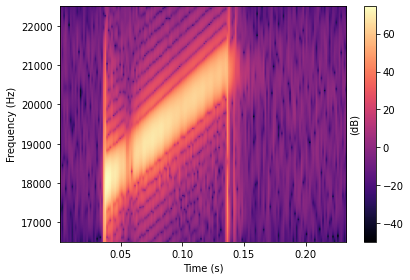

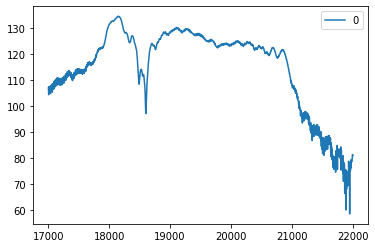

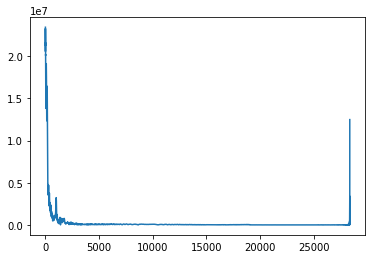

4358400


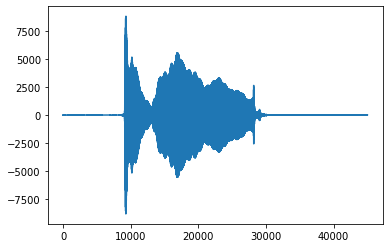

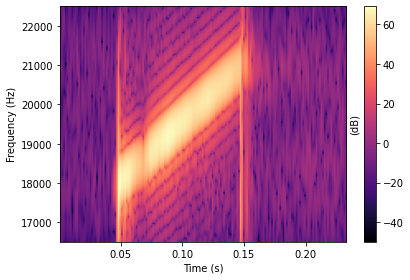

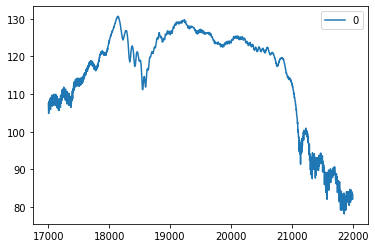

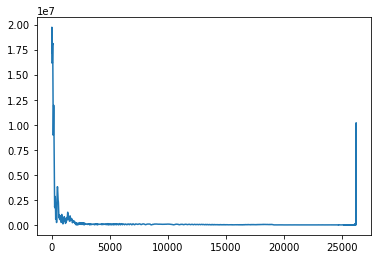

4456704


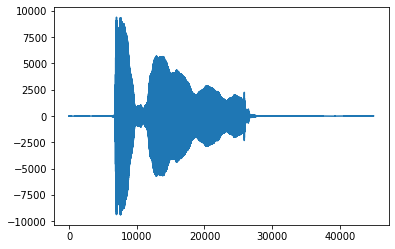

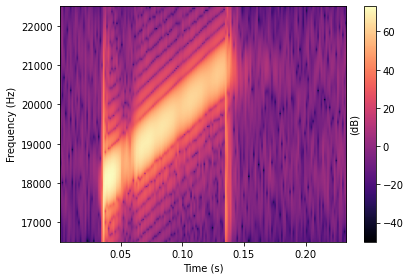

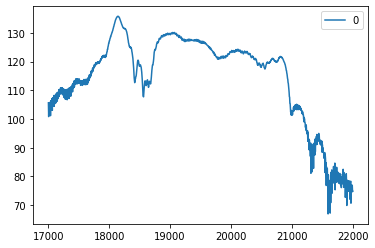

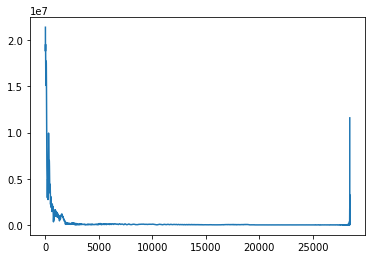

4555200


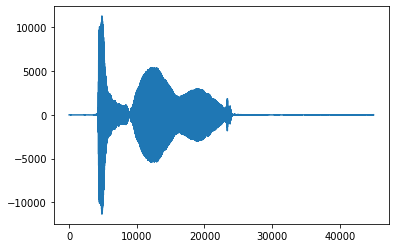

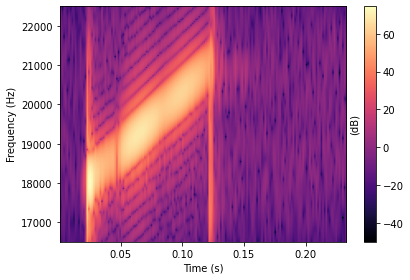

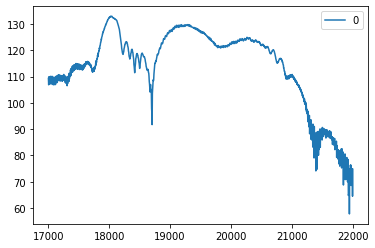

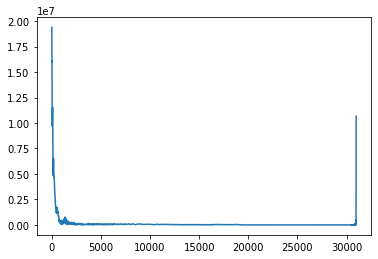

4652736


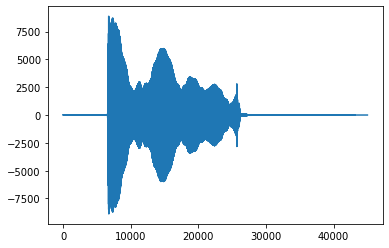

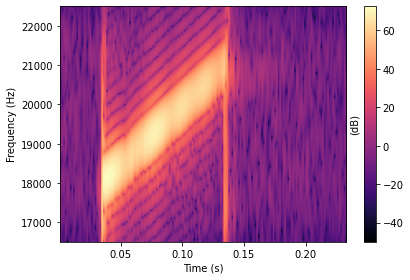

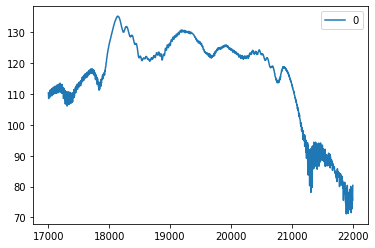

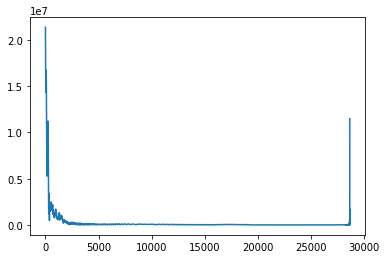

4750848


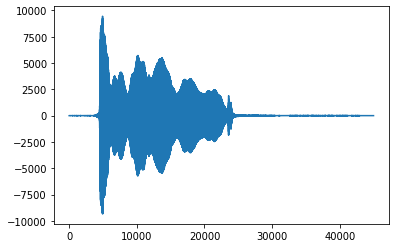

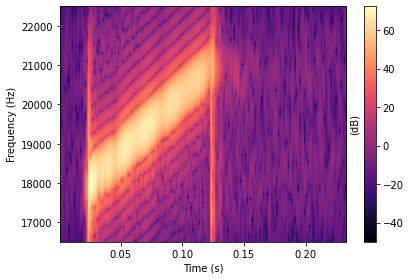

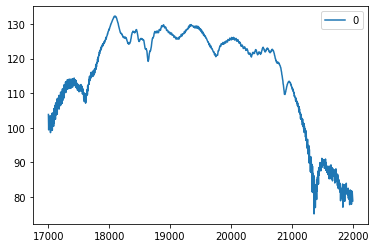

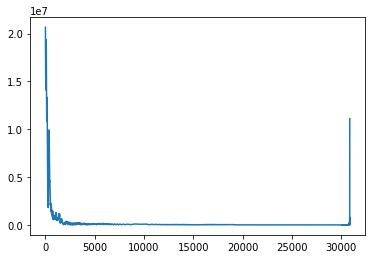

4849344


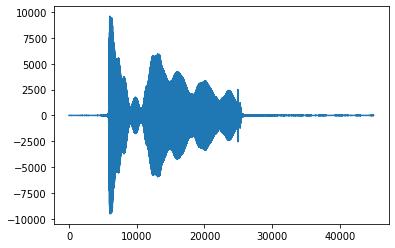

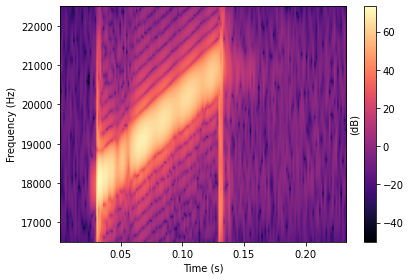

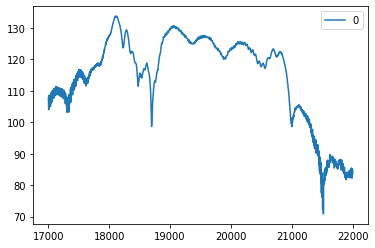

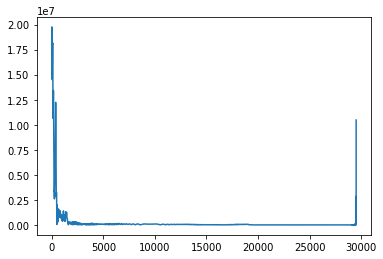

4947840


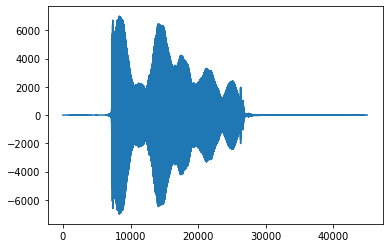

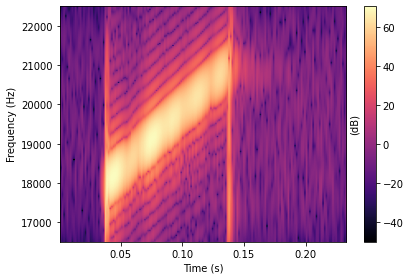

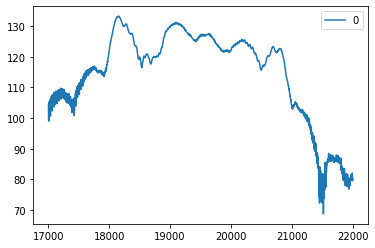

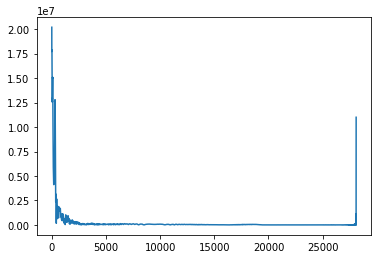

5045184


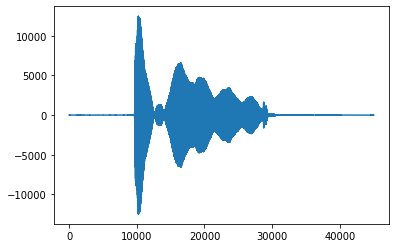

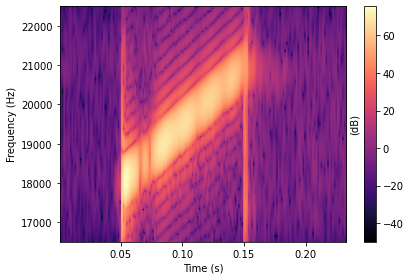

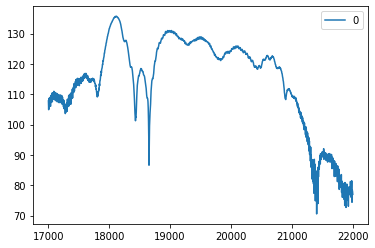

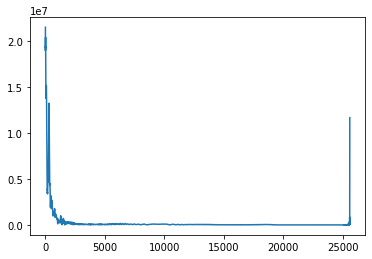

5143872


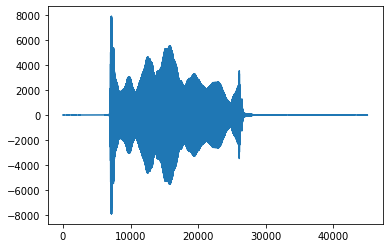

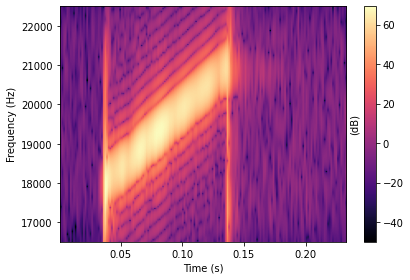

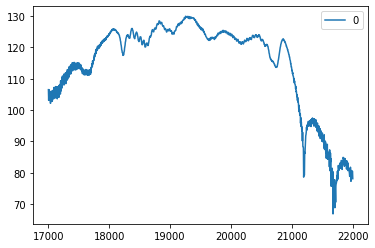

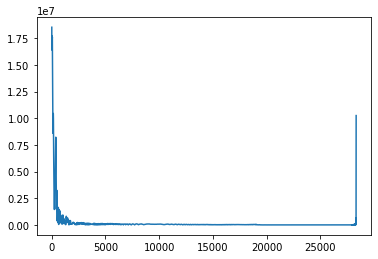

5241984


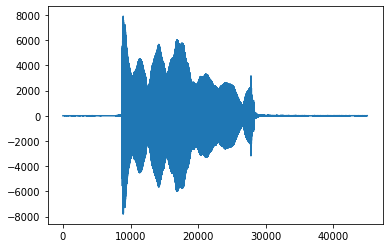

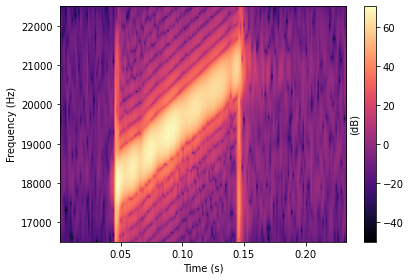

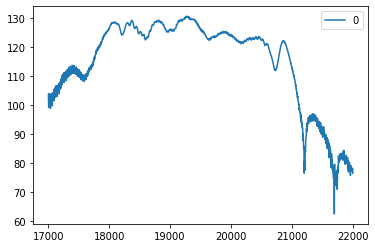

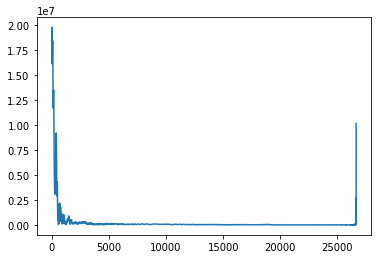

5340864


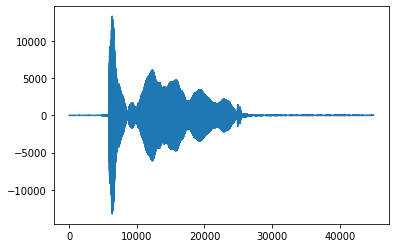

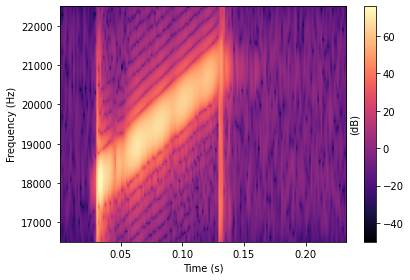

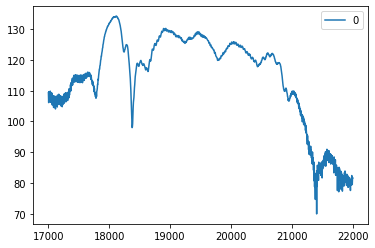

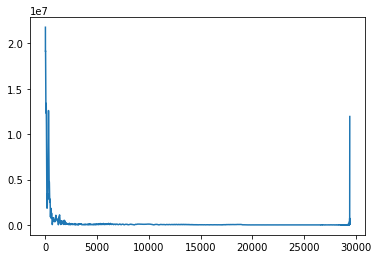







100%|██████████| 1/1 [02:51<00:00, 171.01s/it]

In [163]:
from tqdm import tqdm
from pathlib import Path
import gc
gc.enable()
count = 0
for ss in tqdm(selected_session):
    #print(mem())
    for audio_file in wav_filelist:
        if datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') >= ss[0] and datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') < ss[1]:
            audio_name = os.path.splitext(audio_file)[0]
            samplerate, data = wavfile.read(stereo_file_path + audio_file)
            data_left = data[:, 0]
            data_right = data[:, 1]
            #break
    #if audio_file == "20210310_155757_416.wav":
    #    continue
    #print("|" + "*"*(count+1) + ' '*(len(selected_session)-1-count)+ "| " +str(format(round((count+1)/len(selected_session))*100,'.3f')) + "% is complete..." ,end="\r")

    print("Calculating impulse responses from audio file " + audio_file)
    
    for aud_t in aud_timestamps:
        audio_start, audio_end = calc_start_end(aud_t)
        if (audio_start) >= ss[0] and (audio_start) < ss[1]:
            print('check')
            break
    
    ss_sweep_timestamps = []
    for sw in sweep_timestamps:
        if sw >= ss[0] and sw < ss[1]:
            ss_sweep_timestamps.append(sw)
    
    
    for data in [data_left,data_right]:
        corr = []
        corr_raw = []
        if (data == data_left).all():
            stream = "left"
        if (data == data_right).all():
            stream = "right"
            
        data = filter_signal(data)
        
        print("\t Calculating the impulse responses of the " + stream + " stream")
        norm_data = data #if add normalize_data(data) if it is necessary to normalize the data before calculating the impulse response
        
        generated_sweep = generate_sweep()

        if samplerate == 192000:
            start = 20000#45000
        if samplerate == 96000:
            start = 35000#35000
        if samplerate == 48000:
            start = 10000
            
        my_file_ir = Path("processed/mfccs/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
        my_file_ir_raw = Path("processed/spectra/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
#         if my_file_ir.is_file() and my_file_ir_raw.is_file():
#             print("\t \t File already exists...")
#             break
        #else:       
        for ss_sw in ss_sweep_timestamps:
            sweep_sample = int((ss_sw - audio_start).total_seconds()*samplerate)
            print(sweep_sample)

            if samplerate == 96000:
                sweep = norm_data[sweep_sample - start:sweep_sample]#norm_data[sweep_sample - 11400:sweep_sample-6990]
            if samplerate == 192000:
                sweep = norm_data[sweep_sample+5000:sweep_sample+50000]#for s20+ ultra 
                #sweep = sweep = norm_data[sweep_sample-50000:sweep_sample-20000]#norm_data[sweep_sample+7000:sweep_sample+37000]# #for note s20
            #print("Generated length = ", len(generated_sweep))
            #print("Recorded sweep length = ", len(sweep))
            #plt.figure(figsize=(30,10))
            plt.plot(sweep)
            plt.show()
            visualize_fft(sweep)
            plt.show()
            calculate_spectrum(sweep).T.plot()
            plt.show()
            #spectrum = calculate_spectrum(sweep)
            #spectrum.plot()

            if sweep.size>0:
                conv = np.correlate(sweep,generated_sweep[::1],'same')
                conv_cut = conv[conv.argmax():]
                envelop = calc_envelop(conv_cut)
                plt.plot(envelop)
                plt.show()
                #envelop2 = get_envelop(conv_cut)
                corr_raw.append(conv_cut)
                corr.append(envelop)
        nc_raw = []
        nc = []
        for i in corr_raw:
            nc_raw.append(i[:6000]/max(i[:6000]))
        for i in corr:
            nc.append(i[:6000]/max(i[:6000]))
            
        trimmed_ir_raw = pd.DataFrame(nc_raw)
        trimmed_ir = pd.DataFrame(nc)
        
        mfcc_feat = extract_mfcc_feat(trimmed_ir_raw)
        spec_feat = extract_spectral_feat(trimmed_ir_raw)
        
        make_folder_structure()
        
        #Save data
        #mfcc_feat.to_csv("processed/mfccs/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        #spec_feat.to_csv("processed/spectra/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        
        gc.collect()
        #break
    count = count + 1
    #break

In [152]:
samplerate

192000

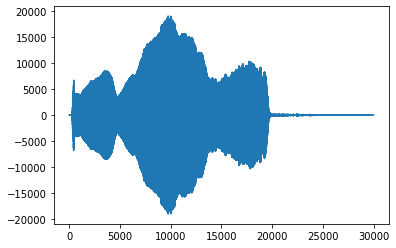

In [79]:
plt.plot(sweep)

<AxesSubplot:>

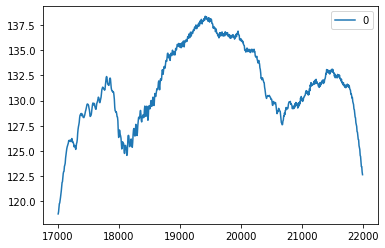

In [83]:
calculate_spectrum(sweep).T.plot()

In [446]:
audio_start

datetime.datetime(2021, 7, 16, 16, 6, 35, 480000)

In [447]:
sweep_sample

941760

In [344]:
(ss_sw - audio_start).total_seconds()

3.146

In [172]:
os.sched_getaffinity(0)

{0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31}

  0%|          | 0/3 [00:00<?, ?it/s]

Calculating impulse responses from audio file 20210714_191904_156.wav
	 Calculating the impulse responses of the left stream


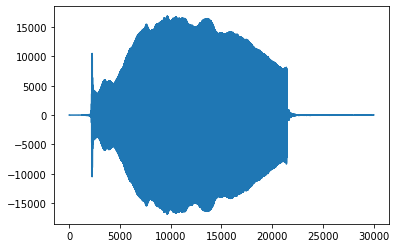

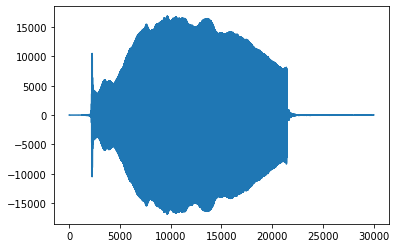

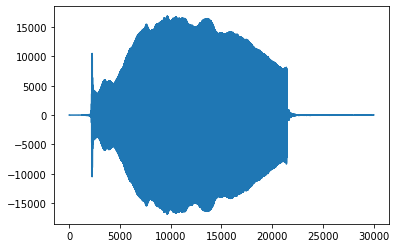

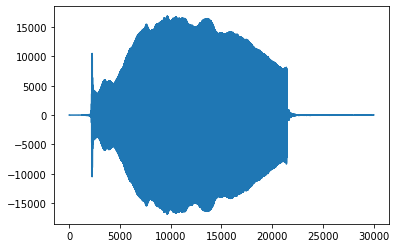

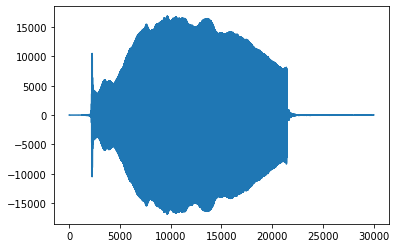

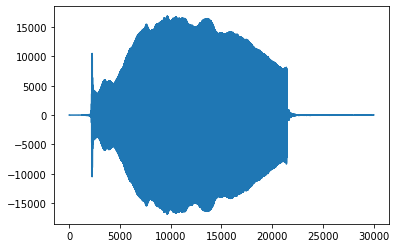

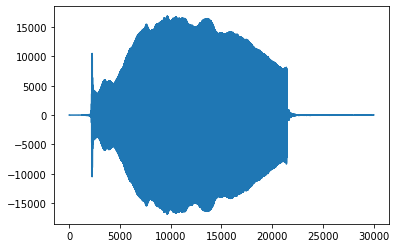

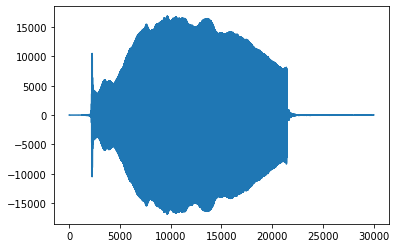

	 Calculating the impulse responses of the right stream


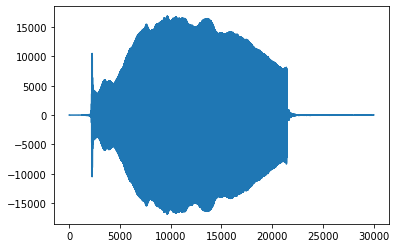

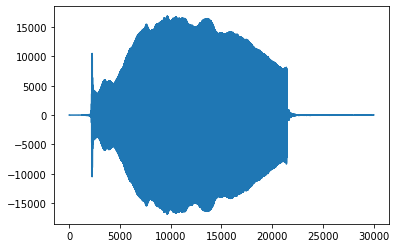

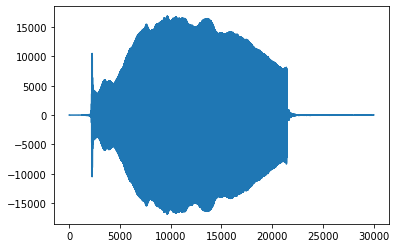

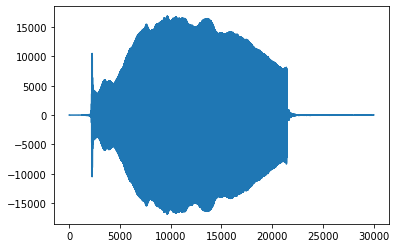

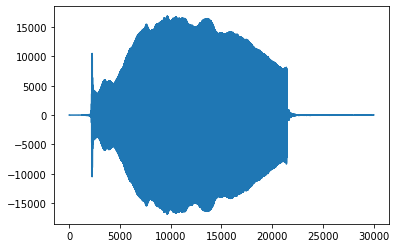

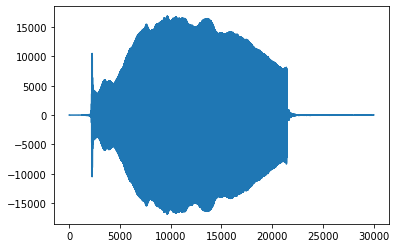

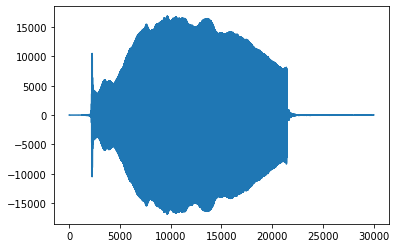

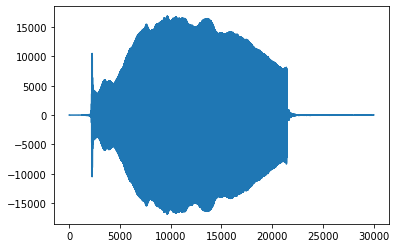

 33%|███▎      | 1/3 [00:06<00:12,  6.31s/it]

Calculating impulse responses from audio file 20210714_191904_156.wav
	 Calculating the impulse responses of the left stream


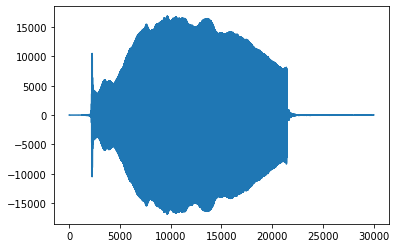

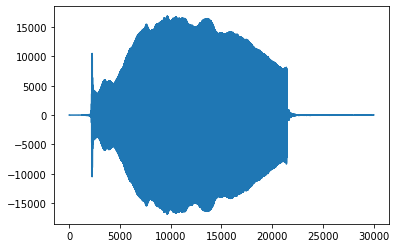

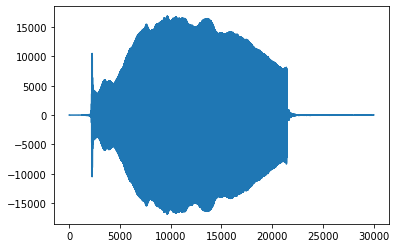

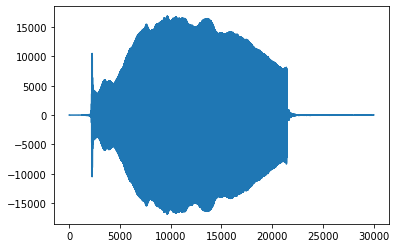

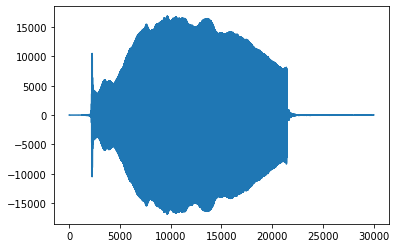

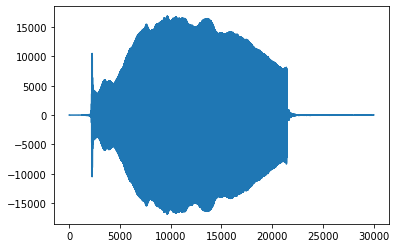

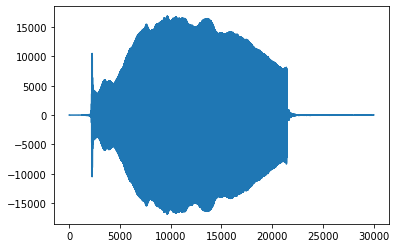

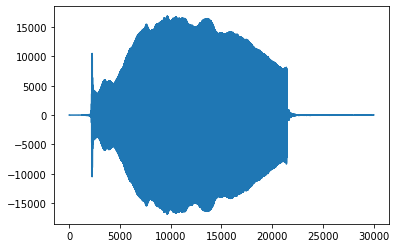

	 Calculating the impulse responses of the right stream


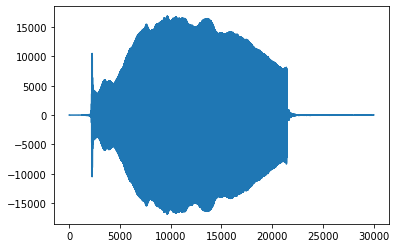

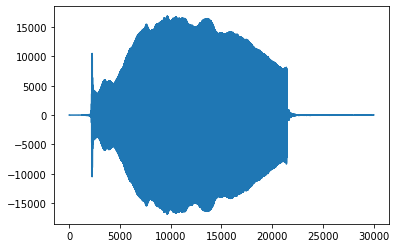

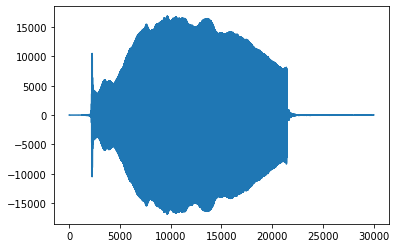

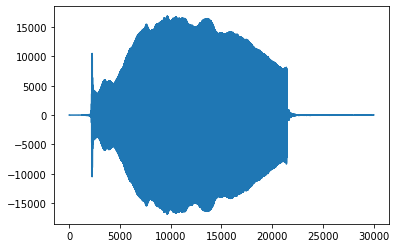

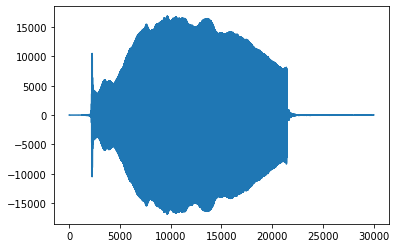

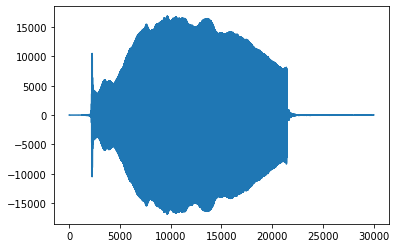

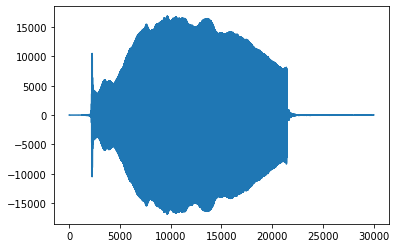

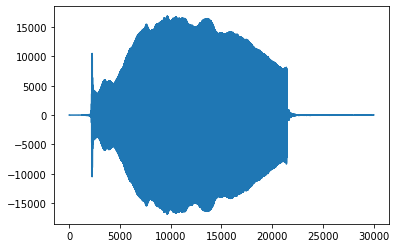

 67%|██████▋   | 2/3 [00:12<00:06,  6.26s/it]

Calculating impulse responses from audio file 20210714_191904_156.wav
	 Calculating the impulse responses of the left stream


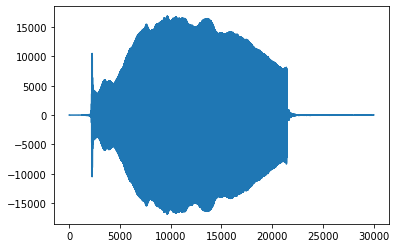

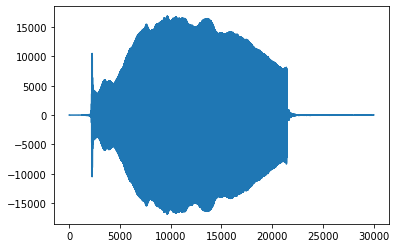

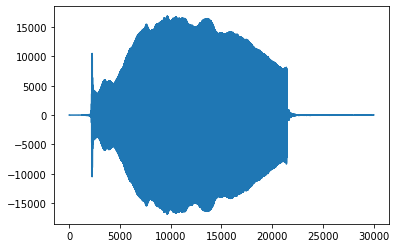

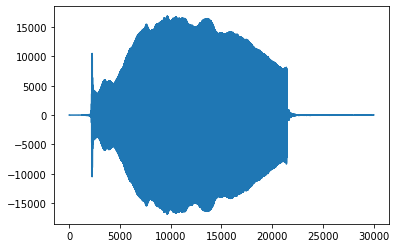

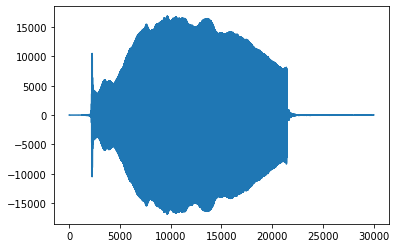

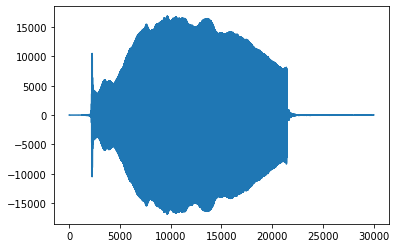

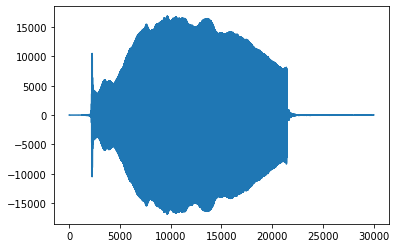

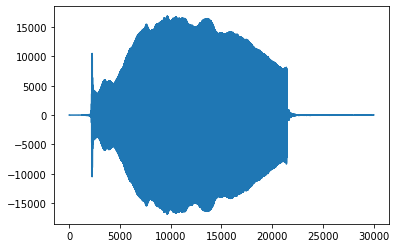

	 Calculating the impulse responses of the right stream


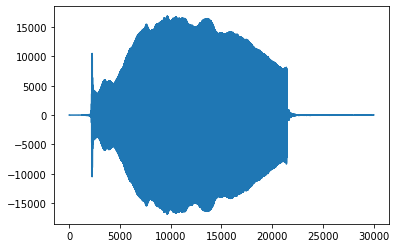

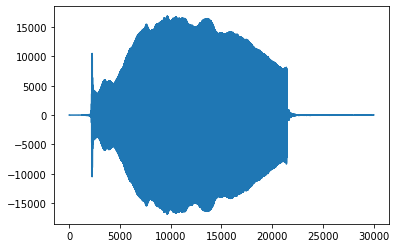

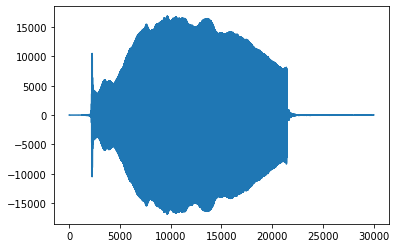

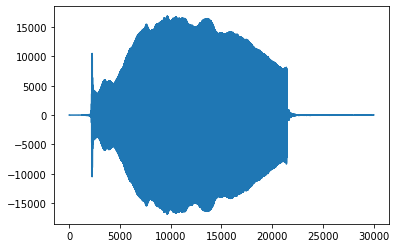

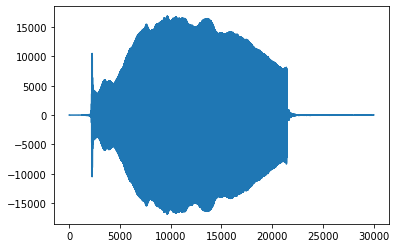

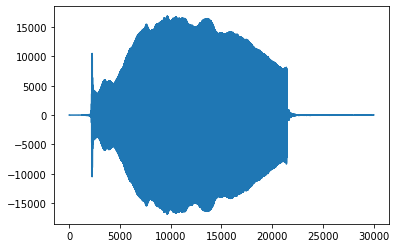

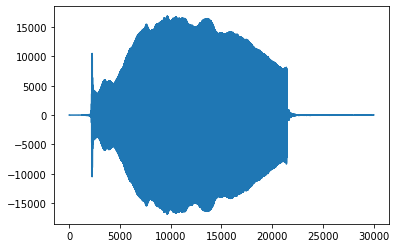

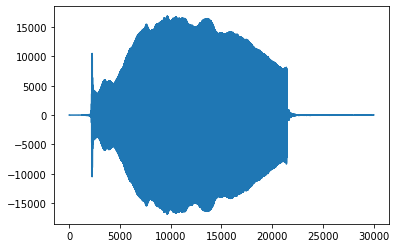

100%|██████████| 3/3 [00:18<00:00,  6.26s/it]


In [218]:
from tqdm import tqdm
from pathlib import Path
import gc
gc.enable()
count = 0
for ss in tqdm(selected_session):
    #print(mem())
    for audio_file in wav_filelist:
        if datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') >= ss[0] and datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') < ss[1]:
            audio_name = os.path.splitext(audio_file)[0]
            samplerate, data = wavfile.read(stereo_file_path + audio_file)
            data_left = data[:, 0]
            data_right = data[:, 1]
            break
    #if audio_file == "20210310_155757_416.wav":
    #    continue
    #print("|" + "*"*(count+1) + ' '*(len(selected_session)-1-count)+ "| " +str(format(round((count+1)/len(selected_session))*100,'.3f')) + "% is complete..." ,end="\r")

    print("Calculating impulse responses from audio file " + audio_file)
    
    for aud_t in aud_timestamps:
        audio_start, audio_end = calc_start_end(aud_t)
        if (audio_start) >= ss[0] and (audio_start) < ss[1]:
            break
    
    ss_sweep_timestamps = []
    for sw in sweep_timestamps:
        if sw >= ss[0] and sw < ss[1]:
            ss_sweep_timestamps.append(sw)
    
    
    for data in [data_left,data_right]:
        corr = []
        corr_raw = []
        if (data == data_left).all():
            stream = "left"
        if (data == data_right).all():
            stream = "right"
            
        data = filter_signal(data)
        
        print("\t Calculating the impulse responses of the " + stream + " stream")
        norm_data = data #if add normalize_data(data) if it is necessary to normalize the data before calculating the impulse response
        
        generated_sweep = generate_sweep()

        if samplerate == 192000:
            start = 20000#45000
        if samplerate == 96000:
            start = 35000#35000
        if samplerate == 48000:
            start = 10000
            
        my_file_ir = Path("processed/mfccs/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
        my_file_ir_raw = Path("processed/spectra/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
        #if my_file_ir.is_file() and my_file_ir_raw.is_file():
           # print("\t \t File already exists...")
            #continue
        #else:       
        for ss_sw in ss_sweep_timestamps:
            sweep_sample = int((ss_sw - audio_start).total_seconds()*samplerate)
            #print(sweep_sample)

            if samplerate == 96000:
                sweep = norm_data[sweep_sample - start:sweep_sample]#norm_data[sweep_sample - 11400:sweep_sample-6990]
            if samplerate == 192000:
                sweep =norm_data[sweep_sample+25000:sweep_sample+55000]#for s20+ ultra norm_data[sweep_sample:sweep_sample+start]#for note s20
            #print("Generated length = ", len(generated_sweep))
            #print("Recorded sweep length = ", len(sweep))
            #plt.figure(figsize=(30,10))
            plt.plot(sweep)
            plt.show()

            if sweep.size>0:
                conv = np.correlate(sweep,generated_sweep[::1],'same')
                conv_cut = conv[conv.argmax():]
                envelop = calc_envelop(conv_cut)
                #envelop2 = get_envelop(conv_cut)
                corr_raw.append(conv_cut)
                corr.append(envelop)
        nc_raw = []
        nc = []
        for i in corr_raw:
            nc_raw.append(i[:6000]/max(i[:6000]))
        for i in corr:
            nc.append(i[:6000]/max(i[:6000]))
            
        trimmed_ir_raw = pd.DataFrame(nc_raw)
        trimmed_ir = pd.DataFrame(nc)
        
        mfcc_feat = extract_mfcc_feat(trimmed_ir_raw)
        spec_feat = extract_spectral_feat(trimmed_ir_raw)
        
        make_folder_structure()
        
        #Save data
        mfcc_feat.to_csv("processed/mfccs/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        spec_feat.to_csv("processed/spectra/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        
        gc.collect()
        #break
    count = count + 1
    #break

In [213]:
mfcc_feat

,0,1,2,3,4,5,6,7,8,9,...,362,363,364,365,366,367,368,369,370,371
0,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
1,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
2,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
3,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
4,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
5,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
6,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297
7,-72.618469,-41.311486,-63.748857,-46.844082,-38.027135,-3.500309,27.11265,65.578913,90.818285,108.646938,...,29.392898,21.062702,-16.578478,-51.749239,-94.43264,-120.827363,-135.039635,-125.802346,-101.81655,-64.503297


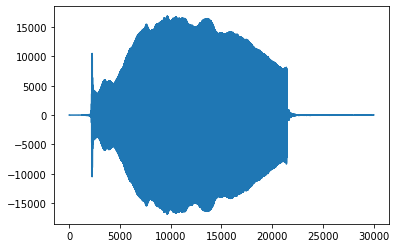

In [215]:
plt.plot(sweep)

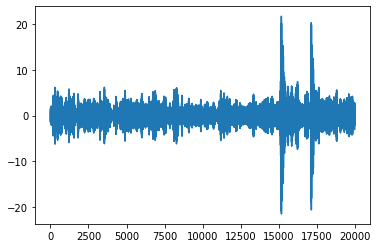

In [158]:
plt.plot(norm_data[sweep_sample - start:sweep_sample])

In [159]:
norm_data[sweep_sample+25000:sweep_sample+55000]

array([  0.29986545,   1.62052085,   2.28096695, ..., -17.134827  ,
       -10.2183472 ,   0.61643289])

<AxesSubplot:>

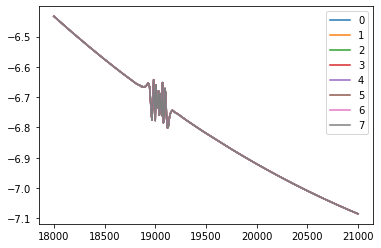

In [214]:
spec_feat.T.plot()

In [58]:
wav_filelist

[]

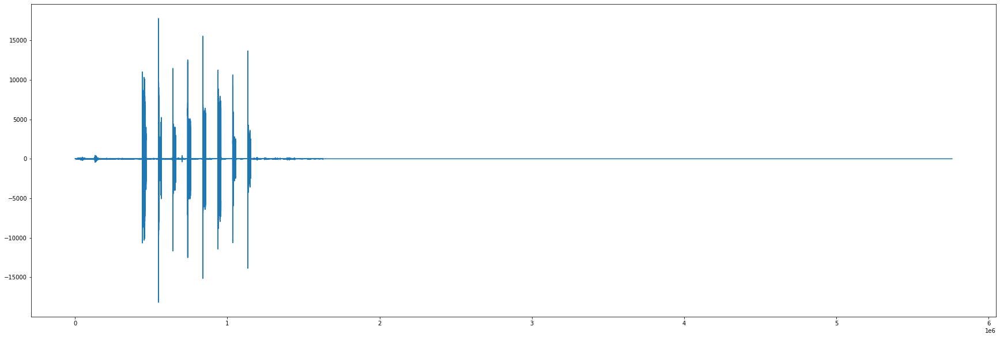

In [272]:
plt.figure(figsize=(30,10))
plt.plot(norm_data)

In [58]:
sweep_timestamps

[datetime.datetime(2021, 3, 10, 15, 25, 28, 673000),
 datetime.datetime(2021, 3, 10, 15, 25, 29, 283000),
 datetime.datetime(2021, 3, 10, 15, 25, 29, 793000),
 datetime.datetime(2021, 3, 10, 15, 25, 30, 297000),
 datetime.datetime(2021, 3, 10, 15, 25, 30, 800000),
 datetime.datetime(2021, 3, 10, 15, 25, 31, 305000),
 datetime.datetime(2021, 3, 10, 15, 25, 31, 810000),
 datetime.datetime(2021, 3, 10, 15, 25, 32, 314000),
 datetime.datetime(2021, 3, 10, 15, 25, 50, 743000),
 datetime.datetime(2021, 3, 10, 15, 25, 51, 271000),
 datetime.datetime(2021, 3, 10, 15, 25, 51, 776000),
 datetime.datetime(2021, 3, 10, 15, 25, 52, 281000),
 datetime.datetime(2021, 3, 10, 15, 25, 52, 786000),
 datetime.datetime(2021, 3, 10, 15, 25, 53, 293000),
 datetime.datetime(2021, 3, 10, 15, 25, 53, 797000),
 datetime.datetime(2021, 3, 10, 15, 25, 54, 305000),
 datetime.datetime(2021, 3, 10, 15, 26, 17, 324000),
 datetime.datetime(2021, 3, 10, 15, 26, 17, 845000),
 datetime.datetime(2021, 3, 10, 15, 26, 18, 35

In [59]:
session_list

[[datetime.datetime(2021, 3, 10, 15, 25, 26, 159000),
  datetime.datetime(2021, 3, 10, 15, 25, 39, 816000)],
 [datetime.datetime(2021, 3, 10, 15, 25, 48, 350000),
  datetime.datetime(2021, 3, 10, 15, 25, 58, 158000)],
 [datetime.datetime(2021, 3, 10, 15, 26, 14, 684000),
  datetime.datetime(2021, 3, 10, 15, 26, 25, 36000)],
 [datetime.datetime(2021, 3, 10, 15, 26, 36, 351000),
  datetime.datetime(2021, 3, 10, 15, 26, 45, 720000)],
 [datetime.datetime(2021, 3, 10, 15, 26, 59, 160000),
  datetime.datetime(2021, 3, 10, 15, 27, 8, 845000)],
 [datetime.datetime(2021, 3, 10, 15, 27, 20, 548000),
  datetime.datetime(2021, 3, 10, 15, 27, 30, 566000)],
 [datetime.datetime(2021, 3, 10, 15, 29, 0, 353000),
  datetime.datetime(2021, 3, 10, 15, 29, 9, 829000)],
 [datetime.datetime(2021, 3, 10, 15, 29, 25, 107000),
  datetime.datetime(2021, 3, 10, 15, 29, 34, 689000)],
 [datetime.datetime(2021, 3, 10, 15, 29, 41, 711000),
  datetime.datetime(2021, 3, 10, 15, 29, 51, 347000)],
 [datetime.datetime(202

In [145]:
data_right

array([   0,    0,    0, ..., -586, -504, -544], dtype=int16)

In [146]:
data_left.all() == data_right.all()

True

In [107]:
len(ss_sweep_timestamps)

50

In [108]:
audio_file

'20210302_182330_810.wav'

In [115]:
ss_sw - audio_start

datetime.timedelta(-1, 85546, 978000)

In [116]:
ss_sw

datetime.datetime(2021, 3, 2, 18, 23, 46, 678000)

In [113]:
audio_start

datetime.datetime(2021, 3, 2, 18, 37, 59, 700000)

In [55]:
from tqdm import tqdm
print("Sample rate = ", samplerate)
corr1 = []
corr2 = []

data = data_left
#data = filter_signal(data)#bandpass filter
norm_data = data#normalize_data(data)

#generate sweep
generated_sweep = generate_sweep()

if samplerate == 192000:
    start = 20000#45000
if samplerate == 96000:
    start = 35000#35000
if samplerate == 48000:
    start = 10000


    
for sw in tqdm(sweep_timestamps):
    audio_start, audio_end = calc_start_end(sw)

    sweep_sample = int((sw - audio_start).total_seconds()*samplerate)
    print(sweep_sample)
    
    if samplerate == 96000:
        sweep = norm_data[sweep_sample - start:sweep_sample]#norm_data[sweep_sample - 11400:sweep_sample-6990]
    if samplerate == 192000 :
        sweep =norm_data[sweep_sample+25000:sweep_sample+55000]#for s20+ ultra norm_data[sweep_sample:sweep_sample+start]#for note s20
    print("Generated length = ", len(generated_sweep))
    print("Recorded sweep length = ", len(sweep))
    
    plt.figure(figsize=(30,10))
    plt.plot(sweep)
    plt.show()
    #conv = convolution(sweep,generated_sweep)
    conv = np.correlate(sweep,generated_sweep[::1],'same')
    #conv = np.convolve(sweep,generated_sweep[::1],'full')
    #conv = signal.correlate(sweep,generated_sweep, mode='full') / 128
    
    conv_cut = conv[conv.argmax():]
    #conv_cut = conv[len(generated_sweep):]
    
    envelop1 = calc_envelop(conv_cut)
    #envelop2 = get_envelop(conv_cut)
    corr1.append(envelop1)
    #corr2.append(envelop2)
    plt.figure(figsize=(30,10))
    plt.plot(conv)
    plt.show()
    #break
    
# nc = []
# for i in corr1:
#     nc.append(i[:2000]/max(i[:2000]))

  0%|          | 0/8 [00:00<?, ?it/s]

Sample rate =  192000


AttributeError: 'datetime.datetime' object has no attribute 'split'

In [96]:
sweep_timestamps

[datetime.datetime(2021, 3, 2, 18, 23, 33, 520000),
 datetime.datetime(2021, 3, 2, 18, 23, 34, 40000),
 datetime.datetime(2021, 3, 2, 18, 23, 34, 546000),
 datetime.datetime(2021, 3, 2, 18, 23, 35, 51000),
 datetime.datetime(2021, 3, 2, 18, 23, 35, 558000),
 datetime.datetime(2021, 3, 2, 18, 23, 36, 63000),
 datetime.datetime(2021, 3, 2, 18, 23, 36, 571000),
 datetime.datetime(2021, 3, 2, 18, 23, 37, 76000),
 datetime.datetime(2021, 3, 2, 18, 23, 37, 580000),
 datetime.datetime(2021, 3, 2, 18, 23, 38, 88000),
 datetime.datetime(2021, 3, 2, 18, 23, 38, 592000),
 datetime.datetime(2021, 3, 2, 18, 23, 39, 96000),
 datetime.datetime(2021, 3, 2, 18, 23, 39, 604000),
 datetime.datetime(2021, 3, 2, 18, 23, 40, 109000),
 datetime.datetime(2021, 3, 2, 18, 23, 40, 614000),
 datetime.datetime(2021, 3, 2, 18, 23, 41, 119000),
 datetime.datetime(2021, 3, 2, 18, 23, 41, 624000),
 datetime.datetime(2021, 3, 2, 18, 23, 42, 130000),
 datetime.datetime(2021, 3, 2, 18, 23, 42, 635000),
 datetime.datetime

In [160]:
nc = []
for i in corr:
    nc.append(i[:6000]/max(i[:6000]))#max(i[:6000]))

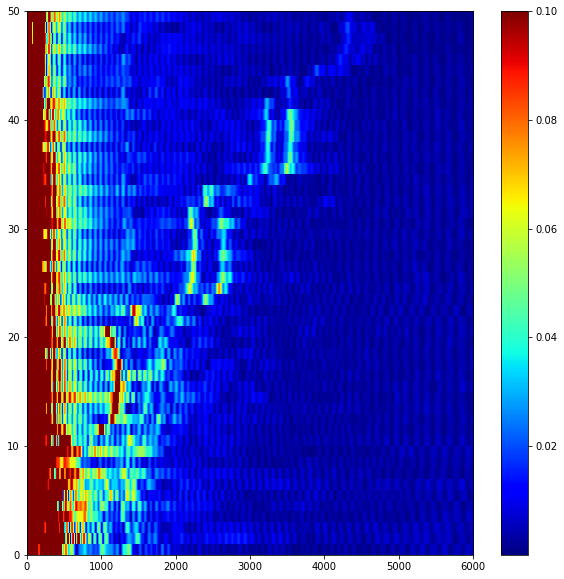

In [161]:
plt.figure(figsize=(10,10))
plt.imshow(pd.DataFrame(nc),cmap='jet', vmax=0.1, interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

In [957]:
trimmed_ir = pd.DataFrame(nc)

In [958]:
selected_session[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3]

'20210224_18:08:37.805-20210224_18:09:11.272'

In [959]:
trimmed_ir.to_csv("processed/ir/" + selected_session[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)  

In [960]:
if not os.path.exists("processed/" + "/ir"):
    os.mkdir("processed/" + "/ir",0o777)
    
if not os.path.exists("processed/" + "/ir/" + date):
    os.mkdir("processed/" + "/ir/" + date,0o777)

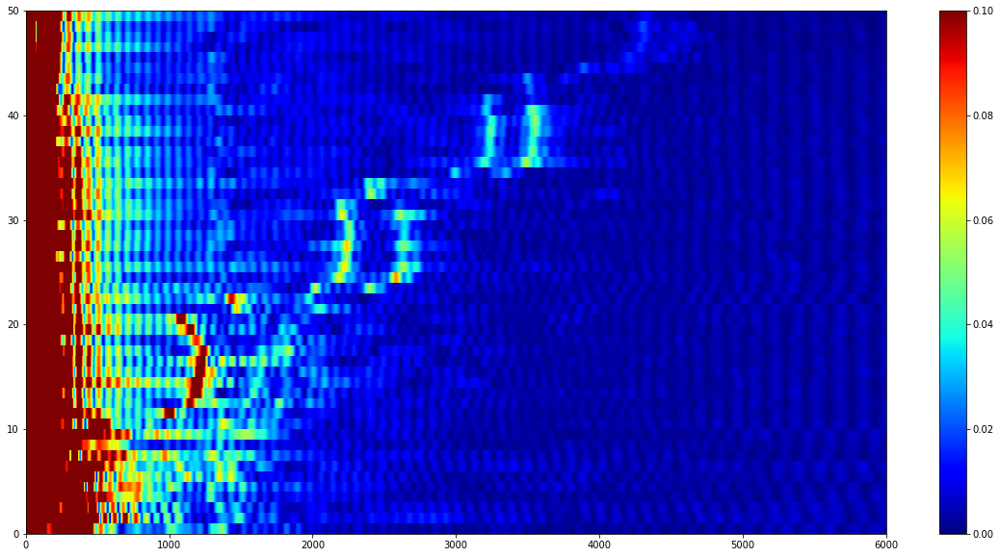

In [162]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, vmin=0.0, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

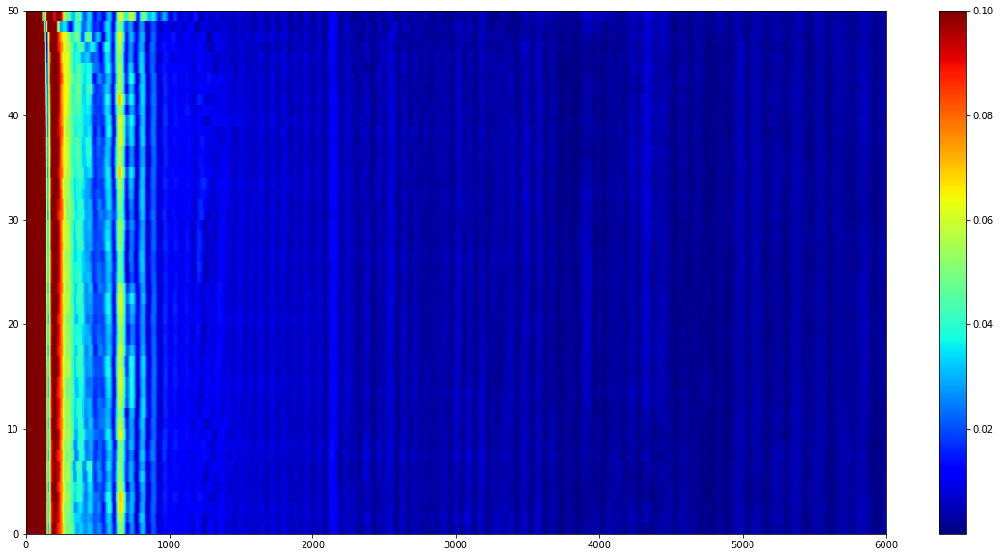

In [826]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

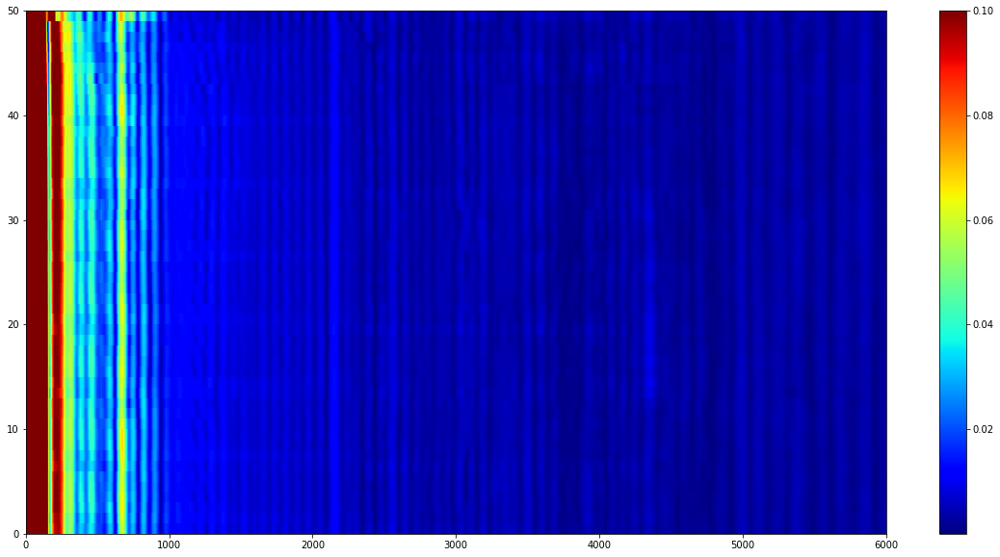

In [780]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

<Figure size 432x288 with 0 Axes>

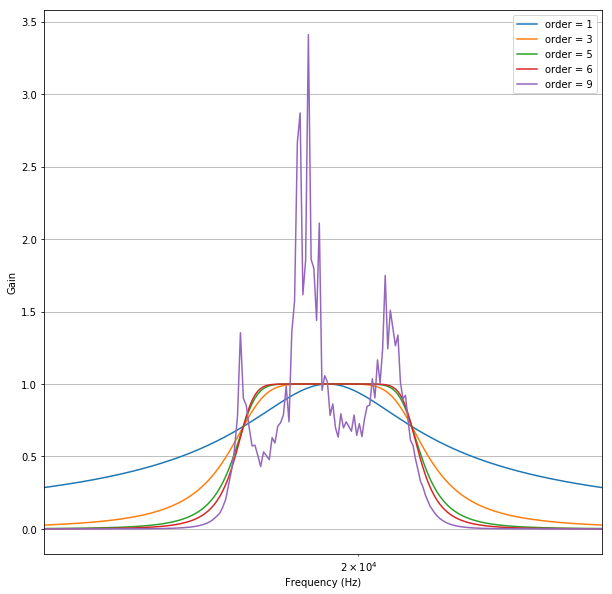

In [732]:
from scipy.signal import freqz  
# Sample rate and desired cutoff frequencies (in Hz).
fs = 192000
# Plot the frequency response for a few different orders.
plt.figure(1)
plt.figure(figsize=(10,10))
plt.clf()
res = []
for order in [1, 3, 5, 6, 9]:
    b, a = butter_bandpass(18000, 21000, fs, order=order)
    w, h = freqz(b, a, worN=2000)#np.logspace(-4, 3, 2000))
    plt.semilogx((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order) 
    res.append(h)
    #plt.plot(h)
    #fig,ax = subplots()
    #plt.scatter(h.real,h.imag)
    #plt.show()
plt.xlim([15000,25000])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.grid(True)
plt.legend(loc='best')

# plt.figure(2)
# plt.clf()
# for order in [1, 3, 5, 6, 9]:
#     b, a = butter_bandpass(18000, 21000, fs, order=order)
#     w, h = freqz(b, a, worN=2000)#np.logspace(-4, 3, 2000))
#     plt.semilogx((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)  
# plt.xlabel('Frequency (Hz)')
# plt.ylabel('Gain')
# plt.grid(True)
# plt.legend(loc='best')

plt.show()

In [156]:
data_left

array([  0,   0,   0, ...,  66, 431, 114], dtype=int16)

In [157]:
data_right

array([  0,   0,   0, ...,  90, 466, 135], dtype=int16)

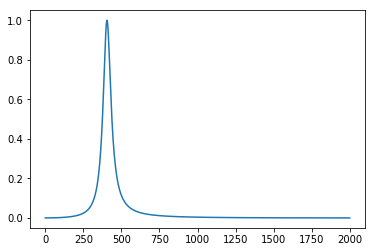

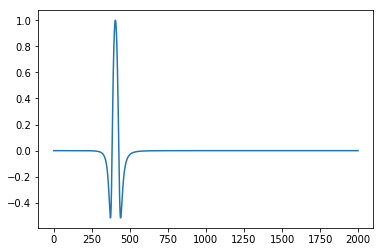

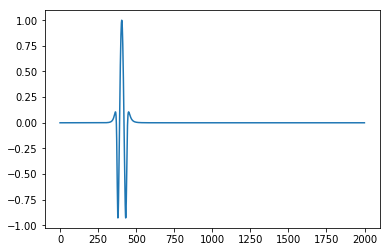

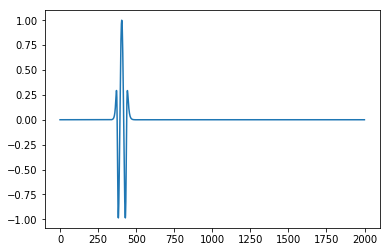

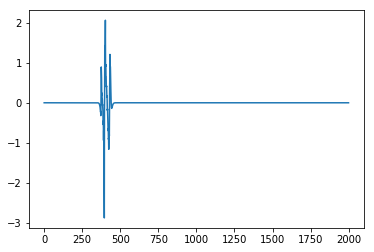

In [2489]:
for x in res:
    plt.plot(x)
    plt.show()

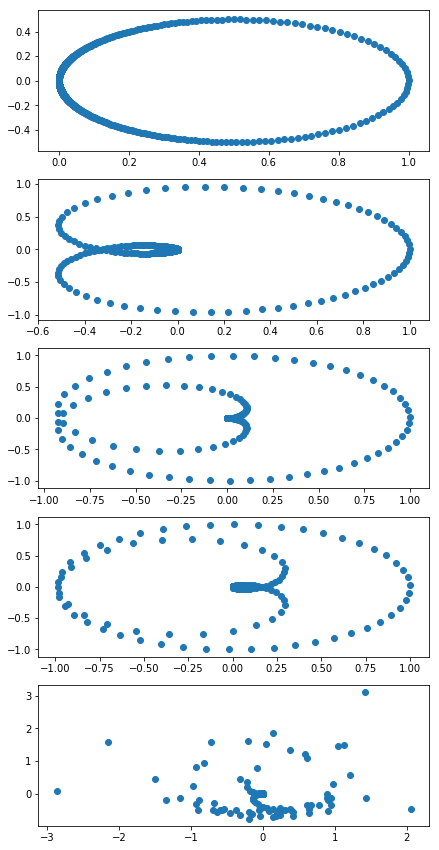

In [2495]:
fig,ax = subplots(5,figsize=(7,15))
c=0
for x in res:
    ax[c].scatter(x.real,x.imag)
    c=c+1

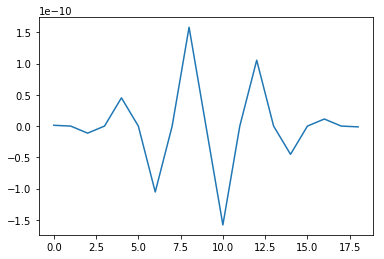

In [2472]:
plt.plot(b)

In [2475]:
h

array([ 1.73037895e-23+0.00000000e+00j, -1.97892972e-23+9.28845532e-25j,
       -1.60759308e-22-1.96305154e-26j, ...,
       -1.03571912e-31-2.79395315e-33j, -3.36011316e-31+1.66297890e-33j,
       -4.13759667e-32-1.99938279e-33j])

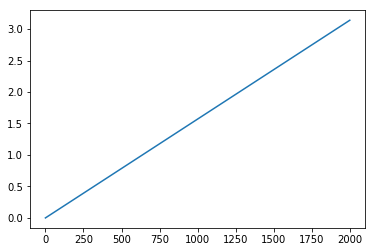

In [2477]:
plt.plot(w) #[0, pi) (radians/sample)

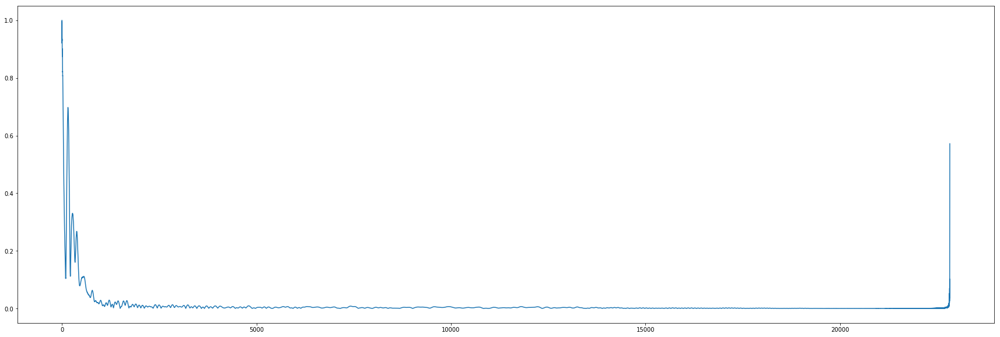

Error in callback <function flush_figures at 0x7f50eae1ae18> (for post_execute):


KeyboardInterrupt: 

In [2356]:
if not os.path.exists(visual_path + date):
    os.mkdir(visual_path + date)

if not os.path.exists(visual_path + date + '/' + audio_name):
    os.mkdir(visual_path + date + '/' + audio_name,0o777)
    
if not os.path.exists(visual_path + date + '/' + audio_name + '/' + 'left'):
    os.mkdir(visual_path + date + '/' + audio_name + '/' + 'left',0o777)
    
if not os.path.exists(visual_path + date + '/' + audio_name + '/' + 'right'):
    os.mkdir(visual_path + date + '/' + audio_name + '/' + 'right',0o777)
    
# if not os.path.exists(visual_path + date + sessions[int(session)][0] + '-' + sessions[int(session)][1]):
#     os.mkdir(visual_path + date + sessions[int(session)][0] + '-' + sessions[int(session)][1],0o777)
count = 0    
for i in corr1:
    count = count + 1
    plt.figure(figsize=(30,10))
    plt.plot((i/max(i)))
    #savefig(visual_path + date + '/' + audio_name + '/' + 'left' + '/' +  str(count) +'.png')

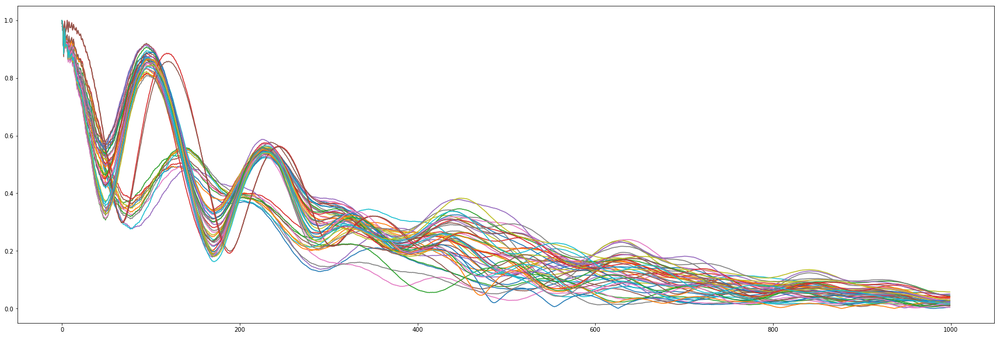

In [1935]:
norm_corr = []
plt.figure(figsize=(30,10))
axes = plt.subplot()

for c in corr1:
    axes.plot(c[:1000]/max(c[:1000]))
    norm_corr.append(c/max(c))
    #plt.plot(c)

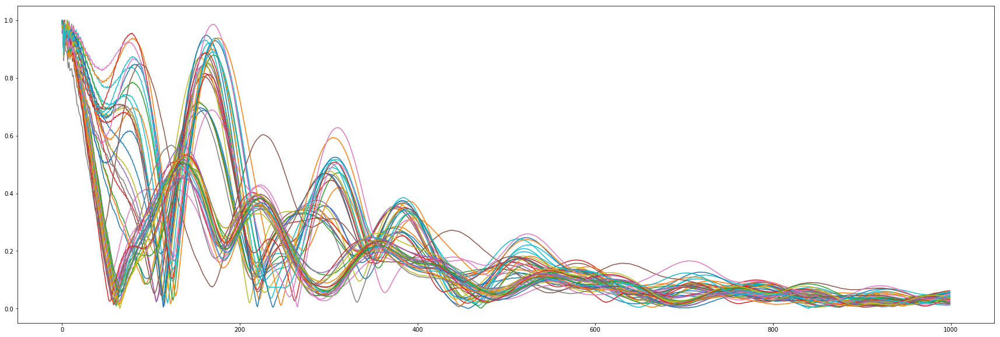

In [1839]:
norm_corr = []
plt.figure(figsize=(30,10))
axes = plt.subplot()

for c in corr1:
    axes.plot(c[:1000]/max(c[:1000]))
    norm_corr.append(c/max(c))
    #plt.plot(c)

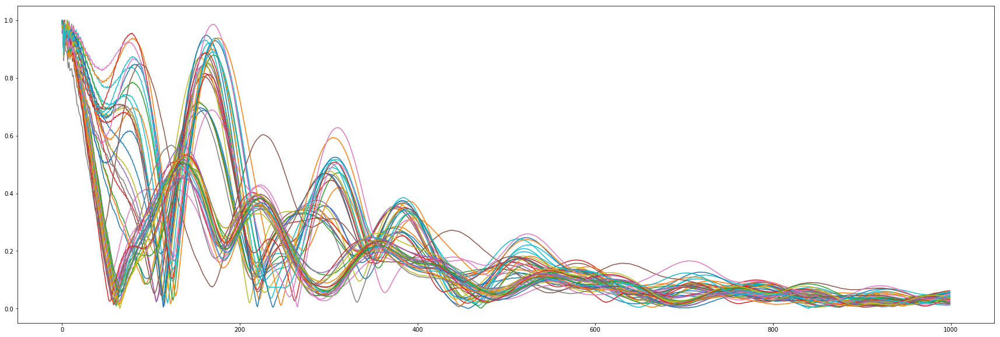

In [1840]:
norm_corr = []
plt.figure(figsize=(30,10))
axes = plt.subplot()

for c in corr1:
    axes.plot(c[:1000]/max(c[:1000]))
    norm_corr.append(c/max(c))
    #plt.plot(c)

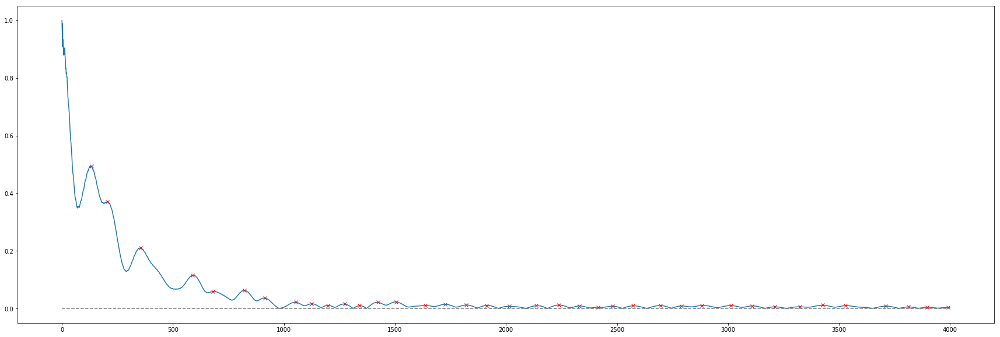

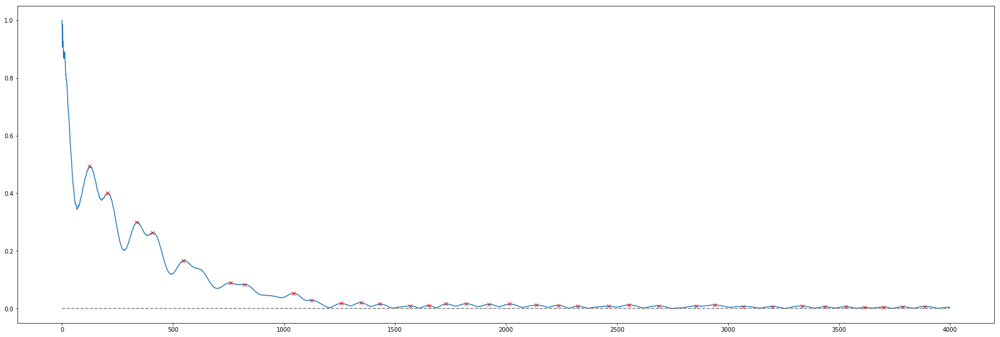

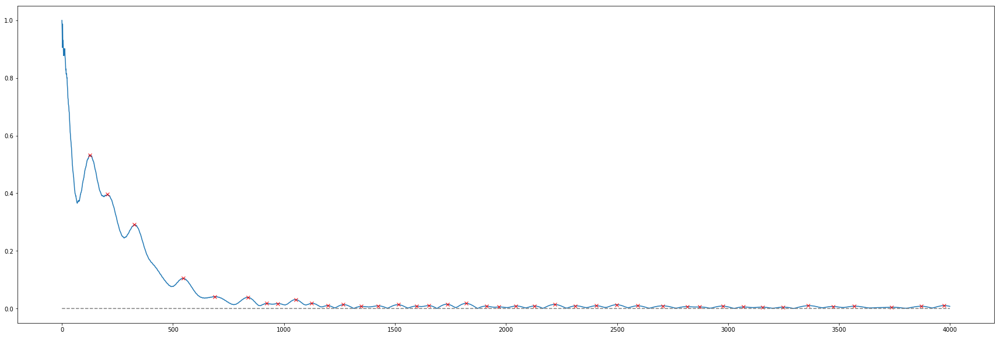

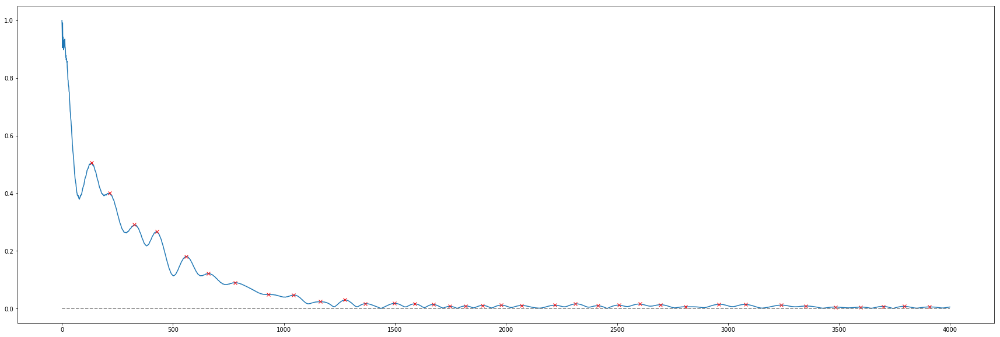

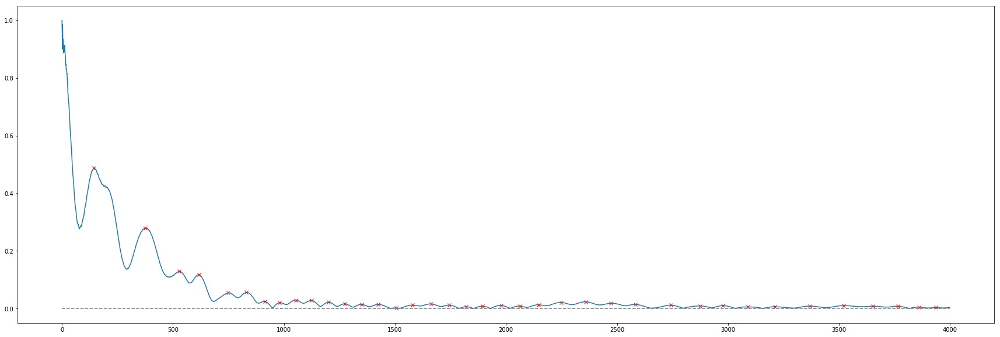

...

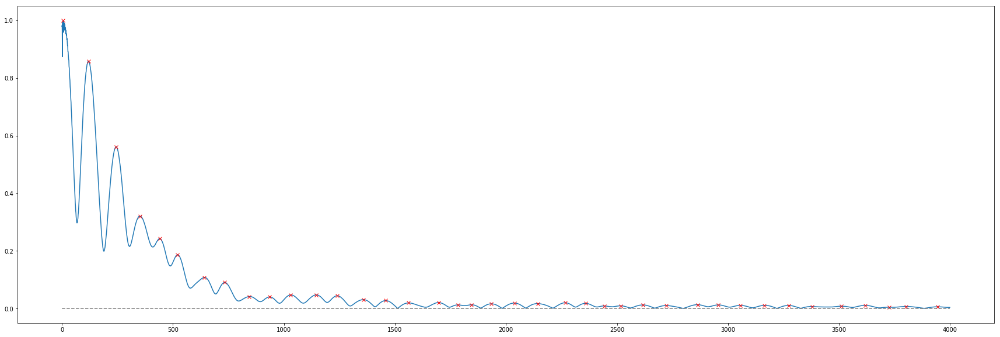

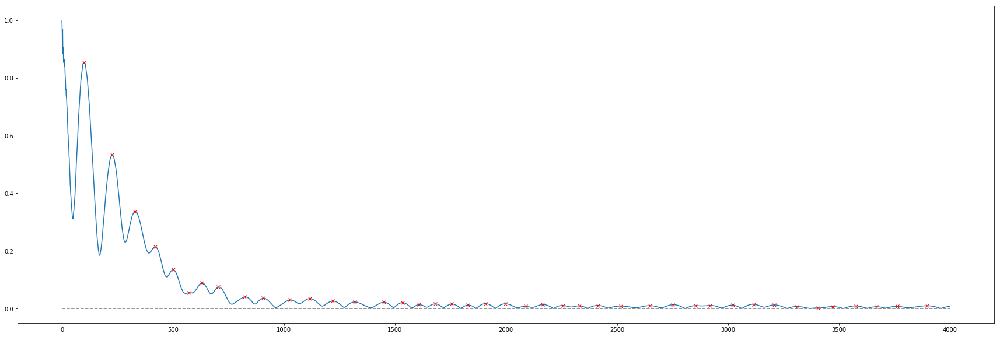

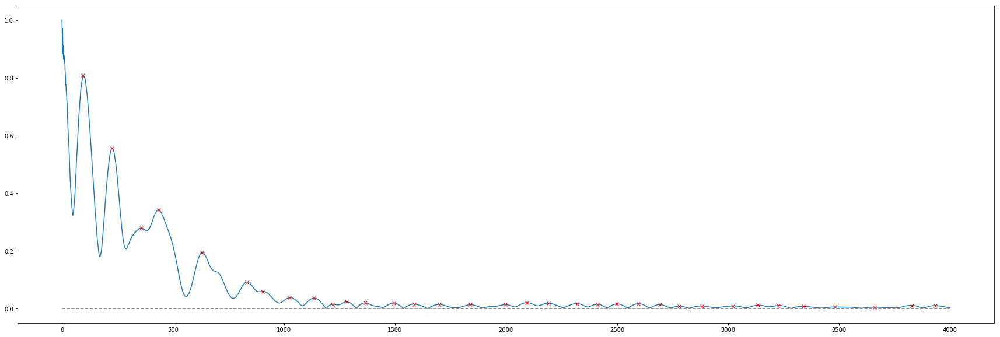

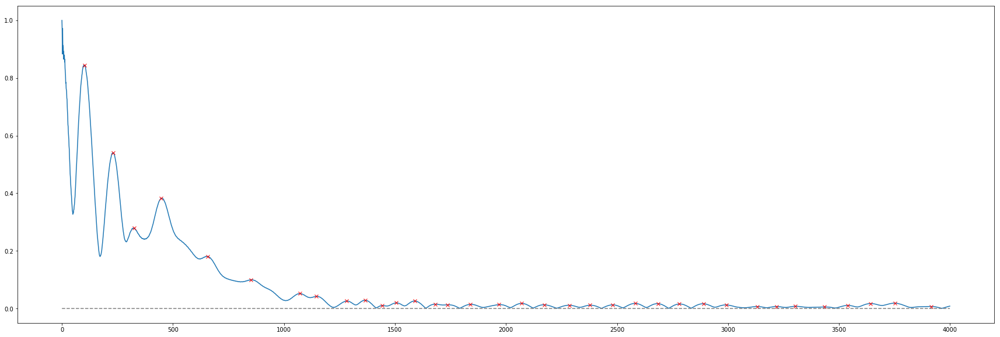

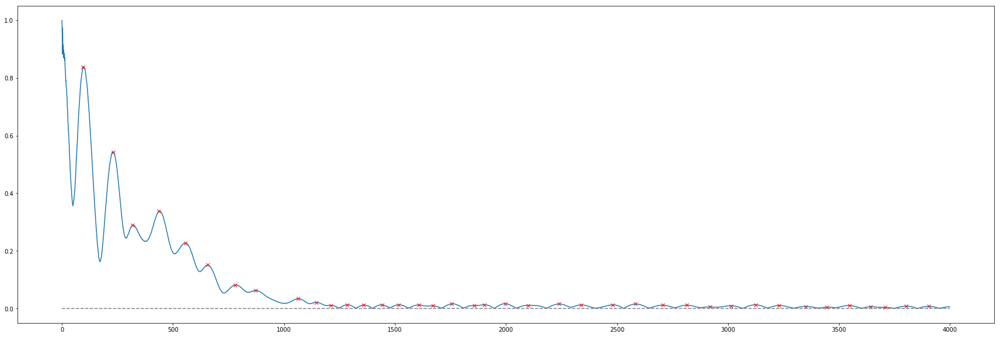

In [2720]:
from scipy.misc import electrocardiogram
from scipy.signal import find_peaks

for x in norm_corr:
    x = x[:4000]#nc[:1000]#norm_corr[0][:1000]#electrocardiogram()[2000:4000]
    peaks, _ = find_peaks(x, height=0,width=5)
    plt.figure(figsize=(30,10))
    plt.plot(x)
    plt.plot(peaks, x[peaks], "x", color="red")
    plt.plot(np.zeros_like(x), "--", color="gray")
    plt.show()

In [1341]:
peaks

array([ 49,  98, 143, 171, 210, 250, 287, 347, 383, 421, 463, 505, 547,
       589, 627, 668, 708, 743, 785, 821, 849, 889, 927, 965])

In [1342]:
peaks

array([ 49,  98, 143, 171, 210, 250, 287, 347, 383, 421, 463, 505, 547,
       589, 627, 668, 708, 743, 785, 821, 849, 889, 927, 965])

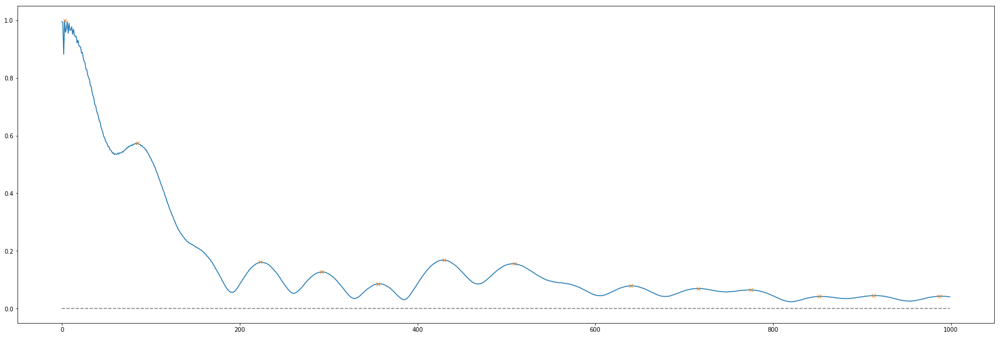

In [1544]:
x = norm_corr[1][:1000]#electrocardiogram()[2000:4000]
peaks, _ = find_peaks(x, height=0,width=5)
plt.figure(figsize=(30,10))
plt.plot(x)
plt.plot(peaks, x[peaks], "x")
plt.plot(np.zeros_like(x), "--", color="gray")
plt.show()

# Average all the impulse responses in the selected session 

In [2033]:
def detect_peaks(array_avg):
    x = array_avg#norm_corr[0][:1000]#electrocardiogram()[2000:4000]
    peaks, _ = find_peaks(x, height=0,width=5)
    print("Peak samples = ", peaks)
    plt.figure(figsize=(30,10))
    plt.plot(x)
    plt.plot(peaks, x[peaks], "x", color="red")
    plt.plot(np.zeros_like(x), "--", color="gray")
    plt.show()

In [1942]:
nc = []
for i in norm_corr:
    nc.append(i[:3000])

In [2034]:
array_sum = np.mean(nc, axis=0)
array_avg = array_sum/len(nc)

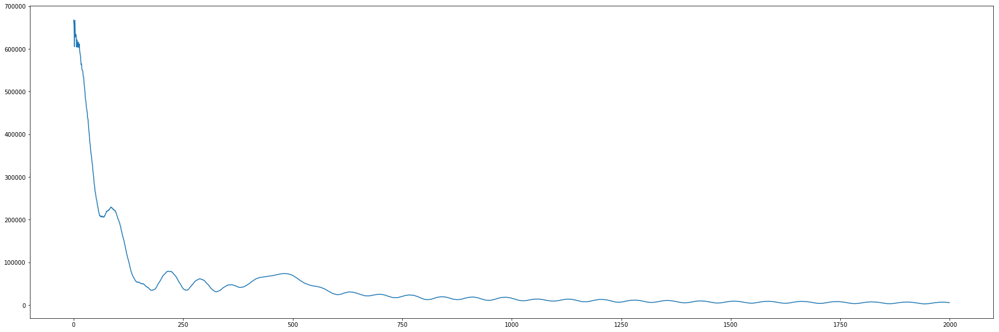

In [2035]:
plt.figure(figsize=(30,10))
plt.plot(array_avg)

Peak samples =  [  82  153  308  378  527  727  767  919  991 1137 1211 1285 1359 1431
 1512 1589 1665 1747 1826 1905 1987 2068 2152 2236 2323 2407 2491 2583
 2669 2761 2855 2947 3041 3135 3229 3323 3417 3529 3633 3727 3839 3953
 4075 4161 4293 4407 4491 4559 4691 4919 5043 5223 5357 5522 5653 5825
 6017 6199 6371 6565 6795 7017 7299 7539 7709 7861 8069 8227 8407 8597
 8873 9189 9423 9593 9869]


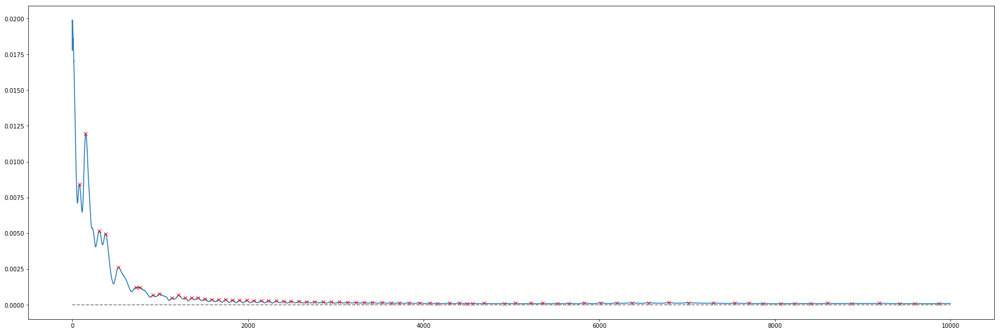

In [1892]:
detect_peaks(array_avg)

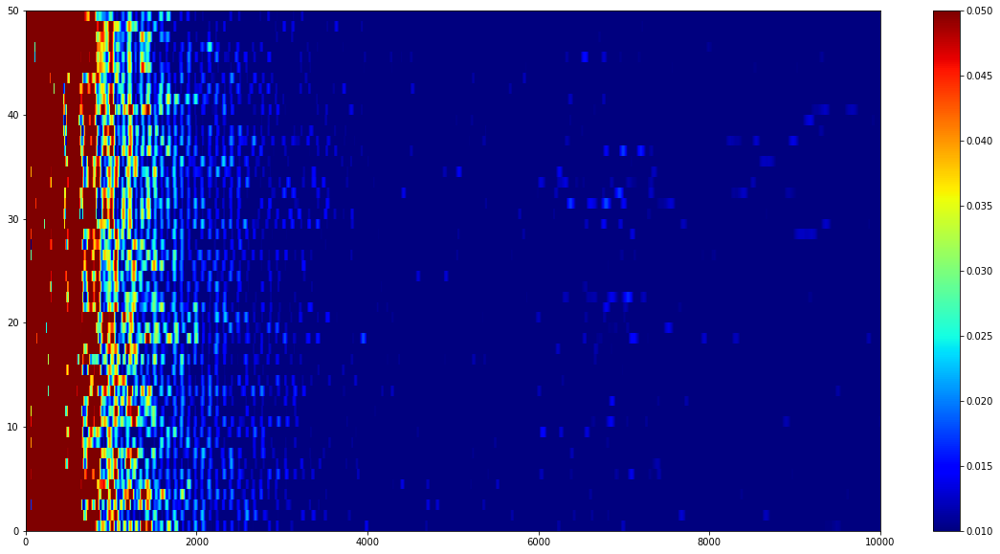

In [1895]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc), cmap='jet', vmax= 0.05, vmin=0.01, interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

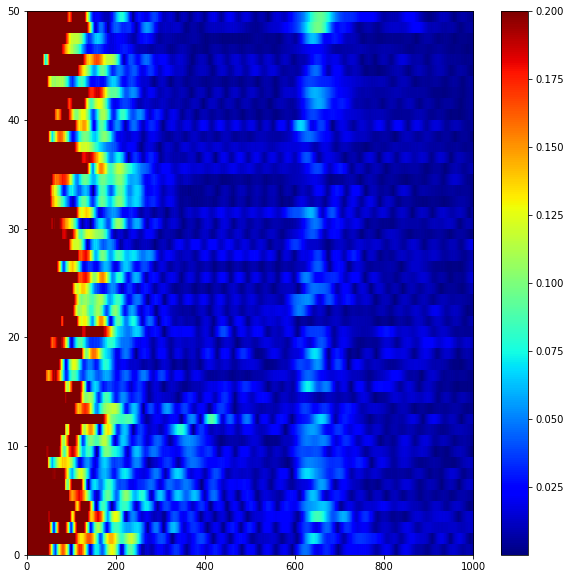

In [1054]:
plt.figure(figsize=(10,10))
plt.imshow(pd.DataFrame(nc), cmap='jet', vmax= 0.2, interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

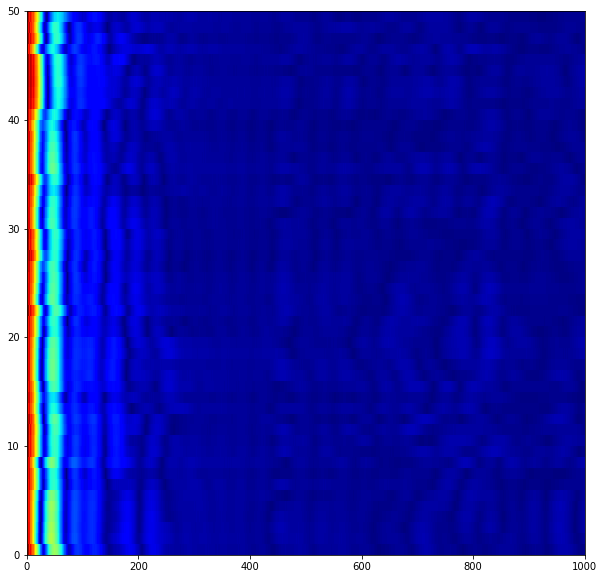

In [360]:
plt.figure(figsize=(10,10))
plt.imshow(pd.DataFrame(nc), cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')

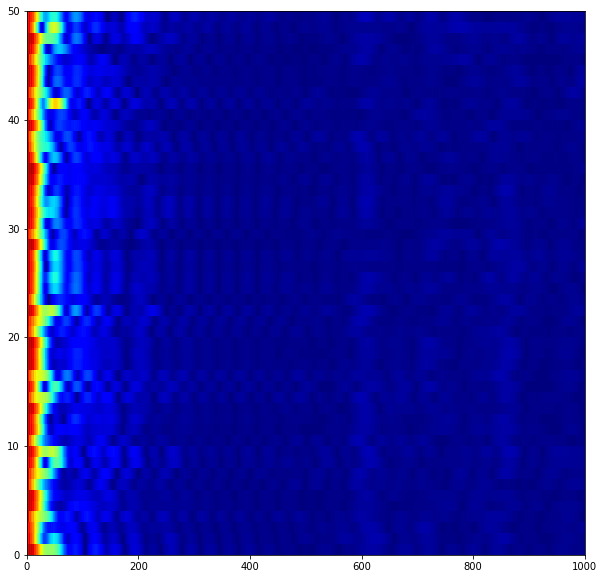

In [417]:
plt.figure(figsize=(10,10))
plt.imshow(pd.DataFrame(nc), cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')

# XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

In [1032]:
audio_start = "20200914_17:54:49.39"
audio_start = datetime.datetime.strptime(audio_start, '%Y%m%d_%H:%M:%S.%f')

In [1033]:
audio_end = "20200914_17:55:21.475"
audio_end = datetime.datetime.strptime(audio_end, '%Y%m%d_%H:%M:%S.%f')

In [1034]:
#Generating a sweep signal
generated_sweep = generate_sweep()

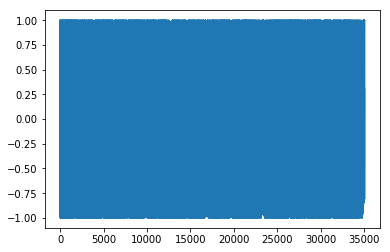

In [2516]:
plt.plot(generated_sweep)

audio_start = datetime.datetime.strptime(audio_name, '%Y%m%d_%H%M%S_%f')

In [2484]:
test_data = norm_data[int((sweep_timestamps[0] - audio_start).total_seconds()*samplerate) - 35000:int((sweep_timestamps[0] - audio_start).total_seconds()*samplerate)]

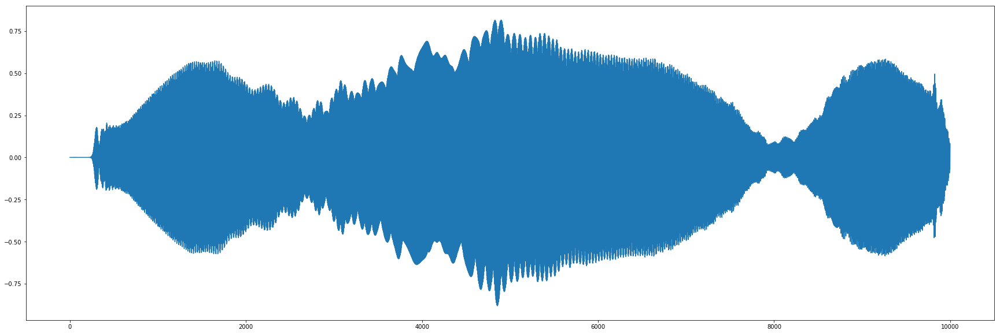

In [2505]:
plt.figure(figsize=(30,10))
plt.plot(test_data[5000:15000])

In [2486]:
test_data = filter_signal(test_data)

In [2506]:
test_conv = np.convolve(generated_sweep[::-1],test_data/max(test_data))#convolution(test_data,generated_sweep)

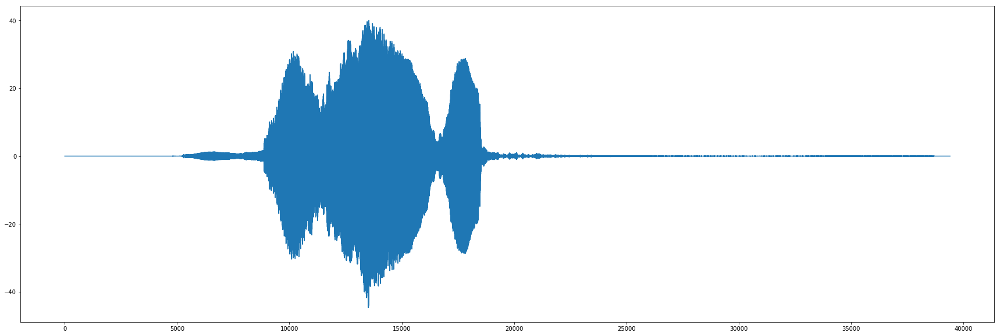

In [2507]:
plt.figure(figsize=(30,10))
plt.plot(test_conv)

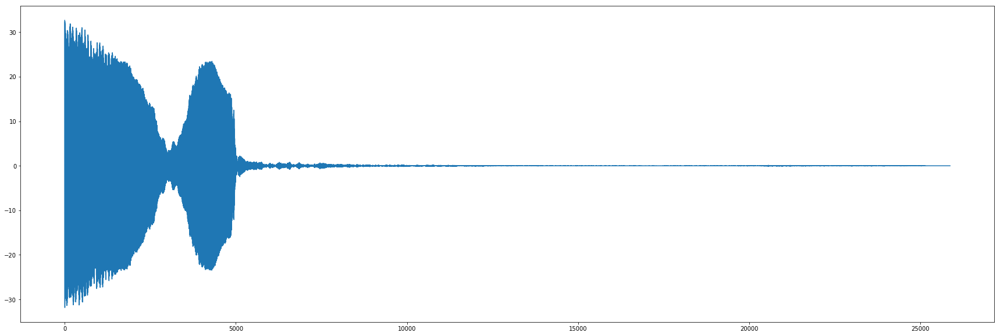

In [2489]:
plt.figure(figsize=(30,10))
plt.plot(test_conv[test_conv.argmax():])

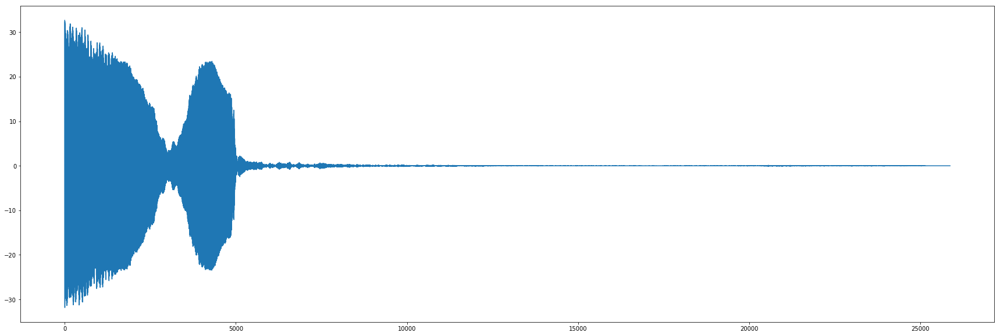

In [2490]:
plt.figure(figsize=(30,10))
plt.plot(test_conv[test_conv.argmax():])

In [2491]:
test_env = calc_envelop(test_conv[test_conv.argmax():])

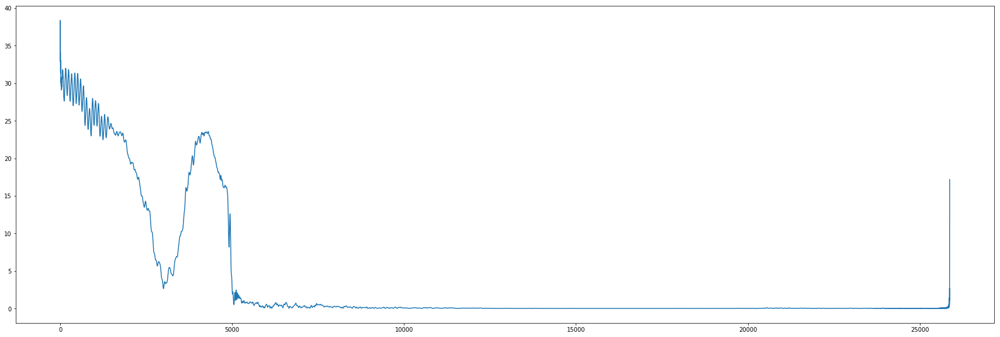

In [2492]:
plt.figure(figsize=(30,10))
plt.plot(test_env)

In [1279]:
db = []
for p in data_left[200000:209000]:
    db.append(20*log10( sqrt(mean(p**2))))

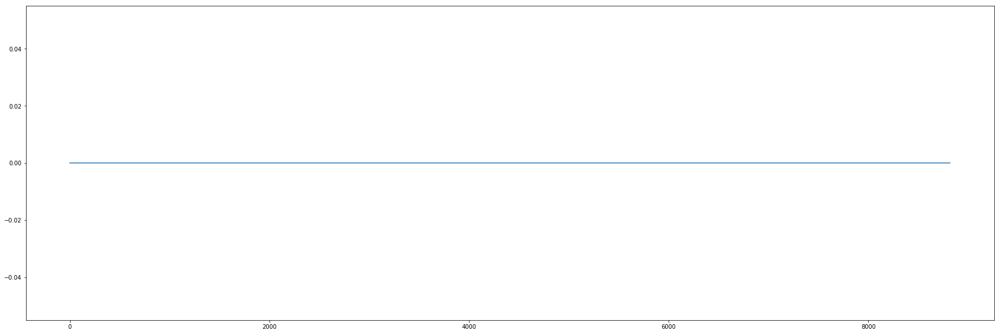

In [2245]:
plt.figure(figsize=(30,10))
plt.plot(conv)

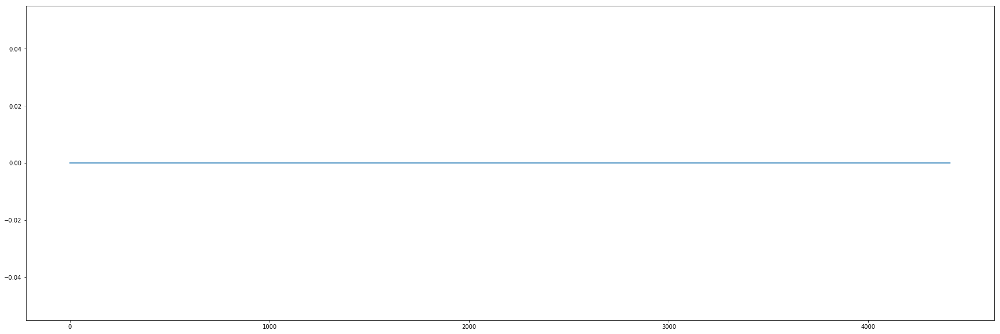

In [2246]:
plt.figure(figsize=(30,10))
plt.plot(sweep)

In [2012]:
conv

array([ 0.21669734, -0.15219252, -0.14529654, ...,  0.00166726,
       -0.00368703, -0.00484457])

In [854]:
sweep_sample = int((sweep_timestamps[20] - audio_start).total_seconds()*samplerate)

In [688]:
audio_name

'20200914_131233_362'

In [689]:
sweep_timestamps

['20200914_12:56:24.452',
 '20200914_12:56:24.970',
 '20200914_12:56:25.480',
 '20200914_12:56:25.996',
 '20200914_12:56:26.508',
 '20200914_12:56:27.028',
 '20200914_12:56:27.544',
 '20200914_12:56:28.062',
 '20200914_12:56:28.579',
 '20200914_12:56:29.096',
 '20200914_12:56:29.613',
 '20200914_12:56:30.133',
 '20200914_12:56:30.652',
 '20200914_12:56:31.169',
 '20200914_12:56:31.687',
 '20200914_12:56:32.197',
 '20200914_12:56:32.713',
 '20200914_12:56:33.237',
 '20200914_12:56:33.746',
 '20200914_12:56:34.261',
 '20200914_12:56:34.773',
 '20200914_12:56:35.286',
 '20200914_12:56:35.805',
 '20200914_12:56:36.319',
 '20200914_12:56:36.834',
 '20200914_12:56:37.353',
 '20200914_12:56:37.869',
 '20200914_12:56:38.387',
 '20200914_12:56:38.904',
 '20200914_12:56:39.415',
 '20200914_12:56:39.968',
 '20200914_12:56:40.498',
 '20200914_12:56:41.059',
 '20200914_12:56:41.605',
 '20200914_12:56:42.126',
 '20200914_12:56:42.668',
 '20200914_12:56:43.189',
 '20200914_12:56:43.710',
 '20200914_1

In [405]:
audio_file

'20200910_130108_211.wav'

In [406]:
audio_endtime = datetime.datetime.strptime(audio_name, '%Y%m%d_%H%M%S_%f')

In [407]:
audio_endtime

datetime.datetime(2020, 9, 10, 13, 1, 8, 211000)

In [408]:
sweep_timestamps = [datetime.datetime.strptime(stmp, '%Y%m%d_%H:%M:%S.%f') for stmp in sweep_timestamps]

TypeError: strptime() argument 1 must be str, not datetime.datetime

In [409]:
sweep_timestamps

[datetime.datetime(2020, 9, 10, 13, 1, 10, 738000),
 datetime.datetime(2020, 9, 10, 13, 1, 11, 258000),
 datetime.datetime(2020, 9, 10, 13, 1, 11, 775000),
 datetime.datetime(2020, 9, 10, 13, 1, 12, 294000),
 datetime.datetime(2020, 9, 10, 13, 1, 12, 814000),
 datetime.datetime(2020, 9, 10, 13, 1, 13, 333000),
 datetime.datetime(2020, 9, 10, 13, 1, 13, 852000),
 datetime.datetime(2020, 9, 10, 13, 1, 14, 373000),
 datetime.datetime(2020, 9, 10, 13, 1, 14, 892000),
 datetime.datetime(2020, 9, 10, 13, 1, 15, 412000),
 datetime.datetime(2020, 9, 10, 13, 1, 15, 941000),
 datetime.datetime(2020, 9, 10, 13, 1, 16, 463000),
 datetime.datetime(2020, 9, 10, 13, 1, 16, 981000),
 datetime.datetime(2020, 9, 10, 13, 1, 17, 500000),
 datetime.datetime(2020, 9, 10, 13, 1, 18, 18000),
 datetime.datetime(2020, 9, 10, 13, 1, 18, 536000),
 datetime.datetime(2020, 9, 10, 13, 1, 19, 51000),
 datetime.datetime(2020, 9, 10, 13, 1, 19, 570000),
 datetime.datetime(2020, 9, 10, 13, 1, 20, 87000),
 datetime.datet

In [410]:
sweep_timestamps[0] - audio_endtime

datetime.timedelta(0, 2, 527000)

In [411]:
(audio_endtime - sweep_timestamps[1]).total_seconds()*samplerate

-134372.7

In [212]:
len(norm_data)

1323000

In [232]:
len(generated_sweep)

4410

In [922]:
norm_data = normalize_data(data_left)

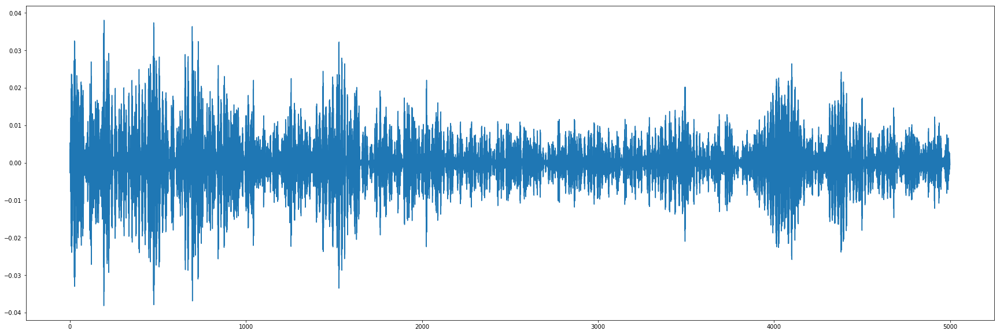

In [1686]:
plt.figure(figsize=(30,10))
plt.plot(norm_data[1105675:1105675+5000])

In [236]:
import scipy
conv = convolution(norm_data[1105675:1105675+5000],generated_sweep)

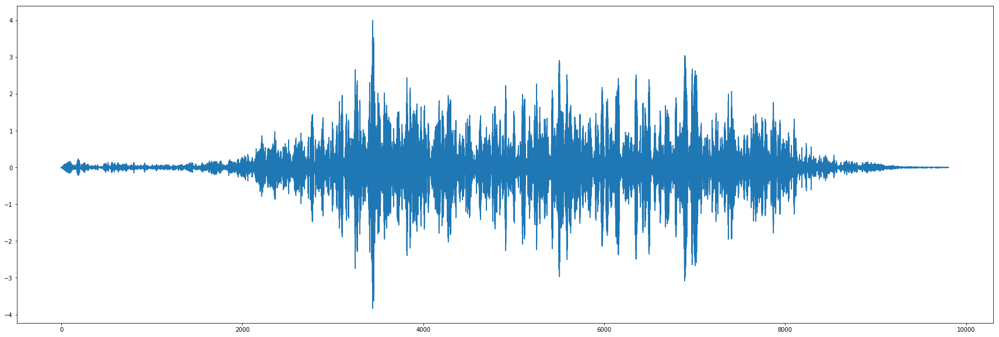

In [2450]:
plt.figure(figsize=(30,10))
plt.plot(conv)

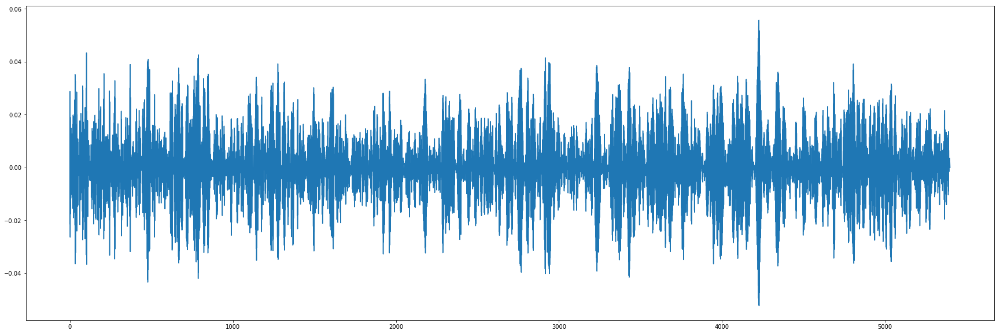

In [2451]:
plt.figure(figsize=(30,10))
plt.plot(sweep)

In [239]:
len(conv)

9409

In [249]:
from scipy.signal import hilbert
analytic_signal = hilbert(conv[4410:])
amplitude_envelope = np.abs(analytic_signal)

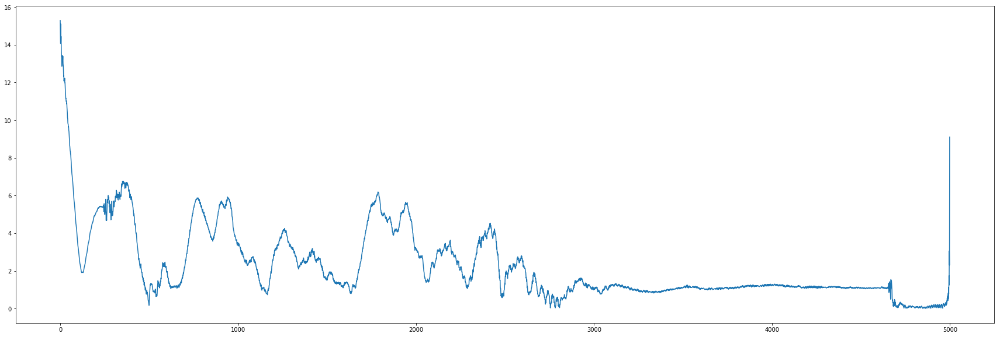

In [250]:
plt.figure(figsize=(30,10))
plt.plot(amplitude_envelope)

In [856]:
sweep_sample

567390

In [857]:
sweep_timestamps

[datetime.datetime(2020, 9, 14, 17, 54, 51, 900000),
 datetime.datetime(2020, 9, 14, 17, 54, 52, 426000),
 datetime.datetime(2020, 9, 14, 17, 54, 52, 943000),
 datetime.datetime(2020, 9, 14, 17, 54, 53, 463000),
 datetime.datetime(2020, 9, 14, 17, 54, 53, 983000),
 datetime.datetime(2020, 9, 14, 17, 54, 54, 505000),
 datetime.datetime(2020, 9, 14, 17, 54, 55, 24000),
 datetime.datetime(2020, 9, 14, 17, 54, 55, 535000),
 datetime.datetime(2020, 9, 14, 17, 54, 56, 47000),
 datetime.datetime(2020, 9, 14, 17, 54, 56, 564000),
 datetime.datetime(2020, 9, 14, 17, 54, 57, 83000),
 datetime.datetime(2020, 9, 14, 17, 54, 57, 603000),
 datetime.datetime(2020, 9, 14, 17, 54, 58, 121000),
 datetime.datetime(2020, 9, 14, 17, 54, 58, 637000),
 datetime.datetime(2020, 9, 14, 17, 54, 59, 155000),
 datetime.datetime(2020, 9, 14, 17, 54, 59, 673000),
 datetime.datetime(2020, 9, 14, 17, 55, 0, 185000),
 datetime.datetime(2020, 9, 14, 17, 55, 0, 701000),
 datetime.datetime(2020, 9, 14, 17, 55, 1, 218000),

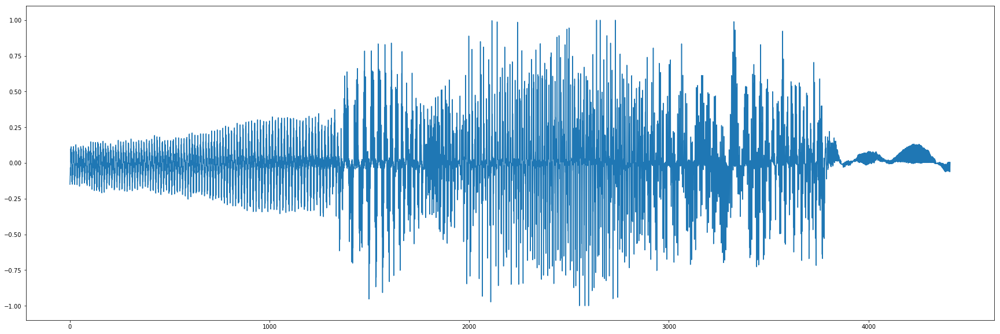

In [899]:
test_sweep = norm_data[sweep_sample - 11400:sweep_sample-6990]
#test_sweep = filter_signal(test_sweep)
plt.figure(figsize=(30,10))
plt.plot(test_sweep)

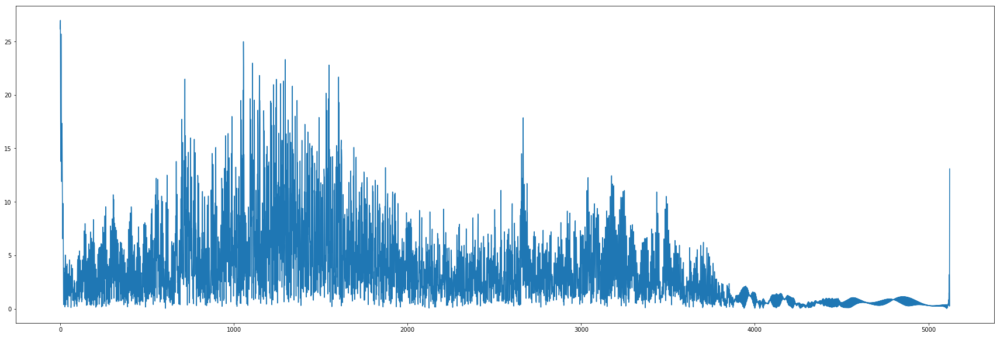

In [909]:
conv = convolution(test_sweep,generated_sweep)
plt.figure(figsize=(30,10))
plt.plot(corr[1])

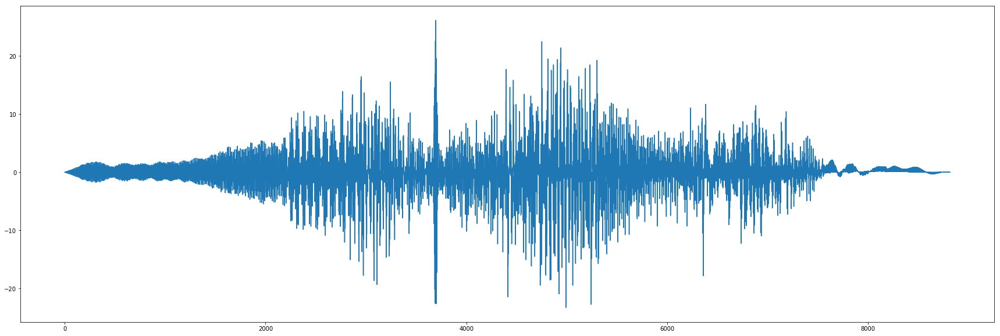

In [902]:
plt.figure(figsize=(30,10))
plt.plot(np.correlate(test_sweep,test_sweep[::-1],'full'))

In [903]:
cut = conv[conv.argmax():]

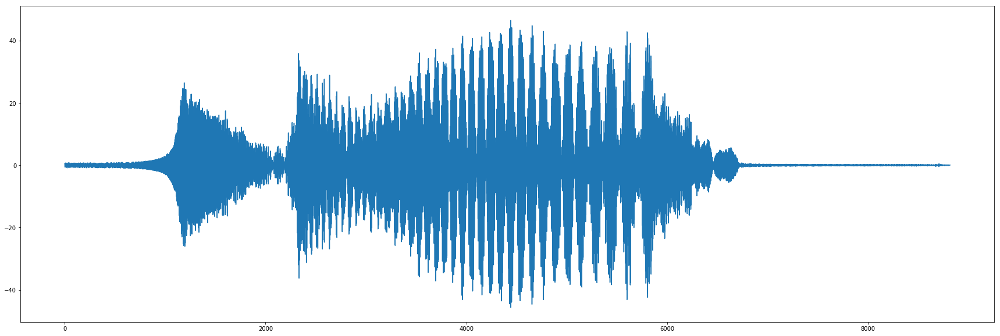

In [1960]:
plt.figure(figsize=(30,10))
plt.plot(conv)

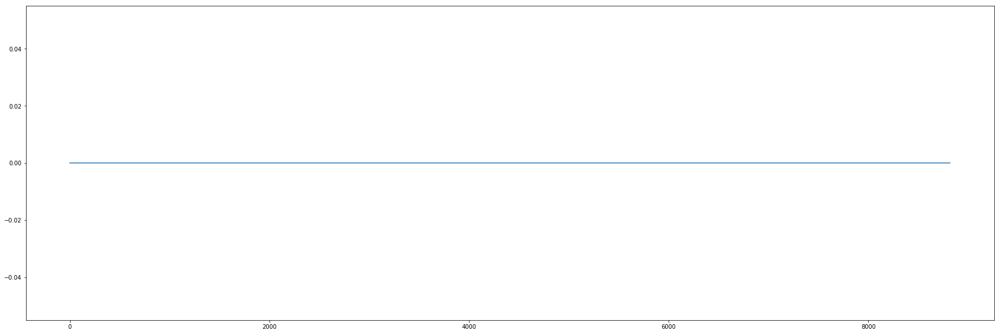

In [2248]:
plt.figure(figsize=(30,10))
plt.plot(conv)

In [1583]:
len(conv)

8819

In [1546]:
out = getEnvelope(conv[4410:])

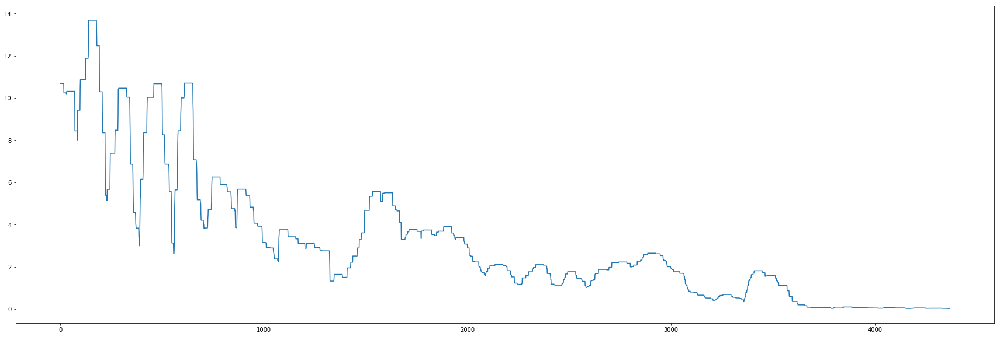

In [1547]:
plt.figure(figsize=(30,10))
plt.plot(out)

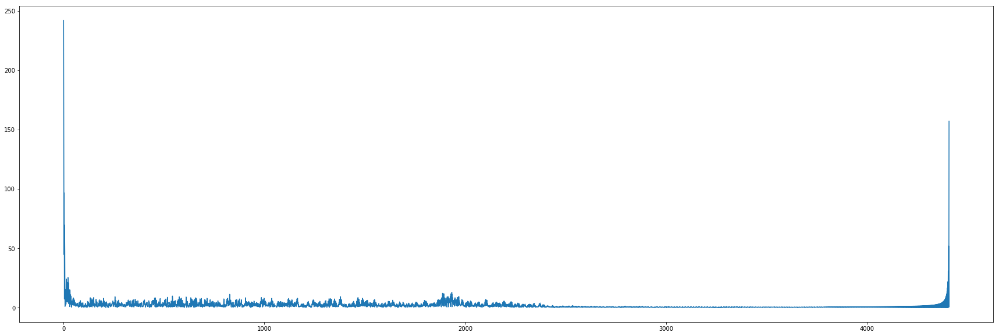

In [1538]:
from scipy.signal import hilbert
analytic_signal = hilbert(cut)
amplitude_envelope = np.abs(analytic_signal)
plt.figure(figsize=(30,10))
plt.plot(amplitude_envelope)

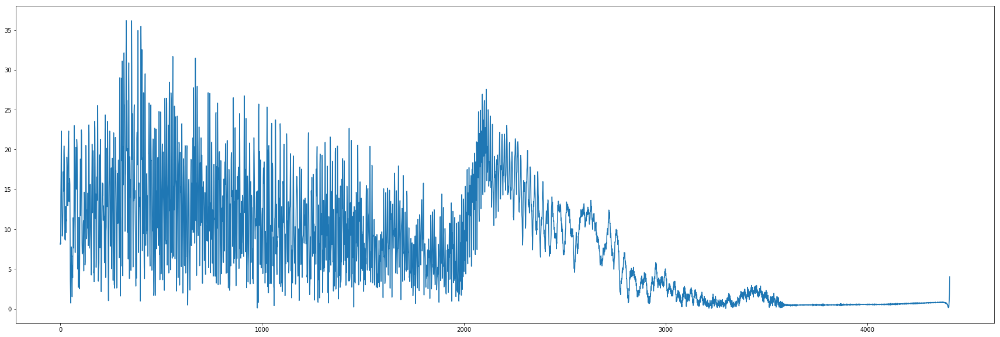

In [853]:
from scipy.signal import hilbert
analytic_signal = hilbert(conv[4410:])
amplitude_envelope = np.abs(analytic_signal)
plt.figure(figsize=(30,10))
plt.plot(amplitude_envelope)

In [431]:
test  = clear_sweep_timestamps(sweep_timestamps)

2020-09-10 13:01:10.738000
2020-09-10 13:01:11.258000
2020-09-10 13:01:11.775000
2020-09-10 13:01:12.294000
2020-09-10 13:01:12.814000
2020-09-10 13:01:13.333000
2020-09-10 13:01:13.852000
2020-09-10 13:01:14.373000
2020-09-10 13:01:14.892000
2020-09-10 13:01:15.412000
2020-09-10 13:01:15.941000
2020-09-10 13:01:16.463000
2020-09-10 13:01:16.981000
2020-09-10 13:01:17.500000
2020-09-10 13:01:18.018000
2020-09-10 13:01:18.536000
2020-09-10 13:01:19.051000
2020-09-10 13:01:19.570000
2020-09-10 13:01:20.087000
2020-09-10 13:01:20.605000
2020-09-10 13:01:21.123000
2020-09-10 13:01:21.642000
2020-09-10 13:01:22.162000
2020-09-10 13:01:22.681000
2020-09-10 13:01:23.202000
2020-09-10 13:01:23.723000
2020-09-10 13:01:24.242000
2020-09-10 13:01:24.770000
2020-09-10 13:01:25.289000
2020-09-10 13:01:25.807000
2020-09-10 13:01:26.328000
2020-09-10 13:01:26.845000
2020-09-10 13:01:27.363000
2020-09-10 13:01:27.883000
2020-09-10 13:01:28.404000
2020-09-10 13:01:28.923000
2020-09-10 13:01:29.441000
2

In [432]:
test

[]

In [433]:
audio_endtime

datetime.datetime(2020, 9, 10, 13, 1, 8, 211000)

In [628]:
for i in range(len(sweep_timestamps)-1):
    print(sweep_timestamps[i+1] - sweep_timestamps[i])

0:00:00.520000
0:00:00.517000
0:00:00.519000
0:00:00.520000
0:00:00.519000
0:00:00.519000
0:00:00.521000
0:00:00.519000
0:00:00.520000
0:00:00.529000
0:00:00.522000
0:00:00.518000
0:00:00.519000
0:00:00.518000
0:00:00.518000
0:00:00.515000
0:00:00.519000
0:00:00.517000
0:00:00.518000
0:00:00.518000
0:00:00.519000
0:00:00.520000
0:00:00.519000
0:00:00.521000
0:00:00.521000
0:00:00.519000
0:00:00.528000
0:00:00.519000
0:00:00.518000
0:00:00.521000
0:00:00.517000
0:00:00.518000
0:00:00.520000
0:00:00.521000
0:00:00.519000
0:00:00.518000
0:00:00.519000
0:00:00.519000
0:00:00.518000
0:00:00.518000
0:00:00.519000
0:00:00.519000
0:00:00.520000
0:00:00.520000
0:00:00.520000
0:00:00.520000
0:00:00.519000
0:00:00.522000
0:00:00.519000


In [57]:
sweep_timestamps

[datetime.datetime(2020, 10, 7, 14, 6, 57, 137000),
 datetime.datetime(2020, 10, 7, 14, 6, 57, 685000),
 datetime.datetime(2020, 10, 7, 14, 6, 58, 216000),
 datetime.datetime(2020, 10, 7, 14, 6, 58, 750000),
 datetime.datetime(2020, 10, 7, 14, 6, 59, 285000),
 datetime.datetime(2020, 10, 7, 14, 6, 59, 827000),
 datetime.datetime(2020, 10, 7, 14, 7, 0, 365000),
 datetime.datetime(2020, 10, 7, 14, 7, 0, 892000),
 datetime.datetime(2020, 10, 7, 14, 7, 1, 436000),
 datetime.datetime(2020, 10, 7, 14, 7, 1, 969000),
 datetime.datetime(2020, 10, 7, 14, 7, 2, 489000),
 datetime.datetime(2020, 10, 7, 14, 7, 3, 22000),
 datetime.datetime(2020, 10, 7, 14, 7, 3, 551000),
 datetime.datetime(2020, 10, 7, 14, 7, 4, 84000),
 datetime.datetime(2020, 10, 7, 14, 7, 4, 621000),
 datetime.datetime(2020, 10, 7, 14, 7, 5, 147000),
 datetime.datetime(2020, 10, 7, 14, 7, 5, 675000),
 datetime.datetime(2020, 10, 7, 14, 7, 6, 206000),
 datetime.datetime(2020, 10, 7, 14, 7, 6, 726000),
 datetime.datetime(2020, 10

In [58]:
f, Pxx_den = signal.welch(generated_sweep, samplerate, nperseg=1024)

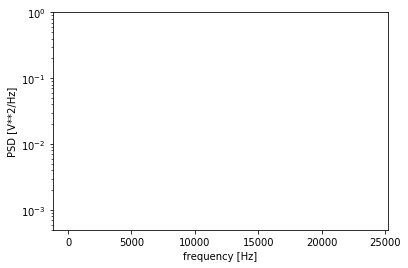

In [59]:
plt.semilogy(f, Pxx_den)
plt.ylim([0.5e-3, 1])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.show()

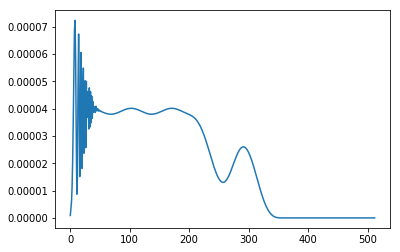

In [60]:
plt.plot(Pxx_den)

In [61]:
from scipy import signal
sig = np.repeat([0., 1., 1., 0., 1., 0., 0., 1.], 128)
sig_noise = sig + np.random.randn(len(sig))
corr = signal.correlate(sig_noise, np.ones(128), mode='same') / 128

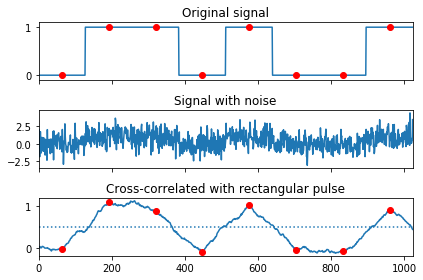

In [62]:
import matplotlib.pyplot as plt
clock = np.arange(64, len(sig), 128)
fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True)
ax_orig.plot(sig)
ax_orig.plot(clock, sig[clock], 'ro')
ax_orig.set_title('Original signal')
ax_noise.plot(sig_noise)
ax_noise.set_title('Signal with noise')
ax_corr.plot(corr)
ax_corr.plot(clock, corr[clock], 'ro')
ax_corr.axhline(0.5, ls=':')
ax_corr.set_title('Cross-correlated with rectangular pulse')
ax_orig.margins(0, 0.1)
fig.tight_layout()
fig.show()

In [63]:
np.ones(128)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1.])

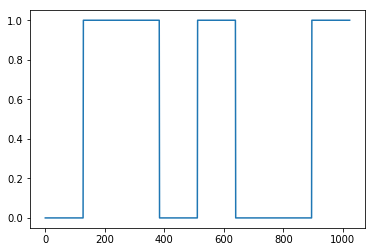

In [68]:
plt.plot(np.repeat([0., 1., 1., 0., 1., 0., 0., 1.], 128))

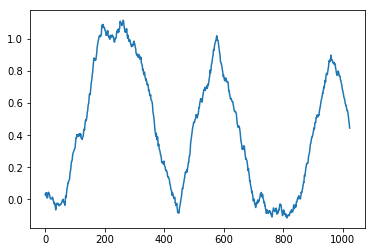

In [69]:
plt.plot(signal.correlate(sig_noise, np.ones(128), mode='same') / 128)

In [54]:
# A template is given
temp = randn(100,1)

# Create a matched filter based on the template
b = flipud(temp[:])

# For testing the matched filter, create a random signal which
# contains a match for the template at some time index
x = [randn(200,1), temp[:], randn(300,1)]
n = [1:length(x)]


SyntaxError: invalid syntax (<ipython-input-54-7e7411905465>, line 10)

In [217]:
pd.DataFrame(nc)

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.890284,1.0,0.876715,0.842958,0.888112,0.877377,0.854888,0.866389,0.841701,0.801058,...,0.014887,0.014882,0.015152,0.015145,0.015035,0.015068,0.014715,0.014151,0.014039,0.013869
1,0.888177,1.0,0.882210,0.852302,0.899727,0.893693,0.876177,0.890463,0.868742,0.831929,...,0.010706,0.010727,0.010805,0.010638,0.010622,0.010716,0.010301,0.009779,0.009767,0.009661
2,0.882628,1.0,0.883044,0.853771,0.909077,0.905278,0.884123,0.901840,0.889602,0.857434,...,0.006196,0.006361,0.006151,0.005854,0.006088,0.006362,0.006097,0.005903,0.006178,0.006314
3,0.889092,1.0,0.880526,0.846775,0.894534,0.892203,0.873739,0.886517,0.868892,0.836207,...,0.006963,0.007455,0.007833,0.008075,0.008635,0.009284,0.009398,0.009436,0.009994,0.010458
4,0.889614,1.0,0.885541,0.853590,0.897298,0.897467,0.885780,0.898981,0.878138,0.846180,...,0.010595,0.010499,0.010472,0.010225,0.010115,0.010087,0.009541,0.008890,0.008749,0.008511
5,0.889865,1.0,0.881772,0.846046,0.891227,0.891279,0.874118,0.884273,0.865197,0.832934,...,0.012653,0.012521,0.012183,0.011984,0.011568,0.010966,0.010757,0.010579,0.009804,0.009040
6,0.885468,1.0,0.877904,0.840487,0.891951,0.887522,0.859078,0.867874,0.852872,0.817136,...,0.010755,0.010636,0.011033,0.011311,0.011063,0.010946,0.010999,0.010783,0.010602,0.010589
7,0.880812,1.0,0.883930,0.850685,0.908161,0.909828,0.884936,0.898157,0.890751,0.861291,...,0.012153,0.011791,0.010900,0.009921,0.009470,0.008928,0.007876,0.006963,0.006295,0.005404
8,0.885306,1.0,0.881674,0.847497,0.899332,0.897904,0.874401,0.885127,0.870163,0.836363,...,0.007536,0.007815,0.007480,0.007146,0.007247,0.007115,0.006764,0.006651,0.006280,0.005727
9,0.879035,1.0,0.883742,0.850424,0.907881,0.906288,0.878195,0.890393,0.881096,0.847914,...,0.008920,0.008787,0.009105,0.009282,0.009193,0.009310,0.009459,0.009401,0.009518,0.009802


In [475]:
import numpy as np
import librosa

OSError: sndfile library not found

In [155]:
session_list

[[datetime.datetime(2021, 3, 2, 18, 23, 30, 772000),
  datetime.datetime(2021, 3, 2, 18, 24, 4, 601000)],
 [datetime.datetime(2021, 3, 2, 18, 24, 11, 484000),
  datetime.datetime(2021, 3, 2, 18, 24, 43, 738000)],
 [datetime.datetime(2021, 3, 2, 18, 24, 49, 526000),
  datetime.datetime(2021, 3, 2, 18, 25, 20, 850000)],
 [datetime.datetime(2021, 3, 2, 18, 32, 33, 332000),
  datetime.datetime(2021, 3, 2, 18, 33, 5, 962000)],
 [datetime.datetime(2021, 3, 2, 18, 33, 12, 699000),
  datetime.datetime(2021, 3, 2, 18, 33, 44, 740000)],
 [datetime.datetime(2021, 3, 2, 18, 33, 51, 921000),
  datetime.datetime(2021, 3, 2, 18, 34, 24, 773000)],
 [datetime.datetime(2021, 3, 2, 18, 36, 32, 772000),
  datetime.datetime(2021, 3, 2, 18, 37, 4, 393000)],
 [datetime.datetime(2021, 3, 2, 18, 37, 21, 275000),
  datetime.datetime(2021, 3, 2, 18, 37, 52, 954000)],
 [datetime.datetime(2021, 3, 2, 18, 37, 59, 677000),
  datetime.datetime(2021, 3, 2, 18, 38, 31, 361000)]]